# Configuration for exporting

In [ ]:
%pip install ipywidgets
%pip install statmodels
%pip install xgboost
%pip install prophet


In [1]:
from IPython.display import display, HTML

# Inject custom CSS directly
display(HTML("""
<style>
/* Custom CSS styles */
.container {
    width: 100%;
    max-width: 600px;
}
</style>
"""))


!jupyter nbconvert --to html \
    --TagRemovePreprocessor.remove_input_tags='{"plot"}' \
    --TagRemovePreprocessor.remove_cell_tags='{"configuration"}' \
    --TagRemovePreprocessor.remove_cell_tags='{"neuralnets"}' \
    --TagRemovePreprocessor.remove_cell_tags='{"include_or_not?"}' \
    orders-prediction-sinus.ipynb

[NbConvertApp] Converting notebook orders-prediction-sinus.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 51 image(s).
[NbConvertApp] Writing 18217529 bytes to orders-prediction-sinus.html


In [2]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

![Rohlik_logo](Rohlik_logo.png)

# Overview <a name="overview"></a>
<a href="https://www.rohlik.group">Rohlik Group</a>, a leading European e-grocery innovator, is revolutionising and accelerating the food retail industry.<br>
The company's unique customer experience is a combination of fast and precise delivery, large assortment and great value for money.<br>
Orders are delivered within 60 minutes or within 15-minute same-day time windows, with over 17,000 items to choose from and prices in line with *brick-and-mortar* competition.<br>
This company operate across 11 warehouses in Czech Republic, Germany, Austria, Hungary, and Romania (while in this project we will analyze 7 of them).

In order to improve products availbility while also keeping the freshness, Rohlik needs to assess the number of future orders.<br>
Accurate order forecasts are crucial for planning process, impacting workforce allocation, delivery logistics, inventory management, and supply chain efficiency. By optimizing forecasts, we can minimize waste and streamline operations, making our e-grocery services more sustainable and efficient.

As a Data Scientist, my job is to build a model to predict the orders for the next 60 days for each warehouse.<br>
In addition, the process will help us to understand better the nature of activity of the customers, which could help us to find insights about how to improve Rohlik.

Lets check the Data - as we can see, in the calender data, we got more dates previus the orders data from the train, and future dates from the test.

# Workflow <a name="workflow"></a>
## Steps of the project <a name="project-steps"></a>
>1. **EDA**: <br>Getting familier with the data, cleaning it, adding features and applying needed manipulations.
>2. **Predicting diffrent time components**: <br>Decomposing data into trend, seasonal and reseadual values.
>3. **Connecting the parts**:<br>Combinig the diffrent models into a single model.
>4. **Find insights**

## Data Decomposing
A time series data can be describe as:
### $$y_t = T_t + S_t + R_t$$
where:
- $t$: Time stamp index
- $y_t$: The actual values.
- $T_t$: The trend-cycle component, which can be assessed by the moving average.
- $S_t$: Seasonal patterns in a repeating time parts, like weekly or monthly pattern.
- $R_t$: The remainder componet. This component could be duo to a real factors like holidays, but also due to the level of randomness of data.

I found that in many warehouses the STD changes between seasons, so in my own variation of the classic decomposing I will take the moving STD into account:
$$y_t = T_t + STD_{\substack{moving \\ window}}(S_t + R_t)$$

## Acknowledgements & Notes  
The provided data comes from "irregular" years influenced by significant global events. These include:  
- **COVID-19 Pandemic**: Starting around March 2020 and lasting one to two years, it disrupted normal patterns in consumer behavior and logistics.  
- **War in Ukraine**: With Ukraine sharing borders or proximity to several countries where Rohlik operates, the conflict likely impacted regional economies and supply chains.  
- **Recent Trump Administration**: Policies proposed during this period, such as reforms in the export and import of goods and opinions on NATO, may have affected the global economy. For instance, these reforms could influence how Eastern European countries allocate their budgets, potentially increasing military spending.  

# Imports

In [423]:
# General
import numpy as np
import pandas as pd
import os
import datetime as dt

# Ploting
import matplotlib.pyplot as plt
from matplotlib.patches import FancyBboxPatch, FancyArrowPatch
%matplotlib inline
import seaborn as sns
import plotly
import plotly.io as pio
pio.renderers.default = 'iframe' # Fixed invisible figures in notebook
pio.renderers.default += '+notebook_connected' + '+jupyterlab'
import plotly.express as px
import plotly.graph_objects as go
import plotly.subplots as sp
from ipywidgets import interact, IntSlider, FloatSlider, Dropdown
from IPython.display import display

# Statistics
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.stattools import adfuller
from sklearn.preprocessing import RobustScaler
from scipy.stats import kurtosis, skew, norm, boxcox, linregress, norm, beta, gamma
from sklearn.preprocessing import MinMaxScaler

# ML
import xgboost as xgb
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, mean_absolute_error

# DL
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

# Typing
from typing import List, Tuple, Dict, Any

In [425]:
FIGURE_HEIGHT = 800
FIGURE_WIDTH = 1100

### Interactive plots
The data of this project is diverse, with diffrent warehouses where we want to be able to understand it in the macro (general trend) and in the micro (in week pattern for exmaple). Therefore most of the plots in this project are interactive so you (the reader) could dive into the plots and see for yourself the diffrent ways this data works. <br>
Before we continue into the project, here are some great features of the interactive plots you should get familier with:

<br>

>#### **❓ Hover over point in the graph and see its value and date, if there is a holiday so also the holiday name:**<br>
![Alt Text](show_holiday_name.gif)
<br>

>#### **❓ Cut portion of plot for deeper look:**<br>
![Alt Text](cut_plot.gif)
<br>

>#### **❓ Choose warehouse from drop down menu (available for some plots):**<br>
![Alt Text](project_images/choose_warehouse.gif)
<br>

>#### **❓ Double click on the plot in order to reset plot**

# EDA

## The data
In order to improve, Rohlik created a <a href="https://www.kaggle.com/competitions/rohlik-orders-forecasting-challenge">Kaggle competition</a> in order to find the best model for their objective, where they provided their own internal data.<br>
Rohlik provided for each of the 7 warehouses (5 from the Czech Republic and 2 from Germany) the count of orders by date, and more info that might affect the orders.

#### The **train & test** data contains the following columns:

>- `warehouse` - warehouse name
>- `date` - date
>- `orders` - number of customer orders attributed to the warehouse
>- `holiday_name` - name of public holiday if any
>- `holiday` - 0/1 indicating the presence of holidays
>- `shops_closed` - public holiday with most of the shops or large part of shops closed
>- `winter_school_holidays` - school holidays
>- `school_holidays` - school holidays
>- `id` - row id consisting of warehouse name and date


#### The **train** data also contains the following columns which are not provided in test:
>- `shutdown` - warehouse shutdown or limitation due to operations.
>- `mini_shutdown` - warehouse shutdown or limitation due to operations.
>    - As the host of the competition explained for a question in the discussion: Shutdowns are pretty much the same but mini shutdown means that only a part if warehouse was affected or just for few hours. Shutdown is more severe.
>- `frankfurt_shutdown` - warehouse shutdown or limitation due to operations.
>- `blackout` - warehouse shutdown or limitation due to operations.
>- `mov_change` - a change in minimum order value indicating potential change in customer behaviour.
>    - As the host of the competition explained for a question in the discussion:
>        - 0 means that there was no change.
>        - 0.7 means there was a small minimum order value change.
>        - 1 means there was a larger change.
>- `precipitation` - precipitation in mm around the location of the warehouse which correlates with location of the customers.
>- `snow` - snowfall in mm around the location of the warehouse which correlates with location of the customers.
>- `user_activity_1` - user activity on the website.
>- `user_activity_2` - user activity on the website.
>    - As the host of the competition explained for a question in the discussion: they can’t disclose exactly what these mean and how user_activity_1 differ from user_activity_2, but they are different way of measuring user activity on the platform but they will be correlated.

#### Data form
>The actual tables given by Rohlik for the Kaggle competition are train, train_calendar, test, test_calendar.<br>
>The additional calender contains holidays and similar data the one in the regular table, but for more dates. It good to use it as we are dealing with missing days within data dates range, and while adding new future days. This is the reason for why the calender tables have more rows than the orders data tables.<br>
Also, a solution eample table is given for the copetition in Kaggle, which is irelevant to the scope of this project.

In [430]:
FILES = {}

for dirname, _, filenames in os.walk('./kaggle/input'):
    for filename in filenames:
        key        = filename.split('.')[0]
        FILES[key] = os.path.join(dirname, filename)

### Tables columns

In [433]:
for k in FILES:
    temp = pd.read_csv(FILES[k])
    print(k, 'table length: '+str(temp.shape[0]), 'columns: '+str(temp.columns), sep='\n', end='\n'+('_'*20)+'\n\n')

solution_example
table length: 397
columns: Index(['id', 'orders'], dtype='object')
____________________

test
table length: 397
columns: Index(['warehouse', 'date', 'holiday_name', 'holiday', 'shops_closed',
       'winter_school_holidays', 'school_holidays', 'id'],
      dtype='object')
____________________

train_calendar
table length: 13307
columns: Index(['date', 'holiday_name', 'holiday', 'shutdown', 'mini_shutdown',
       'warehouse_limited', 'shops_closed', 'winter_school_holidays',
       'school_holidays', 'blackout', 'mov_change', 'frankfurt_shutdown',
       'precipitation', 'snow', 'warehouse'],
      dtype='object')
____________________

train
table length: 7340
columns: Index(['warehouse', 'date', 'orders', 'holiday_name', 'holiday', 'shutdown',
       'mini_shutdown', 'shops_closed', 'winter_school_holidays',
       'school_holidays', 'blackout', 'mov_change', 'frankfurt_shutdown',
       'precipitation', 'snow', 'user_activity_1', 'user_activity_2', 'id'],
      dtype

### Warehouses date range in diffrent tables

In [436]:
df_train_calendar = pd.read_csv(FILES['train_calendar'])
df_train = pd.read_csv(FILES['train'])

df_train_calendar['date'] = pd.to_datetime(df_train_calendar['date'])
df_train['date'] = pd.to_datetime(df_train['date'])

df_test_calendar = pd.read_csv(FILES['test_calendar'])
df_test = pd.read_csv(FILES['test'])

df_test_calendar['date'] = pd.to_datetime(df_test_calendar['date'])
df_test['date'] = pd.to_datetime(df_test['date'])

for warehouse in df_train.warehouse.unique():
    print(warehouse)
    
    print('\nTrain')
    df2 = df_train[df_train.warehouse == warehouse].copy()
    temp2 = df_train_calendar[df_train_calendar.warehouse == warehouse].copy()
    print(df2.date.min(), df2.date.max())
    print(temp2.date.min(), temp2.date.max())
    
    print('\nTest')
    df2 = df_test[df_test.warehouse == warehouse].copy()
    temp2 = df_test_calendar[df_test_calendar.warehouse == warehouse].copy()
    print(df2.date.min(), df2.date.max())
    print(temp2.date.min(), temp2.date.max())
    print('\n'+('_'*20)+'\n\n')

Prague_1

Train
2020-12-05 00:00:00 2024-03-15 00:00:00
2019-01-01 00:00:00 2024-03-15 00:00:00

Test
2024-03-16 00:00:00 2024-05-15 00:00:00
2024-03-16 00:00:00 2024-12-07 00:00:00

____________________


Brno_1

Train
2020-12-05 00:00:00 2024-03-15 00:00:00
2019-01-01 00:00:00 2024-03-15 00:00:00

Test
2024-03-16 00:00:00 2024-05-15 00:00:00
2024-03-16 00:00:00 2024-12-07 00:00:00

____________________


Prague_2

Train
2020-12-05 00:00:00 2024-03-15 00:00:00
2019-01-01 00:00:00 2024-03-15 00:00:00

Test
2024-03-16 00:00:00 2024-05-15 00:00:00
2024-03-16 00:00:00 2024-12-07 00:00:00

____________________


Prague_3

Train
2020-12-05 00:00:00 2024-03-15 00:00:00
2019-01-01 00:00:00 2024-03-15 00:00:00

Test
2024-03-16 00:00:00 2024-05-15 00:00:00
2024-03-16 00:00:00 2024-12-07 00:00:00

____________________


Munich_1

Train
2021-07-21 00:00:00 2024-03-15 00:00:00
2019-01-01 00:00:00 2024-03-15 00:00:00

Test
2024-03-16 00:00:00 2024-05-15 00:00:00
2024-03-16 00:00:00 2024-12-07 00:00

### Read the actual table data

In [439]:
df = pd.read_csv(FILES['train'])
df['date'] = pd.to_datetime(df['date'])

## Visualization
Diffrent occations might affect the way that customer act.<br>
The following plot show what is meaningful for the orders.<br>
The visualiztion gives us the ability to get familier with the data as it is. Since any algorithm that we'll use to extract information makes some assumptions which are affected by our own decisions, like:
- which algorithm to choose?
- which hyperparameters?
- how to deal with missing parameters?
- should we normalize the data? how? by which distribution?
- does the data seems to have patterns?
- do we have a categorical data that add information?

## First Glance

> 👇 Interactive plots below.<br>
❓ In the upper plot we can see the actual data for each warehouse in the given date range.<br>
❓ In the lower plot we can see a histogram that show the distribution of the raw data, with the estimated Normal and Gamma distribution.

<table>
  <tr>
    <td>
      <h3>Main points</h3>
      <p style="font-size:18px">
          On the Czech warehouses there a steady increase of orders through the years,<br>
          while on the German warehouses there was an increase for few months until July 2022,<br>
          and then a steady mean for about a year until July 2023 and then an increase and a little
          decrease on Jan again. The general trend for the German cities isnt very clear.<br><br>
          On the Czech warehouses there a clear annual pattern of increase from summer to winter and decrease from winter to summer.<br>
          Since the data skewed with a right tail, it seems to distribute like Gamma distribution.<br><br>
          clearly, there is a weekly pattern for each warehouse with diffrent peaks on specific days, as you can see on the image on the right:
      </p>
    </td>
    <td>
      <img src="project_images/weekly_pattern_example.png" alt="weekly" width="900" />
    </td>
  </tr>
</table>


> ❗Cut portion of plot and look at monthly and weekly pattern, and switch between warehoueses in order to see their diffrences:

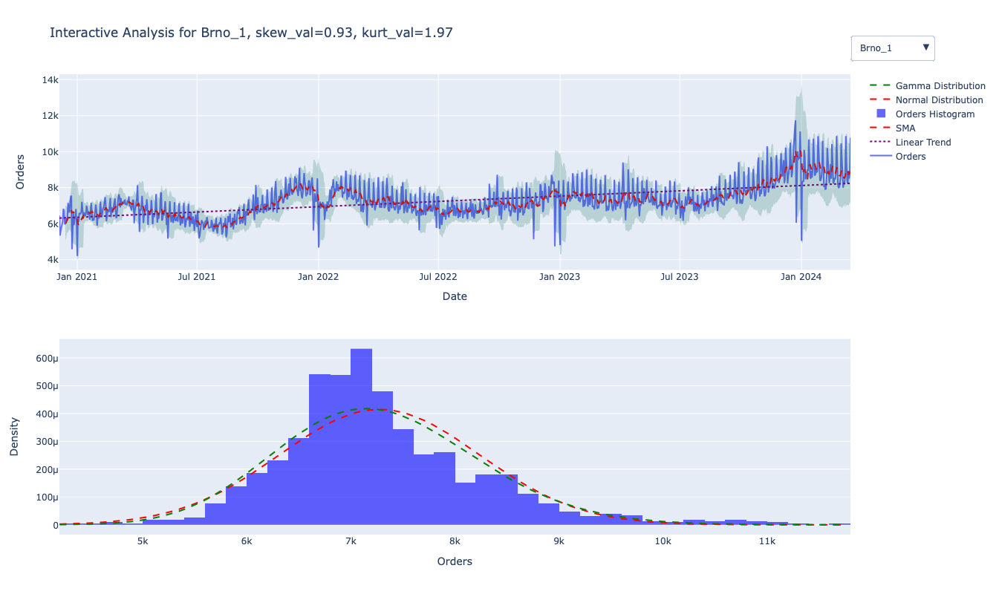

In [443]:
warehouses = df.warehouse.unique()
warehouses.sort()

def calculate_distribution_curves(data, x_values):
    """
    Calculate distribution curves for given data.
    
    Args:
        data (pd.Series): Input data series
        x_values (np.ndarray): X-axis values for plotting distributions
    
    Returns:
        dict: Calculated distribution curves
    """
    
    # Normal distribution
    mean = data.mean()
    std = data.std()
    normal_curve = norm.pdf(x_values, mean, std)
    
    # Beta distribution parameters estimation
    data_min, data_max = data.min(), data.max()
    
    try:
        # Normalize data to [0, 1] range for beta distribution
        normalized_data = (data - data_min) / (data_max - data_min)
        
        # Method of moments estimation
        mu = normalized_data.mean()
        sigma = normalized_data.std()
        
        # Estimate alpha and beta parameters
        alpha = mu * ((mu * (1 - mu) / (sigma ** 2)) - 1)
        beta_param = (1 - mu) * ((mu * (1 - mu) / (sigma ** 2)) - 1)
        
        # Ensure parameters are positive
        alpha = max(0.1, alpha)
        beta_param = max(0.1, beta_param)
        
        # Normalized x values
        normalized_x = (x_values - data_min) / (data_max - data_min)
        normalized_x = normalized_x[(normalized_x > 0) & (normalized_x < 1)]
        
        # Calculate beta PDF and scale to original data range
        beta_curve = beta.pdf(normalized_x, alpha, beta_param)
        
        # Scale the beta curve to match histogram density
        hist, _ = np.histogram(data, bins=x_values, density=True)
        peak_hist = np.max(hist)
        peak_beta = np.max(beta_curve)
        beta_curve = beta_curve * (peak_hist / peak_beta)
    
    except Exception:
        # Fallback to uniform distribution if estimation fails
        beta_curve = np.ones_like(x_values) * (1 / (data_max - data_min))
    
    # Gamma distribution parameters estimation
    try:
        k = (mean / std) ** 2  # shape parameter
        theta = std**2 / mean  # scale parameter
        gamma_curve = gamma.pdf(x_values, a=max(0.1, k), scale=theta)
    except Exception:
        # Fallback to exponential-like distribution if estimation fails
        gamma_curve = np.exp(-x_values / mean)
    
    return {
        'Normal': normal_curve,
        'Beta': beta_curve,
        'Gamma': gamma_curve
    }

def plot_original_data_and_hist(df: pd.DataFrame):
    warehouses = sorted(df.index.get_level_values('warehouse').unique())
    # Create dropdown menu buttons
    warehouse_dropdown = []

    # Create initial figure with all warehouses (but only first one visible initially)
    fig = sp.make_subplots(rows=2, cols=1, shared_xaxes=False)
    
    # Create traces for all warehouses
    for i, warehouse in enumerate(warehouses):
        # Filter data for the warehouse
        group = df.loc[warehouse].copy()
        
        # Calculate SMA and standard deviation
        sma_window = 10  # default value
        std_multiplier = 2  # default value
        
        group['SMA'] = group['orders'].rolling(window=sma_window).mean()
        group['STD'] = group['orders'].rolling(window=sma_window).std()
        group['Upper Margin'] = group['SMA'] + std_multiplier * group['STD']
        group['Lower Margin'] = group['SMA'] - std_multiplier * group['STD']
        
        # Prepare data for the histogram and normal distribution
        warehouse_data = group['orders']
        mean = warehouse_data.mean()
        std = warehouse_data.std()
        x_values = np.linspace(min(warehouse_data), max(warehouse_data), 100)
        normal_curve = norm.pdf(x_values, mean, std)
        
        skew_val = round(skew(group.orders), 2)
        kurt_val = round(kurtosis(group.orders), 2)
        
        # Add traces for this warehouse
        # Set visibility based on whether it's the first warehouse
        visible = (i == 0)
        traces = 0
        
        # Prepare data for linear regression
        dates = group.index.get_level_values('date')
        # Convert dates to numeric for regression
        date_nums = dates.astype(np.int64) // 10**9  # Convert to Unix timestamp
        
        # Perform linear regression
        slope, intercept, r_value, p_value, std_err = linregress(date_nums, group['orders'])
        
        # Create linear regression line
        line_x = dates
        line_y = slope * date_nums + intercept
        
        # Time-series traces
        fig.add_trace(go.Scatter(x=dates, 
                                y=group['orders'],
                                mode='lines', 
                                name="Orders",
                                visible=visible), row=1, col=1)
        traces += 1
        
        # Add linear regression line
        fig.add_trace(go.Scatter(x=line_x, 
                                y=line_y,
                                mode='lines', 
                                name="Linear Trend",
                                line=dict(color='purple', dash='dot'),
                                visible=visible), row=1, col=1)
        traces += 1
        
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['SMA'],
                                mode='lines', 
                                name="SMA", 
                                line=dict(color='red', dash='dash'),
                                visible=visible), row=1, col=1)
        traces += 1
        
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['Upper Margin'],
                                mode='lines', 
                                name="Upper Margin", 
                                line=dict(color='rgba(0,0,0,0)'),
                                showlegend=False,
                                visible=visible), row=1, col=1)
        traces += 1
        
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['Lower Margin'],
                                mode='lines', 
                                name="Lower Margin", 
                                fill='tonexty',
                                line=dict(color='rgba(0,0,0,0)'), 
                                fillcolor='rgba(0, 100, 80, 0.2)',
                                showlegend=False,
                                visible=visible), row=1, col=1)
        traces += 1
        
       # Histogram and normal distribution traces
        fig.add_trace(go.Histogram(x=warehouse_data, 
                                  name="Orders Histogram", 
                                  histnorm='probability density',
                                  marker_color='blue', 
                                  opacity=0.6,
                                  visible=visible), row=2, col=1)
        traces += 1
        
        fig.add_trace(go.Scatter(x=x_values, 
                                y=normal_curve, 
                                mode='lines', 
                                name="Normal Distribution",
                                line=dict(color='red', dash='dash'),
                                visible=visible), row=2, col=1)
        traces += 1
        
        # Calculate distribution curves
        distribution_curves = calculate_distribution_curves(warehouse_data, x_values)
        dist_name = 'Gamma'
        fig.add_trace(go.Scatter(x=x_values, 
                                    y=distribution_curves[dist_name], 
                                    mode='lines', 
                                    name=f"{dist_name} Distribution",
                                    line=dict(color='green', dash='dash'),
                                    visible=visible), row=2, col=1)
        
        traces += 1
        
        # Visibility toggle
        visibility = []
        for w in warehouses:
            visibility.extend([w == warehouse] * traces)
        
        title = f"Interactive Analysis for {warehouse}, {skew_val=}, {kurt_val=}"
        if visible:
            first_title = title
        
        
        warehouse_dropdown.append(
            dict(
                args=[{"visible": visibility},
                      {"title": f"Interactive Analysis for {warehouse}, {skew_val=}, {kurt_val=}",
                       "annotations[0].text": f"Orders Over Time for {warehouse} with SMA and Margins",
                       "annotations[1].text": f"Histogram and Distributions for {warehouse}"}],
                label=warehouse,
                method="update"
            )
        )
        
    
    # Update layout
    fig.update_layout(
        height=FIGURE_HEIGHT,
        width=FIGURE_WIDTH,
        title_text=first_title,
        xaxis=dict(title="Date"),
        yaxis=dict(title="Orders"),
        xaxis2=dict(title="Orders"),
        yaxis2=dict(title="Density"),
        updatemenus=[dict(
            buttons=warehouse_dropdown,
            direction="down",
            showactive=True,
            x=1,
            xanchor="left",
            y=1.1,
            yanchor="top",
            pad={"r": 10, "t": 10}
        )]
    )
        
    fig.show()
    
_ = plot_original_data_and_hist(df.set_index(['warehouse', 'date']))

### Weekly pattern

In [445]:
def add_features(df: pd.DataFrame):
    df['timestamp'] = df['date'].apply(lambda x: int(x.timestamp()))
    df['year'], df['month'], df['day'] = df.date.dt.year, df.date.dt.month, df.date.dt.day
    df['week_day'] = df.date.apply(lambda d: d.weekday()+1)
    df['year_week'] = df.date.apply(lambda d: int(d.strftime("%W")))
    df['year_day'] = df.date.apply(lambda d: int(d.dayofyear))

    df.sort_values(by='date', inplace=True)
    return df

df = add_features(df)

> 👇 Interactive plot below.<br>
❓ In the plot diffrent days values showen in diffrent colors<br>

<table>
  <tr>
    <td>
      <p style="font-size:18px">
          As we dive into the weekly pattern we discover that "day of the week" is a meaningful additional feature.<br>
          It seems that if we will draw a line between dots in the same color (which are the same day of the week), we will get almost a paralel lines that together define the trend.<br><br><br>
          Also, the German cities are a pecial case regard to Sunday, where Frankfurt got no single date of orders in Sunday and Munich got only 3 in a single month (July 23') and they all extreamly low (which suggests it was a special occusion).<br><br>
          ❗Switch to German cities in the following plot and check it out.
      </p>
    </td>
    <td>
      <img src="project_images/daily_scatter.png" alt="weekly" width="1400" />
    </td>
  </tr>
</table>

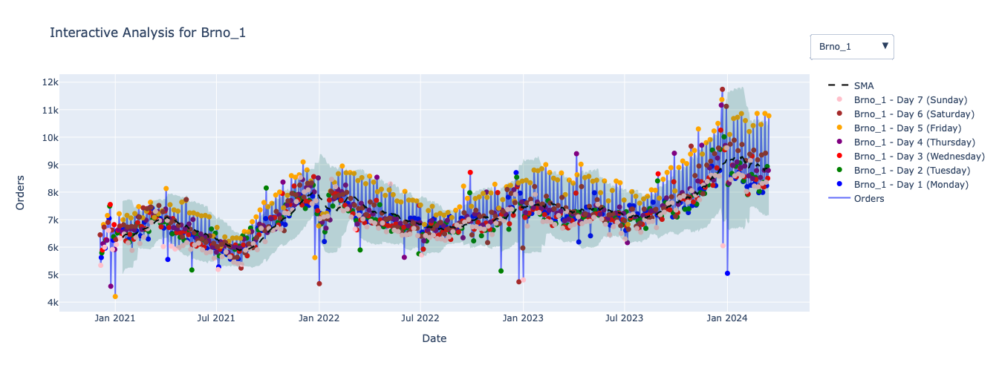

In [448]:
def plot_original_data_and_hist2(df: pd.DataFrame):
    # Define a color map for days of the week
    day_of_week_colors = {
        1: 'blue',   # Monday
        2: 'green',  # Tuesday
        3: 'red',    # Wednesday
        4: 'purple', # Thursday
        5: 'orange', # Friday
        6: 'brown',  # Saturday
        7: 'pink'    # Sunday
    }
    warehouse_traces = []
    so_far_traces = 0
    
    # Create initial figure with all warehouses (but only first one visible initially)
    fig = sp.make_subplots()
    
    selected_column = 'orders'
    # Create traces for all warehouses
    for i, warehouse in enumerate(warehouses):
        # Filter data for the warehouse
        group = df.loc[warehouse].copy()
        
        # Calculate SMA and standard deviation
        sma_window = 40  # default value
        std_multiplier = 2  # default value
        
        group['SMA'] = group['orders'].rolling(window=sma_window).mean()
        group['STD'] = group['orders'].rolling(window=sma_window).std()
        group['Upper Margin'] = group['SMA'] + std_multiplier * group['STD']
        group['Lower Margin'] = group['SMA'] - std_multiplier * group['STD']
        
        # Prepare data for the histogram and normal distribution
        warehouse_data = group['orders']
        mean = warehouse_data.mean()
        std = warehouse_data.std()
        x_values = np.linspace(min(warehouse_data), max(warehouse_data), 100)
        normal_curve = norm.pdf(x_values, mean, std)
        
        skew_val = round(skew(group.orders), 2)
        kurt_val = round(kurtosis(group.orders), 2)
        
        # Add traces for this warehouse
        # Set visibility based on whether it's the first warehouse
        visible = (i == 0)
        traces = 0
        # Time-series traces
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['orders'],
                                mode='lines', 
                                name="Orders",
                                visible=visible))
        traces +=1
        
        # Plot scatter points for each day of the week with different colors
        for day, color in day_of_week_colors.items():
            day_group = group[group['week_day'] == day]
            # if an warehouse doesn't have a day of week at all
            if day_group.shape[0]:
                fig.add_trace(go.Scatter(
                    x=day_group.index.get_level_values('date'),
                    y=day_group[selected_column],
    #                     mode='lines',
                    mode='markers',
                    name=f"{warehouse} - Day {day} ({pd.Timestamp(day_group.index[0]).strftime('%A')})",
                    marker=dict(color=color, size=7),
                    visible=(warehouse == warehouses[0])
                    # showlegend=(warehouse == warehouses[0])
                ))
                traces +=1
        #XYZ
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['SMA'],
                                mode='lines', 
                                name="SMA", 
                                line=dict(dash='dash', color='black'),
                                visible=visible))
        traces +=1
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['Upper Margin'],
                                mode='lines', 
                                name="Upper Margin", 
                                line=dict(color='rgba(0,0,0,0)'),
                                showlegend=False,
                                visible=visible))
        traces +=1
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['Lower Margin'],
                                mode='lines', 
                                name="Lower Margin", 
                                fill='tonexty',
                                line=dict(color='rgba(0,0,0,0)'), 
                                fillcolor='rgba(0, 100, 80, 0.2)',
                                showlegend=False,
                                visible=visible))
        traces +=1
        
        warehouse_traces.append((warehouse, traces, so_far_traces))
        so_far_traces += traces
    
    # Create dropdown menu buttons
    warehouse_dropdown = []
    total_traces = so_far_traces
    for warehouse, traces, so_far_traces in warehouse_traces:
        pre_vis = [False] * so_far_traces
        this_vis = [True] * traces
        post_vis = [False] * (total_traces - (traces + so_far_traces))
        visibility = pre_vis + this_vis + post_vis
        warehouse_dropdown.append(
            dict(
                args=[{"visible": visibility},
                      {"title": f"Interactive Analysis for {warehouse}",
                       "annotations[0].text": f"Orders Over Time for {warehouse} with SMA and Margins",
                       "annotations[1].text": f"Histogram and Normal Distribution for {warehouse}"}],
                label=warehouse,
                method="update"
            )
        )
    
    # Update layout
    fig.update_layout(
        height=500,
        width=FIGURE_WIDTH,
        title_text=warehouse_dropdown[0]['args'][1]['title'],
        xaxis=dict(title="Date"),
        yaxis=dict(title="Orders"),
        # xaxis2=dict(title="Orders"),
        # yaxis2=dict(title="Density"),
        updatemenus=[dict(
            buttons=warehouse_dropdown,
            direction="down",
            showactive=True,
            x=1,
            xanchor="left",
            y=1.2,
            yanchor="top",
            pad={"r": 10, "t": 10}
        )]
    )
        
    fig.show()

df2 = df.set_index(['warehouse', 'date'])
df2.sort_index(inplace=True)
_ = plot_original_data_and_hist2(df2)

## Special dates
> 👇 Interactive plots below.

<table>
  <tr>
    <td>
      <h3>Holidays</h3>
      <p style="font-size:15px">
        <strong>`Holidays`</strong> are important - it's bold that <em>Christmas Eve</em> 
        and the day before (24 of Dec) and the <em>New Year Eve</em> (1 of Jan) are 
        extremely low, while the day before <em>Christmas Eve</em> (23 of Dec) is 
        extremely high for most years and warehouses.<br><br>
        Also, the week of <em>Cyrila a Metodej</em> and <em>Jan Hus</em> on the following 
        day seems to be the low border of a trend that decreases from winter to summer 
        and then increases from summer to winter.<br><br>
        More holidays like <em>'Den osvobozeni'</em>, <em>'Den ceske statnosti'</em>, and 
        <em>'Den vzniku samostatneho ceskoslovenskeho statu'</em> increase orders 
        (compared to the rest of the month).
      </p>
    </td>
    <td>
      <img src="project_images/new_year_eve.png" alt="Holidays Image" width="1400" />
    </td>
  </tr>
  <tr>
    <td>
      <h3>Winter School Holidays</h3>
      <p style="font-size:15px">
        <strong>`Winter school holidays`</strong> seems to have a different effect in 
        different warehouses - while in most of the warehouses those events keep the 
        weekly pattern but slightly decrease the orders, in Budapest it increases the 
        orders (while keeping the weekly pattern), and at Munich, it seems to have no 
        effect at all.
      </p>
    </td>
    <td>
      <img src="project_images/winter_school_holidays_Prague_3.png" alt="Winter School Holidays Image" width="1400" />
    </td>
  </tr>
  <tr>
    <td>
      <h3>Shutdowns</h3>
      <p style="font-size:15px">
        <strong>`Shutdown`</strong> of different types seems to have a negative effect 
        on the orders, but they are very rare, and cannot be known in advance, so the 
        proper way to deal with them is to treat them as outliers, in order to avoid 
        their effect on the pattern we want to recognize.
      </p>
    </td>
    <td>
      <img src="project_images/shutdowns.png" alt="Shutdowns Image" width="1400" />
    </td>
  </tr>
  <tr>
    <td>
      <h3>Missing Dates</h3>
      <p style="font-size:15px">
        <strong>`Missing dates`</strong> is a data that I added, of dates within the 
        dates range of a warehouse's given data, that don't exist in the table.<br>
        Note that the day after <em>Christmas Eve</em> (25 of Dec) is missing for every 
        warehouse for every year.<br><br>
        At Budapest, there are a few dates that are missing every year.<br><br>
        The special case is in the German cities (Frankfurt and Munich) where (as seen previusly) every 
        Sunday is missing (except 3 in Munich), in addition to more dates that seem to be missing every 
        year.<br><br>
        I interpreted the missing dates as days where Rohlik didn't work at all in a 
        given warehouse, since the missing dates are not random but have a yearly/weekly 
        pattern, while also not considered as an error in the data gathering since the 
        data is given by Rohlik themselves.<br>
        Therefore, I will fill the missing dates' orders value as 0.
      </p>
    </td>
    <td>
      <img src="project_images/missing_value_Frankfurt.png" alt="Missing Dates Image" width="1400" />
    </td>
  </tr>
  <tr>
    <td>
      <h3>Shops Closed</h3>
      <p style="font-size:15px">
        <strong>`Shops closed`</strong> seems to add no information, given the holidays.<br>
          Those events could be identify in the plot as the black triangles.
      </p>
    </td>
    <td>
      <img src="project_images/shops_closed.png" alt="shops_closed" width="1400" />
    </td>
  </tr>
  <tr>
    <td>
      <h3>Website Data</h3>
        <h4>mov_change</h4>
          <p>
            <strong>`mov_change`</strong> indicates a change in a minimum order value. It occured during Oct 22' until Jun 23' (marked in a blue trectangle), and seems to restrict the orders as 2022 didn't reach a higher winter mean of orders compared to the year before, while the general trend of those year increased.<br>
              You can see it in the image on the right:<br><br>
              This correlation could be explained by 2 oposite thesis:
              <br>
          </p>
              <ul>
                  <li>This restriction made the customers to buy less, so the trend didn't increase at that year - negaive effect.</li>
                  <li>There was not a general trend increase while the only evidance we have is the single diffrence between the 2 previus years, but this temporary restriction changed the behavior of the customers (gained more customers, or made the customers to make more oreders), so the increase of trend was due to this restriction - positive effect.</li>
        </ul>
        <h4>User Activity</h4>
          <p>
            <strong>`User Activity`</strong> is given by 2 diffrent indicators, but their meaning is classified. user_acivity_1 (pink line) distribute with lower mean and std than "orders" values while user_acivity_2 (green line) distribute with higher mean (about 6 times) than "orders" values. In order analyze them visually, I transform them into new distribution by orders mean and std.<br>
              That doesn't mean they distribue by normal distribution, it just for the pupose of making it possible to plot them with orders value in the same plot.<br><br>
              user_activity_2 seems to act like a trend of the orders, while user_acivity_1 seems to act diffrently for diffrent warehouses (for some it decrease over time). for most of the plots user_acivity_1 looks like it has a connection to the STD of orders, like some kind of "volumne" indicator. I belive that user_acivity_1 describe traffic in Rohlik website, while user_acivity_2 show count of items been purchased, but those assumptions cannot be proved, so those indicator will be more relevant for insights than for actual prediction.<br>
              You can see it in the image on the right:
          </p>
    </td>
    <td>
      <img src="project_images/mov_change.png" alt="mov_change" width="1400" />
        <p><br><br><br><br><br></p>
      <img src="project_images/user_activity.png" alt="user_activity" width="1400" />
    </td>
  </tr>
</table>

>❓ The upper plot presents the actual data and special dates<br>
>❓ The upper plot presents the actual data website data over it.

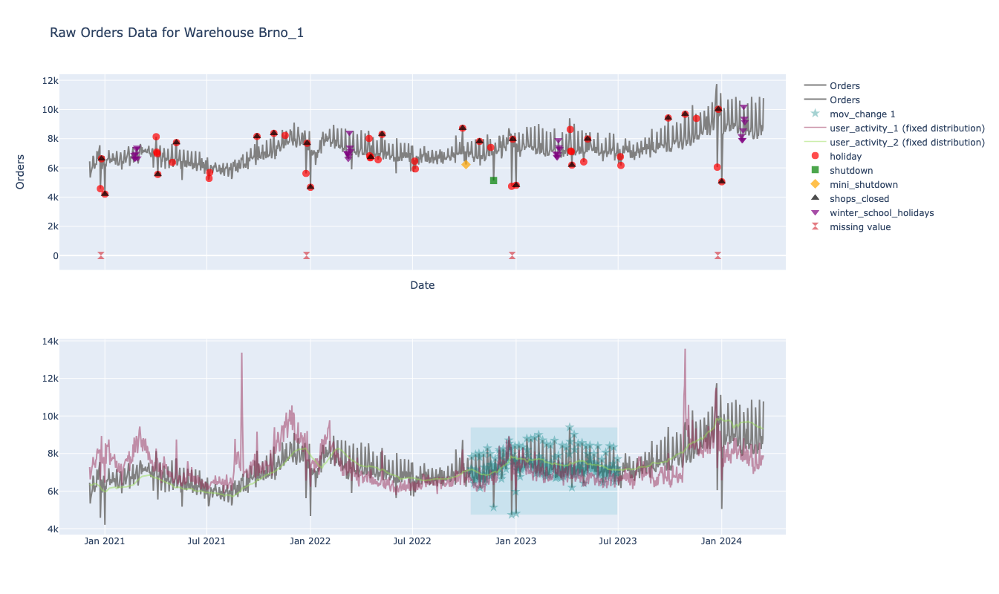

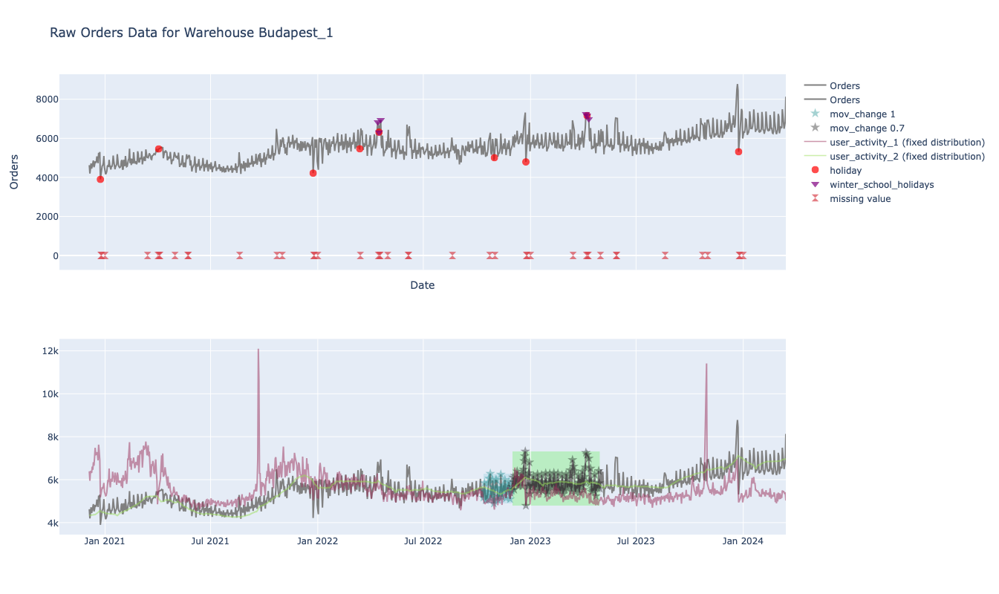

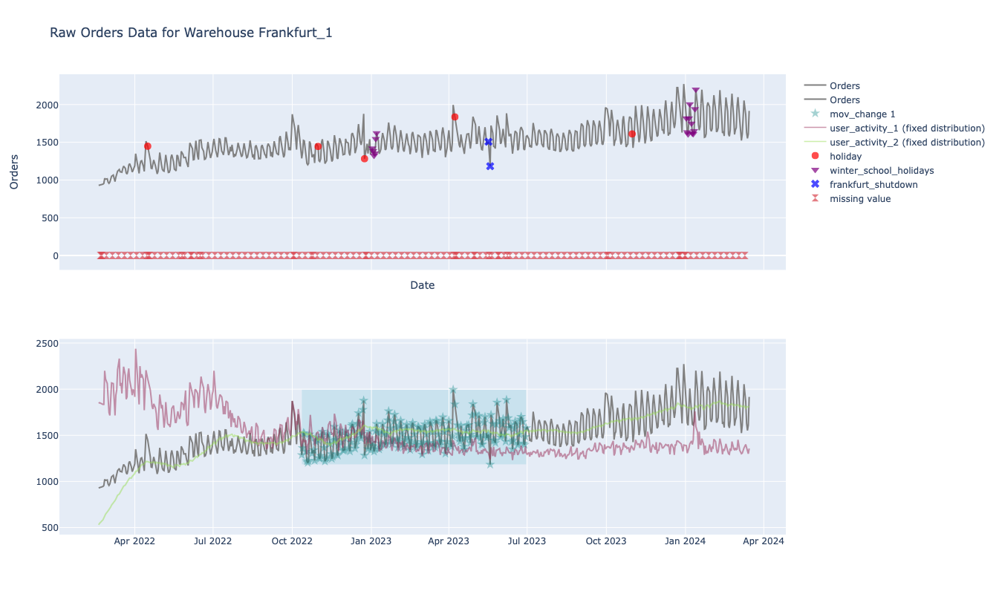

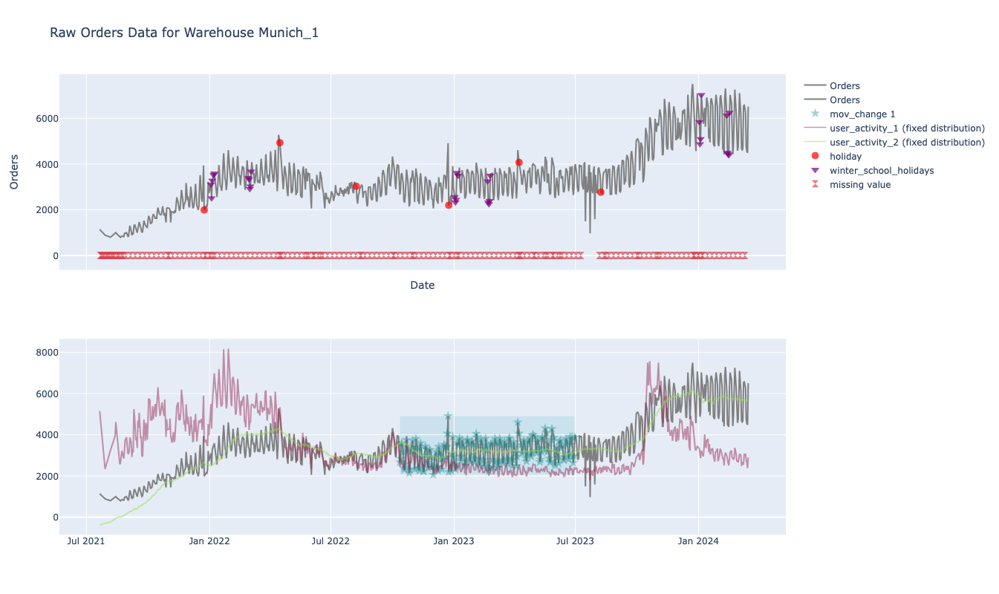

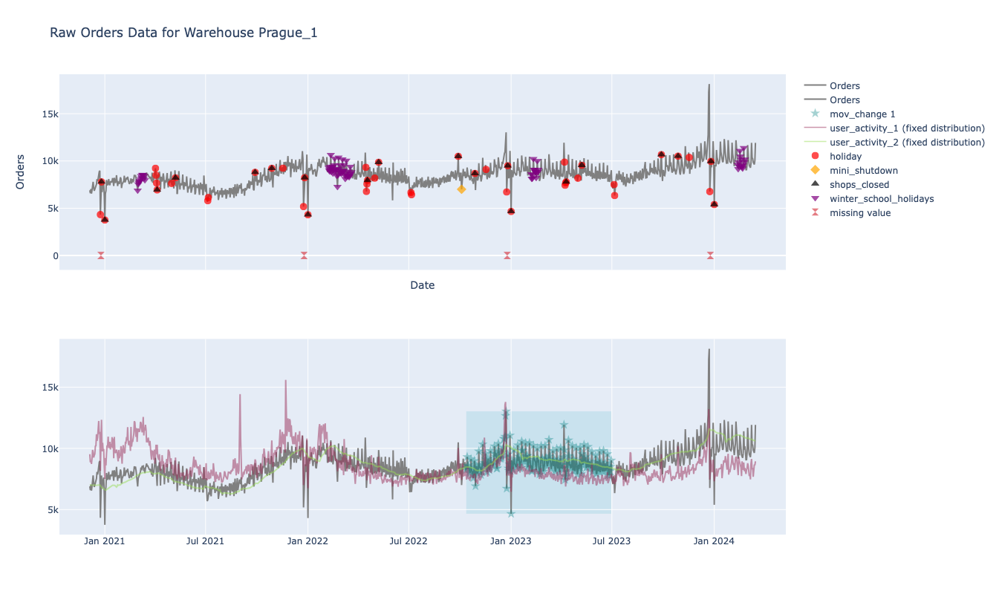

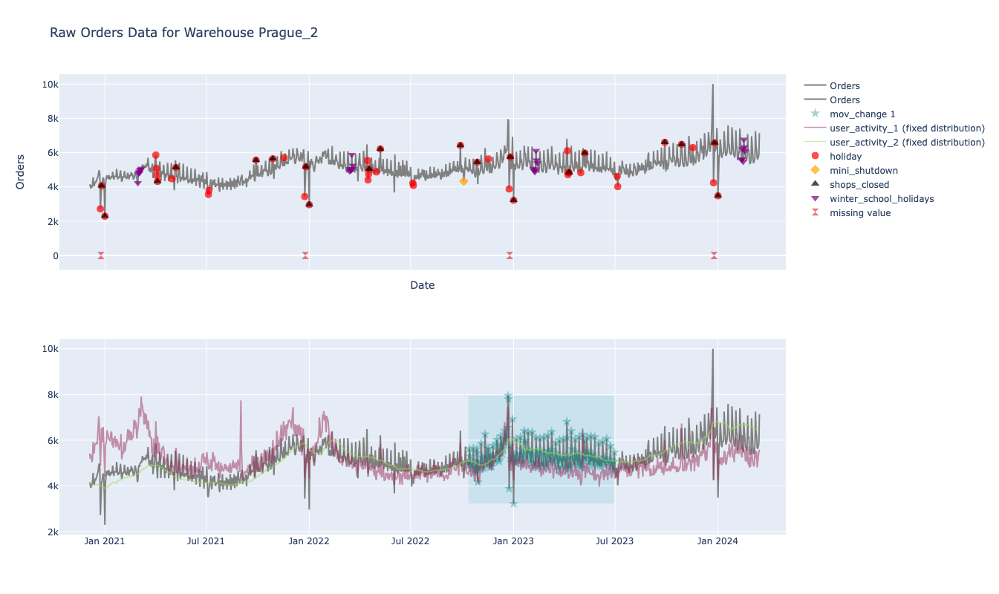

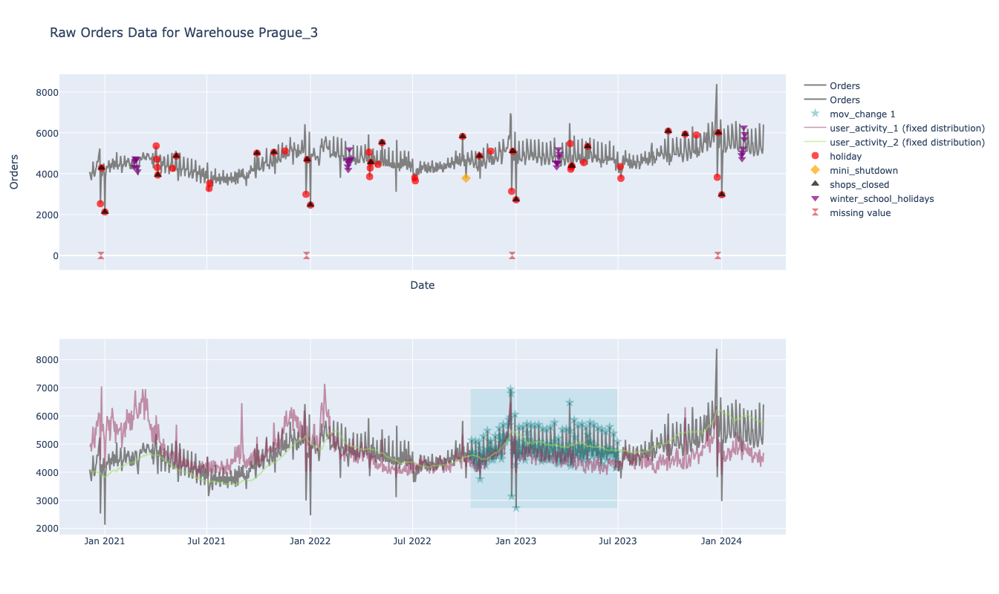

In [451]:
import plotly.graph_objects as go
import numpy as np

# Updated list of special dates, colors, and marker symbols
special_dates = [
    'holiday', 'shutdown', 'mini_shutdown', 'shops_closed', 
    'winter_school_holidays', 'frankfurt_shutdown'
]
colors = ['red', 'green', 'orange', 'black', 'purple', 'blue']
marker_shapes = ['circle', 'square', 'diamond', 'triangle-up', 'triangle-down', 'x']

# Determine the unique warehouses
warehouses = df['warehouse'].unique()
warehouses.sort()

# Create individual plots for each warehouse
figures = []

for warehouse in warehouses:
    group = df[df['warehouse'] == warehouse]  # Filter data for the current warehouse
    
    # Create a figure for the warehouse
    fig = sp.make_subplots(rows=2, cols=1, shared_xaxes=True)
    
    ###### orders for all
    # Add the main line plot for raw orders data
    fig.add_trace(
        go.Scatter(
            x=np.array(group['date']),  # Explicit conversion
            y=group['orders'],
            mode='lines',
            name="Orders",
            line=dict(color='gray'),
        ),
        row=1, col=1
    )
    # Add the main line plot for raw orders data
    fig.add_trace(
        go.Scatter(
            x=np.array(group['date']),  # Explicit conversion
            y=group['orders'],
            mode='lines',
            name="Orders",
            line=dict(color='gray'),
        ),
        row=2, col=1
    )
    
    ###### second plot
    
    # mov_change 1
    temp = group[group['mov_change'] ==1][['date', 'orders', 'holiday_name']].copy()
    if not temp.empty:
        x = np.array(temp['date'])
        x0 = str(np.min(x))
        x1 = str(np.max(x))
        fig.add_shape(
            type="rect",
            x0=x0,  # Start of the rectangle (x-axis)
            x1=x1,  # End of the rectangle (x-axis)
            y0=temp['orders'].min(),   # Start of the rectangle (y-axis)
            y1=temp['orders'].max(),  # End of the rectangle (y-axis)
            fillcolor="lightblue",  # Background color
            opacity=0.5,            # Transparency
            layer="below",          # Ensure it's behind the data
            line_width=0,            # No border
            row=2, col=1
        )
        
        fig.add_trace(
            go.Scatter(
                x=np.array(temp['date']),
                y=temp['orders'],
                mode='markers',
                name='mov_change 1',
                marker=dict(
                    color='teal',
                    symbol='star',
                    size=10,
                    opacity=0.7
                ),
                hovertemplate=(
                    "<b>Date:</b> %{x}<br>"  # Display date
                    "<b>Orders:</b> %{y}<br>"  # Display orders
                ),
                opacity=0.5
            ),
            row=2, col=1
        )
    
    # mov_change 0.7
    temp = group[group['mov_change'] == 0.7][['date', 'orders', 'holiday_name']].copy()
    if not temp.empty:
        x = np.array(temp['date'])
        x0 = str(np.min(x))
        x1 = str(np.max(x))
        fig.add_shape(
            type="rect",
            x0=x0,  # Start of the rectangle (x-axis)
            x1=x1,  # End of the rectangle (x-axis)
            y0=temp['orders'].min(),   # Start of the rectangle (y-axis)
            y1=temp['orders'].max(),  # End of the rectangle (y-axis)
            fillcolor="lightgreen",  # Background color
            opacity=0.5,            # Transparency
            layer="below",          # Ensure it's behind the data
            line_width=0,            # No border
            row=2, col=1
        )
        
        fig.add_trace(
            go.Scatter(
                x=np.array(temp['date']),
                y=temp['orders'],
                mode='markers',
                name='mov_change 0.7',
                marker=dict(
                    color='black',
                    symbol='star',
                    size=10,
                    opacity=0.7
                ),
                hovertemplate=(
                    "<b>Date:</b> %{x}<br>"  # Display date
                    "<b>Orders:</b> %{y}<br>"  # Display orders
                ),
                opacity=0.5
            ),
            row=2, col=1
        )
    
    # user activity
    ua1 = (group['user_activity_1'] - group['user_activity_1'].mean()) / group['user_activity_1'].std()
    ua1 = ua1 * group.orders.std() + group.orders.mean()
    # Add the main line plot for raw orders data
    fig.add_trace(
        go.Scatter(
            x=np.array(group['date']),  # Explicit conversion
            y=ua1,
            mode='lines',
            name="user_activity_1 (fixed distribution)",
            line=dict(color='#9A2D57'),
            opacity=0.5
        ),
        row=2, col=1
    )
    
    ua2 = (group['user_activity_2'] - group['user_activity_2'].mean()) / group['user_activity_2'].std()
    ua2 = ua2 * group.orders.std() + group.orders.mean()
    fig.add_trace(
        go.Scatter(
            x=np.array(group['date']),  # Explicit conversion
            y=ua2,
            mode='lines',
            name="user_activity_2 (fixed distribution)",
            line=dict(color='#9ADD57'),
            opacity=0.5
        ),
        row=2, col=1
    )
    
    # first plot
    # Add scatter plots for special dates
    for column, color, marker_shape in zip(special_dates, colors, marker_shapes):
        temp = group[group[column] == 1][['date', 'orders', 'holiday_name']].copy()
        if not temp.empty:
            fig.add_trace(
                go.Scatter(
                    x=np.array(temp['date']),
                    y=temp['orders'],
                    mode='markers',
                    name=column,
                    marker=dict(
                        color=color,
                        symbol=marker_shape,
                        size=10,
                        opacity=0.7
                    ),
                    hovertemplate=(
                        "<b>Date:</b> %{x}<br>"  # Display date
                        "<b>Orders:</b> %{y}<br>"  # Display orders
                        "<b>Holiday:</b> %{customdata}"  # Display holiday_name
                    ),
                    customdata=temp['holiday_name']  # Add holiday_name as custom data
                ),
                row=1, col=1
            )
    
    # Add missing days
    missing_dates = pd.date_range(start=group.date.min(), end=group.date.max())
    group.set_index('date', inplace=True)
    group = group.reindex(missing_dates)
    group = group[group.orders.isna()].copy()
    group.index.name = 'date'
    group = group.reset_index()
    
    fig.add_trace(
            go.Scatter(
                x=np.array(group['date']),
                y=[0]*group.shape[0],
                mode='markers',
                name='missing value',
                marker=dict(
                    color='#D9454F',
                    symbol='hourglass',
                    size=10,
                    opacity=0.7
                ),
            ),
            row=1, col=1
        )
    
    
    
    # Update layout for the current figure with increased height
    fig.update_layout(
        title=f"Raw Orders Data for Warehouse {warehouse}",
        xaxis_title="Date",
        yaxis_title="Orders",
        showlegend=True,
        height=800  # Set the height of the plot
    )
    
    # Add this figure to the list of figures
    figures.append(fig)

# Display all figures
for fig in figures:
    fig.show()


## Weather
As we can see in the following plots, precipitation and snow got no effect on the orders.<br>
while snow appear on the peaks of the year, it is only due to the fact that there is snow at the winter and the peaks are in the middle of the winter, and since we have date - the snow add no information. Diffrent values of precipitation shown troughout the years at the highs and lows of trend. Both details seems to have no effect on weekly pattern either.

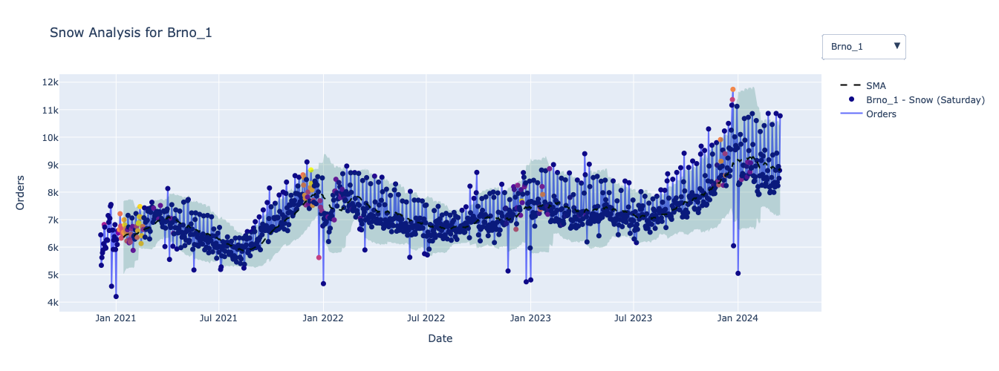

In [453]:
def plot_original_data_and_hist2(df: pd.DataFrame):
    warehouse_traces = []
    so_far_traces = 0
    
    # Create initial figure with all warehouses (but only first one visible initially)
    fig = sp.make_subplots()
    
    selected_column = 'orders'
    # Create traces for all warehouses
    for i, warehouse in enumerate(warehouses):
        # Filter data for the warehouse
        group = df.loc[warehouse].copy()
        
        # Calculate SMA and standard deviation
        sma_window = 40  # default value
        std_multiplier = 2  # default value
        
        group['SMA'] = group['orders'].rolling(window=sma_window).mean()
        group['STD'] = group['orders'].rolling(window=sma_window).std()
        group['Upper Margin'] = group['SMA'] + std_multiplier * group['STD']
        group['Lower Margin'] = group['SMA'] - std_multiplier * group['STD']
        
        # Prepare data for the histogram and normal distribution
        warehouse_data = group['orders']
        mean = warehouse_data.mean()
        std = warehouse_data.std()
        x_values = np.linspace(min(warehouse_data), max(warehouse_data), 100)
        normal_curve = norm.pdf(x_values, mean, std)
        
        skew_val = round(skew(group.orders), 2)
        kurt_val = round(kurtosis(group.orders), 2)
        
        # Add traces for this warehouse
        # Set visibility based on whether it's the first warehouse
        visible = (i == 0)
        traces = 0
        # Time-series traces
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['orders'],
                                mode='lines', 
                                name="Orders",
                                visible=visible))
        traces +=1
        
        fig.add_trace(go.Scatter(
            x=group.index.get_level_values('date'),
            y=group[selected_column],
#                     mode='lines',
            mode='markers',
            name=f"{warehouse} - Snow ({pd.Timestamp(group.index[0]).strftime('%A')})",
            marker=dict(color=group.snow.apply(lambda p: np.log(p+1)), size=7),
            visible=(warehouse == warehouses[0])
            # showlegend=(warehouse == warehouses[0])
        ))
        traces +=1
        #XYZ
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['SMA'],
                                mode='lines', 
                                name="SMA", 
                                line=dict(dash='dash', color='black'),
                                visible=visible))
        traces +=1
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['Upper Margin'],
                                mode='lines', 
                                name="Upper Margin", 
                                line=dict(color='rgba(0,0,0,0)'),
                                showlegend=False,
                                visible=visible))
        traces +=1
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['Lower Margin'],
                                mode='lines', 
                                name="Lower Margin", 
                                fill='tonexty',
                                line=dict(color='rgba(0,0,0,0)'), 
                                fillcolor='rgba(0, 100, 80, 0.2)',
                                showlegend=False,
                                visible=visible))
        traces +=1
        
        warehouse_traces.append((warehouse, traces, so_far_traces))
        so_far_traces += traces
    
    # Create dropdown menu buttons
    warehouse_dropdown = []
    total_traces = so_far_traces
    for warehouse, traces, so_far_traces in warehouse_traces:
        pre_vis = [False] * so_far_traces
        this_vis = [True] * traces
        post_vis = [False] * (total_traces - (traces + so_far_traces))
        visibility = pre_vis + this_vis + post_vis
        warehouse_dropdown.append(
            dict(
                args=[{"visible": visibility},
                      {"title": f"Snow Analysis for {warehouse}",
                       "annotations[0].text": f"Orders Over Time for {warehouse} with SMA and Margins",
                       "annotations[1].text": f"Histogram and Normal Distribution for {warehouse}"}],
                label=warehouse,
                method="update"
            )
        )
    
    # Update layout
    fig.update_layout(
        height=500,
        width=FIGURE_WIDTH,
        title_text=warehouse_dropdown[0]['args'][1]['title'],
        xaxis=dict(title="Date"),
        yaxis=dict(title="Orders"),
        # xaxis2=dict(title="Orders"),
        # yaxis2=dict(title="Density"),
        updatemenus=[dict(
            buttons=warehouse_dropdown,
            direction="down",
            showactive=True,
            x=1,
            xanchor="left",
            y=1.2,
            yanchor="top",
            pad={"r": 10, "t": 10}
        )]
    )
        
    fig.show()

df2 = df.set_index(['warehouse', 'date'])
df2.sort_index(inplace=True)
_ = plot_original_data_and_hist2(df2)

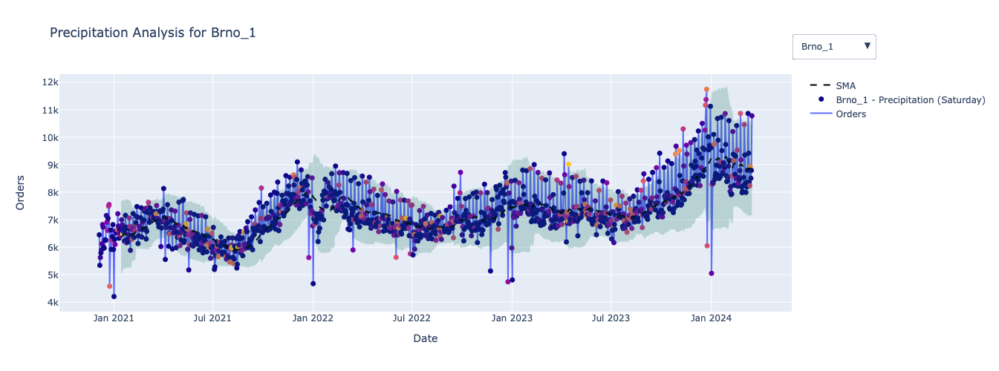

In [455]:
def plot_original_data_and_hist2(df: pd.DataFrame):
    warehouse_traces = []
    so_far_traces = 0
    
    # Create initial figure with all warehouses (but only first one visible initially)
    fig = sp.make_subplots()
    
    selected_column = 'orders'
    # Create traces for all warehouses
    for i, warehouse in enumerate(warehouses):
        # Filter data for the warehouse
        group = df.loc[warehouse].copy()
        
        # Calculate SMA and standard deviation
        sma_window = 40  # default value
        std_multiplier = 2  # default value
        
        group['SMA'] = group['orders'].rolling(window=sma_window).mean()
        group['STD'] = group['orders'].rolling(window=sma_window).std()
        group['Upper Margin'] = group['SMA'] + std_multiplier * group['STD']
        group['Lower Margin'] = group['SMA'] - std_multiplier * group['STD']
        
        # Prepare data for the histogram and normal distribution
        warehouse_data = group['orders']
        mean = warehouse_data.mean()
        std = warehouse_data.std()
        x_values = np.linspace(min(warehouse_data), max(warehouse_data), 100)
        normal_curve = norm.pdf(x_values, mean, std)
        
        skew_val = round(skew(group.orders), 2)
        kurt_val = round(kurtosis(group.orders), 2)
        
        # Add traces for this warehouse
        # Set visibility based on whether it's the first warehouse
        visible = (i == 0)
        traces = 0
        # Time-series traces
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['orders'],
                                mode='lines', 
                                name="Orders",
                                visible=visible))
        traces +=1
        
        fig.add_trace(go.Scatter(
            x=group.index.get_level_values('date'),
            y=group[selected_column],
#                     mode='lines',
            mode='markers',
            name=f"{warehouse} - Precipitation ({pd.Timestamp(group.index[0]).strftime('%A')})",
            marker=dict(color=group.precipitation.apply(lambda p: np.log(p+1)), size=7),
            visible=(warehouse == warehouses[0])
            # showlegend=(warehouse == warehouses[0])
        ))
        traces +=1
        #XYZ
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['SMA'],
                                mode='lines', 
                                name="SMA", 
                                line=dict(dash='dash', color='black'),
                                visible=visible))
        traces +=1
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['Upper Margin'],
                                mode='lines', 
                                name="Upper Margin", 
                                line=dict(color='rgba(0,0,0,0)'),
                                showlegend=False,
                                visible=visible))
        traces +=1
        fig.add_trace(go.Scatter(x=group.index.get_level_values('date'), 
                                y=group['Lower Margin'],
                                mode='lines', 
                                name="Lower Margin", 
                                fill='tonexty',
                                line=dict(color='rgba(0,0,0,0)'), 
                                fillcolor='rgba(0, 100, 80, 0.2)',
                                showlegend=False,
                                visible=visible))
        traces +=1
        
        warehouse_traces.append((warehouse, traces, so_far_traces))
        so_far_traces += traces
    
    # Create dropdown menu buttons
    warehouse_dropdown = []
    total_traces = so_far_traces
    for warehouse, traces, so_far_traces in warehouse_traces:
        pre_vis = [False] * so_far_traces
        this_vis = [True] * traces
        post_vis = [False] * (total_traces - (traces + so_far_traces))
        visibility = pre_vis + this_vis + post_vis
        warehouse_dropdown.append(
            dict(
                args=[{"visible": visibility},
                      {"title": f"Precipitation Analysis for {warehouse}",
                       "annotations[0].text": f"Orders Over Time for {warehouse} with SMA and Margins",
                       "annotations[1].text": f"Histogram and Normal Distribution for {warehouse}"}],
                label=warehouse,
                method="update"
            )
        )
    
    # Update layout
    fig.update_layout(
        height=500,
        width=FIGURE_WIDTH,
        title_text=warehouse_dropdown[0]['args'][1]['title'],
        xaxis=dict(title="Date"),
        yaxis=dict(title="Orders"),
        # xaxis2=dict(title="Orders"),
        # yaxis2=dict(title="Density"),
        updatemenus=[dict(
            buttons=warehouse_dropdown,
            direction="down",
            showactive=True,
            x=1,
            xanchor="left",
            y=1.2,
            yanchor="top",
            pad={"r": 10, "t": 10}
        )]
    )
        
    fig.show()

df2 = df.set_index(['warehouse', 'date'])
df2.sort_index(inplace=True)
_ = plot_original_data_and_hist2(df2)

It might be hard to interpretate the plots by color, so I will show the orders values as a function of the weather data. As we can see there is no meaningful correlation between the variables, as the values of orders (y axis) evengly distibute, or distribute in gasusian like distribution (the "bell" of the distribution is horizonly placed).<br>
Therefore, I will not use them in the process.

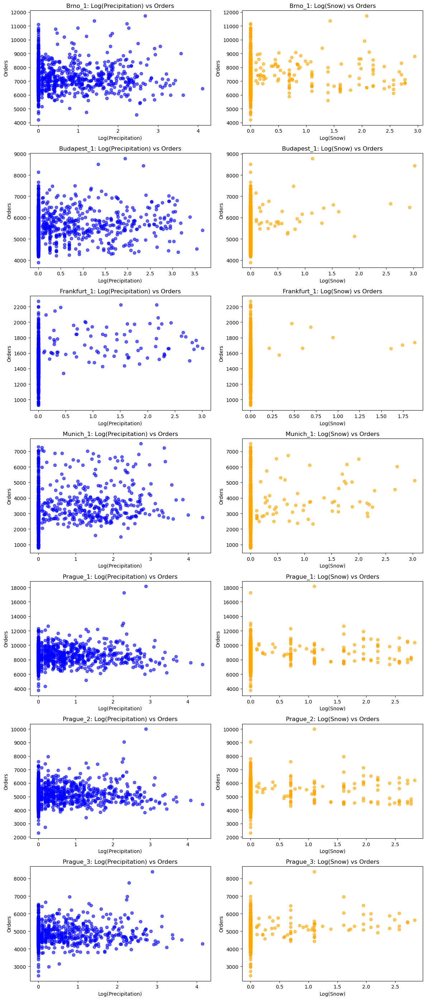

In [458]:
# Create subplots
fig, axes = plt.subplots(len(warehouses), 2, figsize=(12, 28))  # 1 row, 2 columns

for i, warehouse in enumerate(warehouses):
    # Filter data for the given warehouse
    group = df[df.warehouse == warehouse].copy()

    # First scatter plot: Precipitation vs Orders
    axes[i][0].scatter(
        np.log(group.precipitation.apply(lambda p: p+1)), 
        group.orders, 
        color='blue', alpha=0.6
    )
    axes[i][0].set_title(f"{warehouse}: Log(Precipitation) vs Orders")
    axes[i][0].set_xlabel("Log(Precipitation)")
    axes[i][0].set_ylabel("Orders")

    # Second scatter plot: Snow vs Orders
    axes[i][1].scatter(
        np.log(group.snow.apply(lambda p: p+1)), 
        group.orders, 
        color='orange', alpha=0.6
    )
    axes[i][1].set_title(f"{warehouse}: Log(Snow) vs Orders")
    axes[i][1].set_xlabel("Log(Snow)")
    axes[i][1].set_ylabel("Orders")

    # Adjust spacing and show the figure
    plt.tight_layout()
plt.show()

## Raw data analysis summery
### Orders over time:
>1. The general trend is an increase of orders throgh the years.
>2. Day of the week in an importent feature.
>3. Time of the year is an imprtent feature.
>4. "orders" seems to distribute approxemtly in Gamma distribution with right side tail.

### Categorical data:
>1. Diffrent warehouses need diffrent models as they act diffrently and in diffrent scales.
>2. Some holidays are importent.
>3. Winter school holidays have a minor effect, so should be considered.
>4. Shutdowns dates should be removed as they are rare outliers which cannot be known in advance.

### Normaliztion, Transforms and Missing Values

>When dealing with missing values in time series data, especially in contexts like ours where missing values are due to specific events or periods (e.g., holidays or regular gaps like Sundays), the treatment should be done thoughtfully to avoid introducing biases or distorting underlying patterns. In addition, diffrent algorithms require diffrent data preperations, therefore this part should be done for each algorithm separately.
>
>We need to fill the missing dates in order to use sequetial models like LSTM, Prophet and XGBoost with lags.
Here are the key steps to ensure the data is treated appropriately:
>#### Apply Normalization or Transformation First:
>**Normalization or transformations** (like Box-Cox) should always be done **before** filling missing values. The reason for this is that applying transformations like normalization or Box-Cox to data **before** filling missing values ensures that these operations reflect the natural range and distribution of the data, without being influenced by the imputation method. Filling missing values might artificially shift the distribution, which can create bias in the subsequent model training.
>
>#### Interpolate to Fill Missing Values:
>- **Interpolation** is a good strategy for our data, since it helps fill gaps in a way that **preserves patterns** in the data, which is particularly important for time series where sudden jumps (like filling with 0s) could break existing trends or seasonal patterns.
>- By interpolating, we are leveraging the existing data to make educated guesses about the missing points, ensuring the gaps are filled with plausible values that maintain the consistency of the time series. Interpolation avoids the creation of artificial 0s, which would otherwise be interpreted as a sudden drop in orders or other key metrics, potentially skewing any trend analysis or predictive modeling.
>
>#### Why Interpolation is Preferred Over 0-Filling:
>- **Patterns and Trends:** If we fill missing values with zeros, it could be interpreted by the model as a sudden and unnatural event (e.g., a large drop in orders), especially if the missing values are occurring at regular intervals (e.g., every Sunday). This could distort any model that tries to learn underlying patterns.
>- **Realistic Filling:** Interpolation takes into account the surrounding data, meaning it reflects the natural progression of our series rather than an arbitrary zero value. It prevents breaking the temporal dependencies and ensures that the model can learn the actual trends and seasonality present in the data.

# Prediction Models

## Prophet Model

### Overview and Application
**Prophet** is a forecasting tool developed by Facebook, designed to handle time series data that exhibits strong seasonal patterns, trends, and anomalies. It is particularly suited for business and economic applications, such as sales or demand forecasting. Prophet is robust to missing data, outliers, and sudden changes, making it a flexible option for real-world datasets.

### How Prophet Works

Prophet decomposes the time series into three main components:
1. **Trend $(g(t))$**: Captures the long-term increase or decrease in the data.
2. **Seasonality $(s(t))$**: Models periodic changes in the data, such as weekly or yearly patterns.
3. **Holidays $(h(t))$**: Incorporates the effects of known events or holidays that impact the data.

The forecasted value $y(t)$ at time $t$ is given by:
$$y(t) = g(t) + s(t) + h(t) + \epsilon_t$$
where:
- $g(t)$: The trend component, modeled using a piecewise linear or logistic growth function.
- $s(t)$: The seasonal component, modeled as a Fourier series to capture periodicity.
- $h(t)$: The holiday effects, which can be specified as a set of known dates.
- $\epsilon_t$: The error term, accounting for noise in the data.

#### Trend Component
For a linear trend:
$$g(t) = k + mt$$
where $k$ is the initial value and $m$ is the rate of growth.

For a logistic growth trend, the model includes a carrying capacity $C$:
$$g(t) = \frac{C}{1 + \exp(-k(t - t_0))}$$
where $t_0$ is the midpoint of growth, and $k$ controls the growth rate.

### Input Requirements for Prophet

- Normalization is **not required** for Prophet, as it handles raw data effectively. However, extreme magnitudes in the `y` column can sometimes benefit from scaling for better interpretability.
- **Missing Values** - Prophet is robust to missing values in the `y` column. It does not require imputation, as it automatically handles gaps in the time series.
- Seasonal patterns (e.g., daily, weekly, yearly) are automatically detected but can also be customized using the `seasonality_mode` parameter.
- Known events like holidays or promotions can be provided as additional input to the model.

### Key Strengths of Prophet
- Handles non-stationary data without requiring differencing or transformations.
- Manages missing data and outliers gracefully.
- Easy to use, with minimal pre-processing.

In [50]:
from prophet import Prophet

In [52]:
# Pivot the data to have a separate column for each warehouse
df_pivoted = df.pivot(index='date', columns='warehouse', values='orders').reset_index()
df_pivoted['date'] = pd.to_datetime(df_pivoted['date'])

In [54]:
# Function to create and forecast for each warehouse
def forecast_warehouse(data, warehouse, periods=60):
    print(f"Forecasting for warehouse: {warehouse}")
    
    # Prepare the data for Prophet
    df_prophet = data[['date', warehouse]].rename(columns={'date': 'ds', warehouse: 'y'}).dropna()

    # Initialize the Prophet model
    model = Prophet()

    # Add holidays if provided
    # if holidays is not None:
    if warehouse in ('Frankfurt_1', 'Munich_1'):
        model.add_country_holidays(country_name='Germany')
    else:
        model.add_country_holidays(country_name='Czechia')

    # Fit the model
    model.fit(df_prophet)

    # Create a DataFrame for future dates
    future = model.make_future_dataframe(periods=periods)

    # Predict the future
    forecast = model.predict(future)

    # Return the forecasted data
    return forecast, model

In [56]:
# Create forecasts for each warehouse
forecasts = {}
models = {}
for warehouse in df_pivoted.columns[1:]:  # Skip the 'date' column
    df_pivoted_train, df_pivoted_test = df_pivoted.iloc[:-60], df_pivoted.iloc[-60:]
    forecast, model = forecast_warehouse(df_pivoted_train, warehouse)
    forecasts[warehouse] = forecast
    models[warehouse] = model

15:18:54 - cmdstanpy - INFO - Chain [1] start processing
15:18:54 - cmdstanpy - INFO - Chain [1] done processing


Forecasting for warehouse: Brno_1


15:18:55 - cmdstanpy - INFO - Chain [1] start processing
15:18:55 - cmdstanpy - INFO - Chain [1] done processing


Forecasting for warehouse: Budapest_1


15:18:55 - cmdstanpy - INFO - Chain [1] start processing
15:18:55 - cmdstanpy - INFO - Chain [1] done processing


Forecasting for warehouse: Frankfurt_1
Forecasting for warehouse: Munich_1


15:18:55 - cmdstanpy - INFO - Chain [1] start processing
15:18:55 - cmdstanpy - INFO - Chain [1] done processing
15:18:55 - cmdstanpy - INFO - Chain [1] start processing
15:18:56 - cmdstanpy - INFO - Chain [1] done processing


Forecasting for warehouse: Prague_1


15:18:56 - cmdstanpy - INFO - Chain [1] start processing
15:18:56 - cmdstanpy - INFO - Chain [1] done processing


Forecasting for warehouse: Prague_2


15:18:56 - cmdstanpy - INFO - Chain [1] start processing
15:18:56 - cmdstanpy - INFO - Chain [1] done processing


Forecasting for warehouse: Prague_3


### Prophet results
<table>
  <tr>
    <td>
      <p style="font-size:16px">
          As we can see, this model didn't manage to really capture the data behivor. The weekly pattern is extreamly simple even though the dates are given so a weekly pattern could be identify, and it seems that Prophet is predicting the same pattern around the general trend, like doing "copy-paste" around the moving average.<br><br>
          I didn't preprocessed the data since this model supposes to deal with it by itself, and also didn't do feature engineering, in order to see first basic prediction by this model.<br>
          This model didn't really learn the very bold weekly pattern at all, so I belive that that this model doesn't suitable for my task, and I better pursite another one.
      </p>
    </td>
    <td>
      <img src="project_images/prophet_pred_on_Frankfurt_1.png" alt="weekly" width="1400" />
      <img src="project_images/prophet_pred_on_Prague_1.png" alt="weekly" width="1400" />
    </td>
  </tr>
</table>

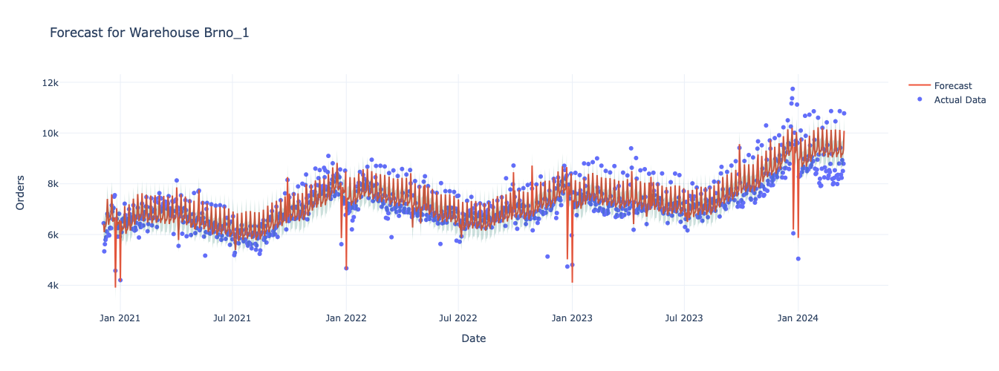

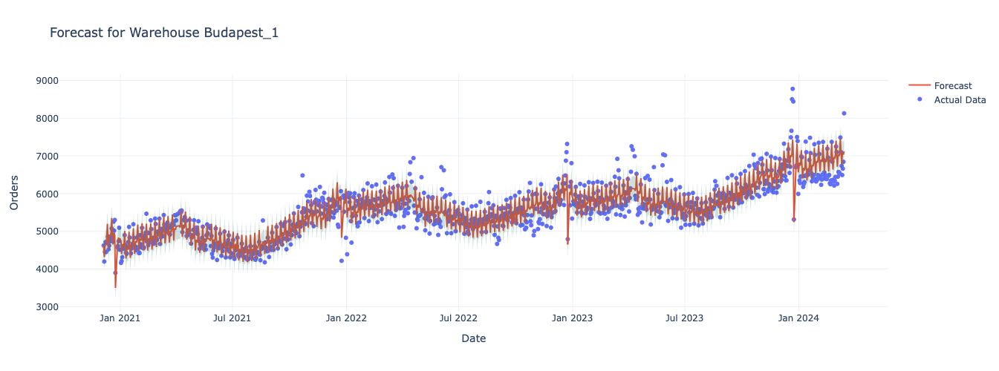

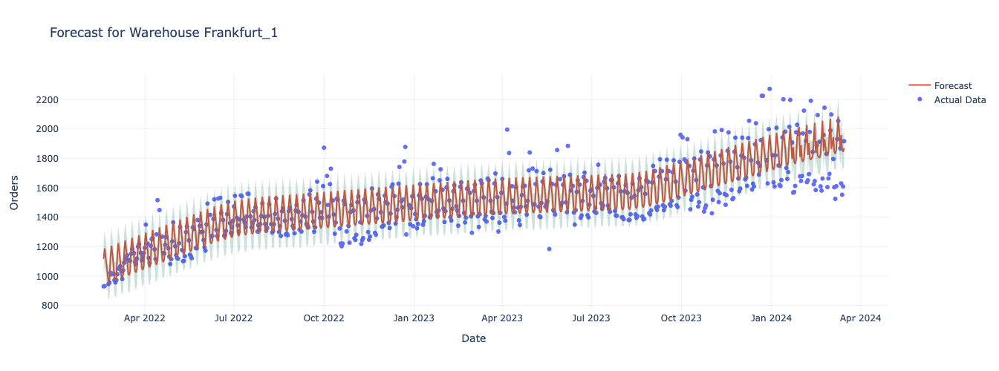

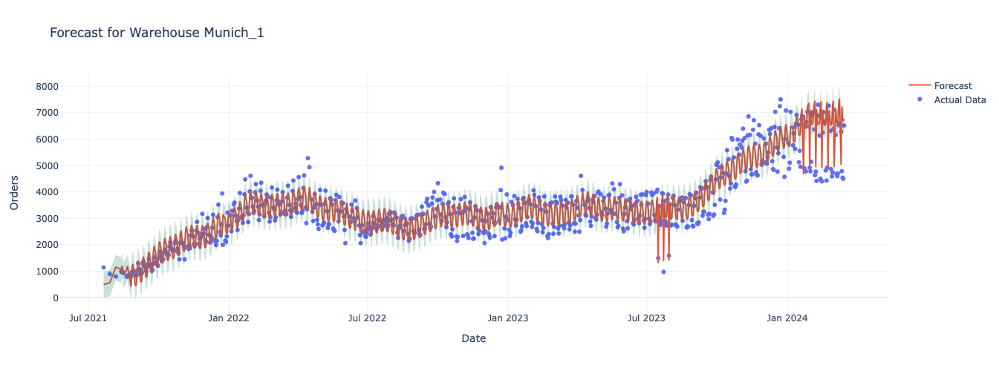

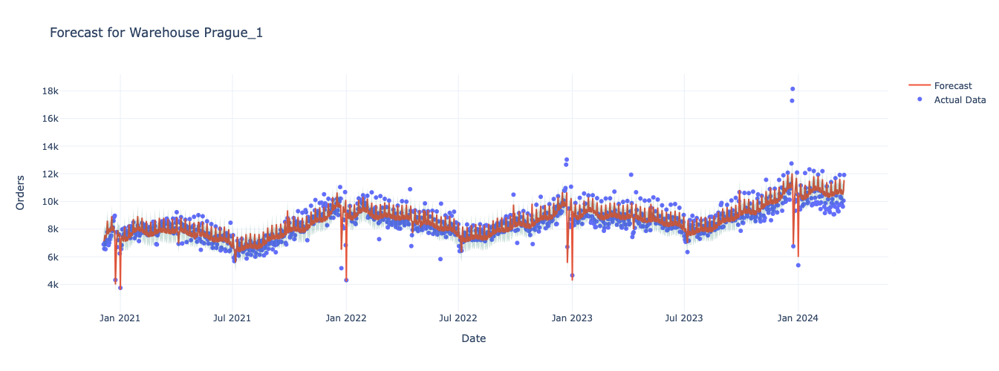

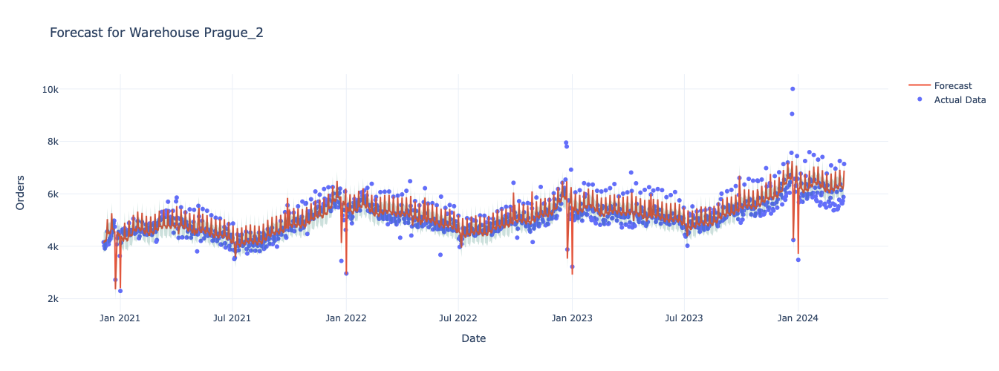

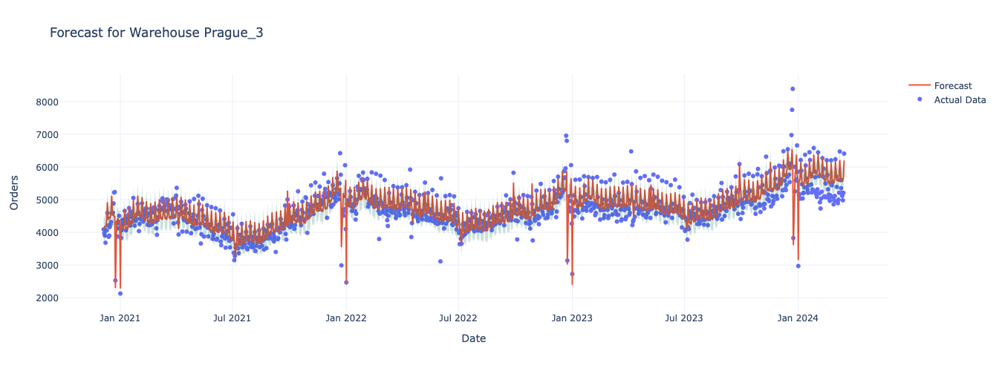

In [59]:
def plot_warehouse_pred_by_prophet(warehouse_to_plot: str):
    actual_data = df[df['warehouse'] == warehouse_to_plot].rename(columns={'date': 'ds', 'orders': 'y'})

    # Get the forecast for the specific warehouse
    forecast = forecasts[warehouse_to_plot]

    # Create an interactive plot using Plotly
    fig = go.Figure()

    # Add actual data points
    fig.add_trace(go.Scatter(
        x=np.array(actual_data['ds']),
        y=actual_data['y'],
        mode='markers',
        name='Actual Data'
    ))

    # Add the forecast line
    fig.add_trace(go.Scatter(
        x=np.array(actual_data['ds']),
        y=forecast['yhat'],
        mode='lines',
        name='Forecast'
    ))

    # Add the uncertainty intervals
    fig.add_trace(go.Scatter(
        x=np.array(actual_data['ds']),
        y=forecast['yhat_upper'],
        mode='lines',
        line=dict(width=0),
        name='Upper Bound',
        showlegend=False
    ))
    fig.add_trace(go.Scatter(
        x=np.array(actual_data['ds']),
        y=forecast['yhat_lower'],
        mode='lines',
        line=dict(width=0),
        fill='tonexty',
        fillcolor='rgba(0, 100, 80, 0.2)',
        name='Lower Bound',
        showlegend=False
    ))

    # Set plot title and labels
    fig.update_layout(
        height=500,
        title=f"Forecast for Warehouse {warehouse_to_plot}",
        xaxis_title="Date",
        yaxis_title="Orders",
        template="plotly_white"
    )

    # Show the interactive plot
    fig.show()

# plot_warehouse_pred_by_prophet('Frankfurt_1')
# plot_warehouse_pred_by_prophet('Prague_1')
for warehouse in warehouses:
    plot_warehouse_pred_by_prophet(warehouse)

## Long Short-Term Memory (LSTM) Networks

### Overview
Long Short-Term Memory (LSTM) is a type of recurrent neural network (RNN) designed to model sequential data. It is particularly suitable for time series forecasting tasks due to its ability to learn long-term dependencies and temporal patterns. Unlike traditional RNNs, LSTM introduces a gating mechanism to control the flow of information, addressing issues like the vanishing gradient problem, which can hinder learning in long sequences.

The LSTM cell is composed of the following gates:
1. **Forget Gate**: Decides which information to discard from the cell state.
   $$f_t = \sigma(W_f \cdot [h_{t-1}, x_t] + b_f)$$
2. **Input Gate**: Decides which information to update in the cell state.
   $$i_t = \sigma(W_i \cdot [h_{t-1}, x_t] + b_i)$$  
   $$\tilde{C}_t = \tanh(W_C \cdot [h_{t-1}, x_t] + b_C)$$
3. **Output Gate**: Determines the output of the LSTM cell.
   $$o_t = \sigma(W_o \cdot [h_{t-1}, x_t] + b_o)$$  
   $$h_t = o_t \cdot \tanh(C_t)$$

Here, $x_t$ is the input at time $t$, $h_t$ is the hidden state, and $C_t$ is the cell state. The gates are controlled by learned weights ($W$) and biases ($b$), and $\sigma$ represents the sigmoid activation function.

LSTMs are well-suited for this project because:
- **Trend Learning**: They can capture long-term trends in the data, such as year-over-year increases and seasonal patterns.
- **Seasonality and Weekly Patterns**: LSTMs can learn periodic behaviors like seasonal variations and weekly cycles (e.g., day-of-week effects).
- **Robustness to Nonlinearity**: LSTMs can handle nonlinear relationships in time series data, making them ideal for datasets with complex patterns.

### Input Requirements
To train an LSTM model, the input data must meet specific requirements:
1. **Normalization**: 
   - LSTM models perform better when the input features are normalized or scaled. For instance, using Min-Max Scaling or Standardization ensures all features have similar ranges, preventing dominance of larger-scaled features.
2. **Missing Values**:
   - Missing values should be handled before training, as LSTM does not inherently deal with missing data. Common approaches include interpolation or forward/backward filling.
3. **Time Steps**:
   - The input data must be structured into sequences. For example, to predict the next value in a series, we use a sliding window approach to create sequences of $n$-length past observations as input and the next value as the target.
4. **Features**:
   - The model can accept multiple features as input (e.g., date-derived features, holidays, external factors). These features should be appropriately preprocessed and aligned.

### Data Transformation
For this project:
- Normalize the `orders` column to scale its values.
- Handle missing data through interpolation or another imputation method.
- Transform the data into sequences using a sliding window (e.g., using the past 7 days to predict the next day).

In [62]:
device = 'cpu' # The LSTM is coputed sequentialy rather than in parallel, so there is no reason to copy data to the GPU

>As seen previusly, shutdowns are outliers that cannot be known in advance, and model will learn better the general pattern without them.

In [65]:
def remove_outliers(group: pd.DataFrame) -> pd.DataFrame:
    shutdown_columns = [col for col in group.columns if 'shutdown' in col]
    return group[group.apply(lambda row: (sum(row[shutdown_columns]) == 0), axis=1)]

>Before using LSTM it's good practice to apply normaliztion.

In [68]:
def minmax_normalize_orders(group: pd.DataFrame, group_min=None, group_max=None) -> pd.DataFrame:
    if group_min == None or group_max == None:
        epsilon = 1e-7
        group_min, group_max = group['orders'].min()-epsilon, group['orders'].max()+epsilon
    group = group.copy()
    group['orders_normalized'] = (group['orders'] - group_min) / (group_max - group_min)
    
    return group, group_min, group_max

>Extract importent time components

In [71]:
def add_time_components(group: pd.DataFrame) -> pd.DataFrame:
    group = group.copy()
    
    group['year'], group['month'], group['day'] = group.date.dt.year, group.date.dt.month, group.date.dt.day
    group['week_day'] = group.date.apply(lambda d: d.weekday()+1)
    group['year_week'] = group.date.apply(lambda d: int(d.strftime("%W")))
    
    # transform into implicit representition in the unit circle
    for column_name in ('week_day', 'year_week'):
        # Calculate the angles in radians
        max_value = group[column_name].max()
        angles = 2 * np.pi * group[column_name] / max_value

        # Create new features
        group[f'{column_name}_sin'] = np.sin(angles)
        group[f'{column_name}_cos'] = np.cos(angles)
    
    return group

>Add any missing holidays from the calendar tables.  
For the LSTM model, missing values are not allowed, so fill in missing orders using interpolation. This approach helps preserve the shape of the weekly pattern.

In [74]:
df_train_calender = pd.read_csv(FILES['train_calendar'])
df_train_calender['date'] = pd.to_datetime(df_train_calender['date'])
df_test_calender = pd.read_csv(FILES['test_calendar'])
df_test_calender['date'] = pd.to_datetime(df_test_calender['date'])
df_calender = pd.concat([df_train_calender, df_test_calender]).sort_values(by=['warehouse', 'date'])

def fill_and_interpolate_missing(group: pd.DataFrame, by_col='orders_normalized') -> pd.DataFrame:
    group = group.copy()
    # keep indicator which row is original and which is new
    group['was_missing'] = 0
    warehouse = group.warehouse.iloc[0]
    
    # Add rows for missing dates
    full_date_range = pd.date_range(start=group['date'].min(), end=group['date'].max())
    group.set_index('date', inplace=True)
    group = group.reindex(full_date_range)
    group.index.name = 'date'
    group.reset_index(inplace=True)
    group.sort_values(by='date', inplace=True)
    
    # fill missing
    group = add_time_components(group)
    group[by_col] = group[by_col].interpolate()
    group['was_missing'] = group['was_missing'].fillna(1)
    group['warehouse'] = warehouse
    group['id'] = group.date.apply(lambda d: f'{warehouse}_{str(d)[:-9]}')
    
    # update calender data for missing
    shared_columns = set(group.columns).intersection(df_calender.columns)
    shared_columns.difference_update({'warehouse', 'date'})
    group = pd.merge(group.drop(columns=list(shared_columns)),
                     df_calender,
                     how='left',
                     on=['warehouse', 'date'])
    
    numeric_cols = group.select_dtypes(include=[np.number]).columns
    group[numeric_cols] = group[numeric_cols].fillna(0)
    
    return group

>Create boolean indicators for meaningful holidays/dates

In [77]:
def add_holidays(group: pd.DataFrame) -> pd.DataFrame:
    importent_holidays = ['Christmas Eve', 
                        'New Years Day',
                        'Cyrila a Metode',
                        'Jan Hus',
                        'Den osvobozeni', 'Den ceske statnosti',
                        'Den vzniku samostatneho ceskoslovenskeho statu']
    
    group = group.copy()
    
    for holiday in importent_holidays:
        group[f'is_{holiday}'] = group.holiday_name.apply(lambda hn: 1 if hn == holiday else 0)
    
    group['is_day_before_christmas'] = group.apply(lambda row: int((row['day'] == 23) and (row['month'] == 12)), axis=1)
    group['is_day_after_christmas'] = group.apply(lambda row: int((row['day'] == 25) and (row['month'] == 12)), axis=1)
    
    return group

>As observed in the plots, there is a noticeable change in the data distribution around the trend.  
The standard deviation (STD) is not sufficiently accurate, as it may increase due to the steep slope of the trend.  
To address this, I introduced the mean distance from the trend. Since the model is designed to predict both the trend and the weekly pattern before combining them, the STD of the weekly pattern is influenced more by the mean distance from the trend than by the overall STD of the data, which is partially reflected in the trend.

In [80]:
def calculate_window_residuals(df, real_val_col, trend_col, window_size):
    """
    Calculate window residuals based on the difference between orders and trend.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        Input DataFrame containing 'orders' and 'trend' columns
    window_size : int
        Number of days to use for calculating mean residuals
    
    Returns:
    --------
    pandas.DataFrame
        DataFrame with an additional 'window_residual' column
    """
    # Create a copy of the DataFrame to avoid modifying the original
    result_df = df.copy()
    
    # Calculate the absolute difference between orders and trend
    result_df['raw_residual'] = np.abs(result_df[real_val_col] - result_df[trend_col])
    
    # Calculate the window mean of residuals
    window_residual = result_df['raw_residual'].rolling(window=window_size, min_periods=1).mean()
    
    return window_residual

def find_trend_by_window(df: pd.DataFrame, window: int, values_col='orders_normalized'):
    """
    Calculate trending metrics with proper padding at edges.
    
    Parameters:
    df: DataFrame with MultiIndex (warehouse, date) and 'orders' column
    window: integer window size for the moving average
    
    Returns:
    DataFrame with added trend and standard deviation columns
    """
    
    dfs = []
    for warehouse in df.warehouse.unique():
        group = df[df.warehouse == warehouse].copy()
        # Create a copy to avoid warnings
        group_copy = group.copy()
        
        # For the rolling mean, pad with mirror reflection of the data
        pad_size = window // 2
        orders_series = group_copy[values_col]
        
        # Create padded series for better edge handling
        padded_start = orders_series[:pad_size].iloc[::-1]  # Reverse first pad_size elements
        padded_end = orders_series[-pad_size:].iloc[::-1]   # Reverse last pad_size elements
        padded_series = pd.concat([padded_start, orders_series, padded_end])
        
        # Calculate SMA on padded data
        ord_sma = padded_series.rolling(window=window, center=True).mean()
        
        # Extract the relevant portion (removing padding)
        group_copy[f'trend_{window}'] = ord_sma[pad_size:-pad_size].values
        
        # For weekly std, pad with the mean of early/late values
        week_std = np.array(orders_series.rolling(window=7, min_periods=1).std())
        # Fill start with average of first available values
        start_std = week_std[7:14][~np.isnan(week_std[7:14])].mean()
        week_std[:7] = start_std
        group_copy['week_std'] = week_std
        
        # For monthly std, similar approach
        month_std = np.array(orders_series.rolling(window=30, min_periods=1).std())
        # Fill start with average of first available values
        start_month_std = month_std[30:60][~np.isnan(month_std[30:60])].mean()
        month_std[:30] = start_month_std
        group_copy['month_std'] = month_std
        
        # For monthly std, similar approach
        window_std = np.array(orders_series.rolling(window=window, min_periods=1).std())
        # Fill start with average of first available values
        start_window_std = window_std[window:2*window][~np.isnan(month_std[window:2*window])].mean()
        window_std[:30] = start_window_std
        group_copy[f'window_std_{window}'] = window_std
        
        #
        group_copy[f'window_residual_{window}'] = calculate_window_residuals(
            group_copy, values_col, f'trend_{window}', window)
        
        dfs.append(group_copy)
    
    return pd.concat(dfs)

### Model defenition

#### LSTM Net Definition

In [84]:
class LSTM(nn.Module):
    def __init__(self, input_size: int, hidden_size: int, num_layers: int):
        super(LSTM, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        
        self.lstm = nn.LSTM(
            input_size=input_size,
            hidden_size=hidden_size,
            num_layers=num_layers,
            batch_first=True
        )
        
        self.fc = nn.Linear(hidden_size, 1)
        
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # Initialize hidden state with zeros
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        
        # Forward propagate LSTM
        out, _ = self.lstm(x, (h0, c0))
        
        # Decode the hidden state of the last time step
        out = self.fc(out[:, -1, :])
        return out


class LSTMWithLayerNorm(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, layer_norm=True):
        super(LSTMWithLayerNorm, self).__init__()
        
        self.layer_norm = layer_norm
        if self.layer_norm:
            # Layer Normalization applied to input
            self.ln = nn.LayerNorm(input_size)
        
        # LSTM with optional layer normalization
        self.lstm = nn.LSTM(
            input_size=input_size,
            hidden_size=hidden_size,
            num_layers=num_layers,
            batch_first=True
        )
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        # Apply layer normalization
        if self.layer_norm:
            # LayerNorm can be applied directly without transposing
            x = self.ln(x)
        
        # Pass through LSTM
        lstm_out, _ = self.lstm(x)
        
        # Pass the last time step's output to the fully connected layer
        out = self.fc(lstm_out[:, -1, :])
        
        return out

#### Training Functions

In [87]:
def train_batch(model: nn.Module, 
                batch: Tuple[torch.Tensor, torch.Tensor],
                optimizer: torch.optim.Optimizer,
                criterion: nn.Module) -> float:
    """Train model on a single batch"""
    x, y = batch
    optimizer.zero_grad()
    
    # Forward pass
    y_pred = model(x)
    loss = criterion(y_pred.squeeze(), y)
    
    # Backward pass
    loss.backward()
    optimizer.step()
    
    return loss.item()

def train_epoch(model: nn.Module,
                train_loader: DataLoader,
                optimizer: torch.optim.Optimizer,
                criterion: nn.Module) -> float:
    """Train model for one epoch"""
    model.train()
    total_loss = 0
    for batch in train_loader:
        loss = train_batch(model, batch, optimizer, criterion)
        total_loss += loss
    return total_loss / len(train_loader)

def validate(model: nn.Module,
            val_loader: DataLoader,
            criterion: nn.Module,
            get_pred=False) -> float:
    """Validate model"""
    model.eval()
    total_loss = 0
    with torch.no_grad():
        for x, y in val_loader:
            y_pred = model(x)
            if get_pred:
                return y_pred
            
            loss = criterion(y_pred.squeeze(), y)
            total_loss += loss.item()
    return total_loss / len(val_loader)

>Create X as tensor in shape (B, L, F) - B observisions in batch, with L lags of F features, as an input for LSTM.

In [90]:
def create_lagged_matrix(data, time_steps):
    samples, features = data.shape
    lagged_data = []

    # Loop through the data, creating sequences of length 'time_steps'
    for i in range(samples - time_steps):
        lagged_data.append(data[i:i + time_steps])  # Create a window of 'time_steps'

    return np.array(lagged_data)

### Basic testing of LSTM

In [93]:
warehouse = 'Brno_1'
group = df[df.warehouse == warehouse].copy()
group = remove_outliers(group)

# a
group_full_date_range = pd.DataFrame(data={'date': pd.date_range(start=group['date'].min(), end=group['date'].max())})
group = pd.merge(group_full_date_range, group, how='left')
group_train, group_test = group.iloc[:-60], group.iloc[-60:]

group_train, group_min, group_max = minmax_normalize_orders(group_train)
group, _, _ = minmax_normalize_orders(group, group_min, group_max)

group = fill_and_interpolate_missing(group)
# group = add_time_components(group)
group = add_holidays(group)
group = find_trend_by_window(group, 91)
group = find_trend_by_window(group, 28)
group_train, group_test = group.iloc[:-60], group.iloc[-60:]

In [95]:
continues_cols = [
    'orders_normalized', 'trend_91', 'trend_28'
]

time_cycle_cols = [
    'week_day_sin', 'week_day_cos', 'year_week_sin', 'year_week_cos'
]

boolean_cols = [
    'winter_school_holidays', 'school_holidays',
    'is_Christmas Eve', 'is_New Years Day', 'is_Cyrila a Metode',
    'is_Jan Hus', 'is_Den osvobozeni', 'is_Den ceske statnosti',
    'is_Den vzniku samostatneho ceskoslovenskeho statu',
    'is_day_before_christmas', 'is_day_after_christmas'
]

pred_cols = continues_cols + time_cycle_cols + boolean_cols

In [97]:
data = group_train[pred_cols].copy().to_numpy()

# Define the number of time steps (lags)
time_steps = 60

# Transform the matrix
X = create_lagged_matrix(data, time_steps)
# Assuming 'orders_normalized' is the target variable
y = group_train['orders_normalized'].iloc[time_steps:].to_numpy()

In [99]:
from sklearn.model_selection import TimeSeriesSplit
from torch.utils.data import Dataset, DataLoader

>The chosen loss function for this task is **MSELoss**, as it is well-suited for regression models. Specifically, it aligns with the motivation behind our task: small deviations from the true value are not critical (e.g., a delivery person can handle a few extra orders within a short time, or delivering slightly fewer orders has minimal impact). However, large deviations could result in significant issues, such as lost sales or the need to recruit unnecessary additional staff.  

In [101]:
# Custom PyTorch Dataset for Time Series
class TimeSeriesDataset(Dataset):
    def __init__(self, x: np.ndarray, y: np.ndarray):
        self.x = x
        self.y = y

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx: int):
        return torch.tensor(self.x[idx], dtype=torch.float32), torch.tensor(self.y[idx], dtype=torch.float32)

# Function to perform TSCV training and validation
def run_tscv_training(model_class, X, y, n_splits=5, window_size=30, batch_size=32, epochs=10, lr=1e-3, device='cpu'):
    """
    Perform TSCV training and validation.
    
    Args:
        model_class: The model class (e.g., LSTM) to instantiate.
        X: Feature matrix of shape (samples, time_steps, features).
        y: Target vector of shape (samples,).
        n_splits: Number of TSCV splits.
        window_size: Window size for sequence modeling.
        batch_size: Batch size for DataLoader.
        epochs: Number of training epochs.
        lr: Learning rate for optimizer.
    
    Returns:
        fold_results: List of validation losses for each fold.
        final_model: The trained model after the last fold.
    """
    tscv = TimeSeriesSplit(n_splits=n_splits)
    fold_results = []
    train_loss_list = []
    final_model = None  # To store the final trained model
    
    # Initialize model, optimizer, and loss
    model = model_class(input_size=X.shape[2], output_size=1, hidden_size=128, num_layers=3).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=1e-6)
    criterion = nn.MSELoss()


    for fold, (train_idx, val_idx) in enumerate(tscv.split(X)):
        print(f"Fold {fold + 1}/{n_splits}")

        # Split data
        X_train, X_val = X[train_idx], X[val_idx]
        y_train, y_val = y[train_idx], y[val_idx]

        # Create Datasets and DataLoaders
        train_dataset = TimeSeriesDataset(X_train, y_train)
        val_dataset = TimeSeriesDataset(X_val, y_val)
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Training loop
        for epoch in range(epochs):
            train_loss = train_epoch(model, train_loader, optimizer, criterion)
            val_loss = validate(model, val_loader, criterion)
            print(f"Epoch {epoch + 1}/{epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}")

        # Store results for this fold
        train_loss_list.append(train_loss)
        fold_results.append(val_loss)

        # Save the model from the last fold
        final_model = model

    print(f"Average Validation Loss across folds: {np.mean(fold_results):.4f}")
    return fold_results, train_loss_list, final_model

In [103]:
# Split test set
X_train, X_validation = X[:-60], X[-60:]
y_train, y_validation = y[:-60], y[-60:]

In [105]:
# Assuming `LSTM` is your model class
results, train_loss_list, trained_model = run_tscv_training(
    model_class=LSTMWithLayerNorm,
    X=X_train,
    y=y_train,
    n_splits=10,
    window_size=60,
    batch_size=32,
    epochs=10,
    lr=1e-3
)

# Access the results
print(f"Validation Losses: {results}")
print(f"Trained Model: {trained_model}")


Fold 1/10
Epoch 1/10, Train Loss: 0.0579, Val Loss: 0.0026


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning:

Using a target size (torch.Size([1])) that is different to the input size (torch.Size([])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.



Epoch 2/10, Train Loss: 0.0140, Val Loss: 0.0044
Epoch 3/10, Train Loss: 0.0034, Val Loss: 0.0028
Epoch 4/10, Train Loss: 0.0076, Val Loss: 0.0026
Epoch 5/10, Train Loss: 0.0045, Val Loss: 0.0033
Epoch 6/10, Train Loss: 0.0035, Val Loss: 0.0039
Epoch 7/10, Train Loss: 0.0034, Val Loss: 0.0027
Epoch 8/10, Train Loss: 0.0027, Val Loss: 0.0023
Epoch 9/10, Train Loss: 0.0030, Val Loss: 0.0022
Epoch 10/10, Train Loss: 0.0025, Val Loss: 0.0023
Fold 2/10
Epoch 1/10, Train Loss: 0.0026, Val Loss: 0.0077
Epoch 2/10, Train Loss: 0.0024, Val Loss: 0.0112
Epoch 3/10, Train Loss: 0.0023, Val Loss: 0.0122
Epoch 4/10, Train Loss: 0.0021, Val Loss: 0.0124
Epoch 5/10, Train Loss: 0.0021, Val Loss: 0.0147
Epoch 6/10, Train Loss: 0.0020, Val Loss: 0.0159
Epoch 7/10, Train Loss: 0.0020, Val Loss: 0.0163
Epoch 8/10, Train Loss: 0.0020, Val Loss: 0.0171
Epoch 9/10, Train Loss: 0.0019, Val Loss: 0.0171
Epoch 10/10, Train Loss: 0.0019, Val Loss: 0.0170
Fold 3/10
Epoch 1/10, Train Loss: 0.0060, Val Loss: 0.017

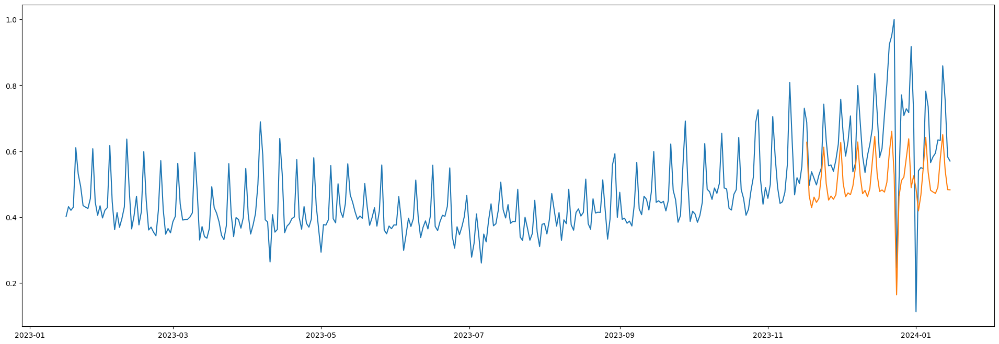

In [107]:
# Convert test set to torch tensors
X_validation_tensor = torch.tensor(X_validation, dtype=torch.float32).to(device)

# Make predictions
with torch.no_grad():
    test_predictions = trained_model(X_validation_tensor).cpu().numpy()
    test_predictions = test_predictions.flatten()

plt.figure(figsize=(24, 8))
plt.plot(group_train.date[-365:], group_train.orders_normalized[-365:])
plt.plot(group_train.date[-60:], test_predictions)
plt.show()

### Issues Observed:
1. **Failure to Capture Weekly Patterns or Trends**  
   Despite training and validation data being processed together, and the model only needing to predict the next day (as prior days in the test set are included in `X_test`), the LSTM model struggles to capture the weekly patterns or the underlying trend effectively.

2. **Discrepancy Between Train and Validation Loss**  
   In some training attempts, the train loss converges to a much lower value than the validation loss. This inconsistency suggests that luck plays a significant role, which is undesirable for a reliable predictive model.

3. **Underestimation of Trends**  
   Even with access to recent data, the model tends to underestimate the trend. A possible reason for this is the normalization, where the model might aim to predict values near the midpoint of the normalized range (0.5), rather than accurately following the trend.

---

### Conclusion:
This model structure is insufficient for the task and requires improvement to better capture patterns, ensure consistent performance, and reduce trend underestimation.

Here’s a rephrased version of your text with enhanced clarity and flow:

---

## More Complex Network Design

### Changes to Consider:

#### Time Feature Representation
1. **Day of the Week**  
   Replace the implicit representation of the day of the week with one-hot encoding, creating a separate boolean indicator for each day.

2. **Week of the Year**  
   Replace the implicit representation of the week of the year with a single column that calculates the distance from the approximate midpoint of the year (estimated as July 15).

---

#### Network Architecture
- **Hybrid Model**  
   Design a hybrid network combining:  
   - An LSTM module for continuous values (e.g., actual normalized values, trend, and moving residual).  
   - A Fully Connected Network (FCN) for categorical data.  
   - A second FCN to combine the outputs of the LSTM and FCN components into the final predictions.

---

#### Training Strategy
- **Increased Training Epochs**  
   Use more epochs per fold to allow parameters to converge more effectively, without altering the learning rate to maintain result precision.  
   
- **Smaller and More Folds**  
   Implement smaller, more numerous folds to better capture seasonal variations and improve learning.

---

#### Loss and Target Design
- **Dual Target (`y`)**  
   Define the target `y` as a combination of two values:  
   - The actual `orders_normalized` value.  
   - The `trend_91` value.  

   This approach aims to encourage the model to learn both the actual values and the underlying trend, optimizing parameters that represent the trend as well.

- **Benefits of Dual Targeting**  
   - **Overfitting Prevention**: By incorporating the general trend, the model is less likely to overfit to short-term fluctuations.  
   - **Long-Term Forecast Accuracy**: Since predictions extend 60 days into the future, deviations from the trend result in significantly higher loss, pushing the model to align closer with the trend.

In [111]:
def get_days_from_middle_of_summer(group):
    
    def days_away(row):
        year, this_dt = row['year'],row['date']
        val1 = abs((dt.datetime(year, 7, 15) - this_dt).days)
        val2 = abs((dt.datetime(year+1, 7, 15) - this_dt).days)
        val3 = abs((dt.datetime(year-1, 7, 15) - this_dt).days)
        normalized_val = min(val1, val2, val3)/183 -0.5
        normalized_val = torch.tanh(torch.tensor(normalized_val * 5))/2
        return normalized_val.item()
        
    group = group.copy()        
    
    group['days_from_middle_of_summer'] = group.apply(days_away, axis=1)
    
    return group

In [113]:
def one_hot_encoding_week_day(group: pd.DataFrame):
    group = group.copy()
    return pd.get_dummies(data=group, columns=['week_day'], prefix='is_day', dtype=int)

In [115]:
# group = df_prepared[df_prepared.warehouse == 'Brno_1']
# group = get_days_from_middle_of_summer(group)
# group = one_hot_encoding_week_day(group)

In [116]:
def next_values_by_linear_reggression(x_continuous):
    # Lags of the same day of the week: -7, -14, -21, -28
    lags = torch.tensor([-7, -14, -21, -28])

    # Step 1: Index the specific lags for feature 0
    # Shape after indexing: (N, 4)
    y_values =  torch.tensor(x_continuous[:, lags, 0]).clone().detach()

    # Step 2: Define x-values (time indices corresponding to the lags)
    x_values = torch.arange(1, len(lags) + 1, dtype=torch.float32)  # [1, 2, 3, 4]
    x_values = x_values.unsqueeze(0).repeat(x_continuous.shape[0], 1)  # Shape: (N, 4)

    # Step 3: Perform simple linear regression (solve for slope and intercept)
    x_mean = x_values.mean(dim=1, keepdim=True)
    y_mean = y_values.mean(dim=1, keepdim=True)

    # Calculate slope (m) and intercept (b)
    # print(f'{x_values.shape=}, {x_mean.shape=}\n{y_values.shape=}, {y_mean.shape=}, ')
    numerator = ((x_values - x_mean) * (y_values - y_mean)).sum(dim=1)
    denominator = ((x_values - x_mean) ** 2).sum(dim=1)
    slope = numerator / denominator  # Shape: (N,)
    intercept = y_mean.squeeze(1) - slope * x_mean.squeeze(1)  # Shape: (N,)

    # Step 4: Predict the next value (at x = 5, since x = [1, 2, 3, 4] are known)
    next_x = 5
    y_pred_next = slope * next_x + intercept  # Shape: (N,)
    return np.array(y_pred_next)

In [119]:
continues_cols = [
    # 'orders_normalized', 
    'trend_91', 'trend_28',
    'window_residual_91', 'window_residual_28', 'days_from_middle_of_summer'
]

additional_features_cols = [
    'is_day_1', 'is_day_2', 'is_day_3',
    'is_day_4', 'is_day_5', 'is_day_6', 'is_day_7',
    'winter_school_holidays', 'school_holidays',
    'is_Christmas Eve', 'is_New Years Day', 'is_Cyrila a Metode',
    'is_Jan Hus', 'is_Den osvobozeni', 'is_Den ceske statnosti',
    'is_Den vzniku samostatneho ceskoslovenskeho statu',
    'is_day_before_christmas', 'is_day_after_christmas'
]

def get_X_y(group: pd.DataFrame, time_steps=60):
    data_cont = group[['orders_normalized'] + continues_cols].copy().to_numpy()

    # Transform the matrix
    X_cont = create_lagged_matrix(data_cont, time_steps)
    same_week_day_regression = next_values_by_linear_reggression(X_cont[:,:,:1])
    X_cont = X_cont[:,:,1:].copy()
        
    X_additional = group[additional_features_cols].copy().iloc[time_steps:].to_numpy()
    y = group['orders_normalized'].iloc[time_steps:].to_numpy()
    
    return X_cont, X_additional, y, same_week_day_regression


def get_X_y(group: pd.DataFrame, time_steps=60):
    data_cont = group[['orders_normalized'] + continues_cols].copy().to_numpy()

    # Transform the matrix
    X_cont = create_lagged_matrix(data_cont, time_steps)
    same_week_day_regression = next_values_by_linear_reggression(X_cont[:,:,:1])
    X_cont = X_cont[:,:,1:].copy()
        
    X_additional = group[additional_features_cols].copy().iloc[time_steps:].to_numpy()
    y = group[['orders_normalized', 'trend_91']].iloc[time_steps:].to_numpy()
    
    return X_cont, X_additional, y, same_week_day_regression

In [121]:
class HybridTimeSeriesModel(nn.Module):
    def __init__(self, lstm_input_size, lstm_hidden_size, lstm_layers, 
                 additional_input_size, fc_hidden_size, output_size):
        super(HybridTimeSeriesModel, self).__init__()
        
        # LSTM for continuous time series
        self.lstm = nn.LSTM(input_size=lstm_input_size, 
                            hidden_size=lstm_hidden_size, 
                            num_layers=lstm_layers, 
                            batch_first=True)
        
        # FCN for additional data
        self.fc_categorical = nn.Sequential(
            nn.Linear(additional_input_size, fc_hidden_size),
            nn.ReLU(),
            nn.Linear(fc_hidden_size, fc_hidden_size),
            nn.ReLU(),
            nn.Linear(fc_hidden_size, fc_hidden_size),
            nn.Tanh(),
        )
        
        # Final FC layer to combine outputs
        self.fc_final = nn.Sequential(
            # nn.Linear(2 + lstm_hidden_size + fc_hidden_size, 128),
            nn.Linear(lstm_hidden_size + fc_hidden_size + additional_input_size + 1, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, output_size)
        )
        
        self.resid_index = continues_cols.index('window_residual_28')
        self.dfmos_index = continues_cols.index('days_from_middle_of_summer')
        self.residual_power = nn.Parameter(torch.tensor(0.5))
    
    def forward(self, x_continuous, x_categorical, same_week_day_regression):
        
        # Process LSTM for continuous inputs
        lstm_out, _ = self.lstm(x_continuous)  # shape: (batch, seq_len, hidden_size)
        lstm_out = lstm_out[:, -1, :]  # Take last time step output
        
        # Process FCN for categorical inputs
        cat_out = self.fc_categorical(x_categorical)
        
        #
        current_residual = x_continuous[:, -1, self.resid_index].unsqueeze(1)
        cat_out_mantitude = current_residual * self.residual_power
        
        cat_out = cat_out * cat_out_mantitude
        
        current_dfmos = x_continuous[:, -1, self.dfmos_index].unsqueeze(1)
        
        combined = torch.cat((lstm_out, cat_out, x_categorical, current_dfmos), dim=1)
        output = self.fc_final(combined)
        
        return output

In [123]:
class TimeSeriesDataset(Dataset):
    def __init__(self, x_cont: np.ndarray, x_add: np.ndarray, y: np.ndarray, same_day_val: np.ndarray):
        """
        Args:
            x: Input matrix of shape (samples, time_steps, features).
            y: Target vector of shape (samples,).
            continuous_cols_idx: Indices of continuous columns.
            categorical_cols_idx: Indices of categorical columns.
        """
        self.x_continuous = x_cont
        self.x_additional = x_add
        self.y = y
        self.same_day_val = same_day_val

    def __len__(self):
        return len(self.x_continuous)

    def __getitem__(self, idx: int):
        return (torch.tensor(self.x_continuous[idx], dtype=torch.float32), 
                torch.tensor(self.x_additional[idx], dtype=torch.float32),
                torch.tensor(self.y[idx], dtype=torch.float32),
                torch.tensor(self.same_day_val[idx], dtype=torch.float32))


In [125]:
def plot_pred(y_pred, y_test):
    y_pred = y_pred.flatten()
    # Plot the training data, actual test values, and predicted test values
    plt.figure(figsize=(24, 8))

    # Actual test values
    plt.plot(y_test, color='green', label='Actual Test Values')

    # Predicted values
    plt.plot(y_pred, color='orange', linestyle='--', label='Predicted Values')

    # Add titles, labels, and legend
    plt.title('Hybrid Time Series Model Predictions')
    plt.xlabel('Time Steps')
    plt.ylabel('Orders Normalized')
    plt.legend()
    plt.grid(True)
    plt.show()

In [126]:
def validate(model, val_loader, criterion, device):
    model.eval()
    val_loss = 0.0
    mape_loss = 0.0
    
    with torch.no_grad():
        for x_cont, x_cat, targets, sdr in val_loader:
            x_cont, x_cat, targets, sdr = x_cont.to(device), x_cat.to(device), targets.to(device), sdr.to(device)
            outputs = model(x_cont, x_cat, sdr).reshape_as(targets)
            loss = criterion(outputs, targets)
            val_loss += loss.item()
            
            # Ensure y_true is not zero (to avoid division by zero)
            targets = torch.clamp(targets, 1e-7)
            # Compute the absolute percentage error
            error = torch.abs((targets - outputs) / targets)
            # Compute mean and scale to percentage
            mape_loss += torch.mean(error) * 100
            
    return val_loss / len(val_loader), mape_loss / len(val_loader)

In [129]:
def run_tscv_training(model_class, X_cont: np.ndarray, X_add: np.ndarray,  y: np.ndarray, same_day_reg: np.ndarray,
                      n_splits=5, window_size=30, batch_size=32, epochs=20, lr=1e-3, device='cpu',
                     do_plot=False, do_print=True):
    tscv = TimeSeriesSplit(n_splits=n_splits)
    fold_results = []
    final_model = None
    
    model = model_class(lstm_input_size=X_cont.shape[-1],
                        lstm_hidden_size=128,
                        lstm_layers=3,
                        additional_input_size=X_add.shape[-1],
                        fc_hidden_size=64,
                        output_size=2
                       ).to(device)
    
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=1e-6)
    criterion = nn.MSELoss()
    
    for fold, (train_idx, val_idx) in enumerate(tscv.split(X_cont)):
        if do_print:
            print(f"Fold {fold + 1}/{n_splits}")
        
        if fold + 1 == n_splits:
            train_idx = np.append(train_idx, val_idx)
            val_idx = np.array([], dtype=int)
        
        X_cont_train, X_cont_val = X_cont[train_idx], X_cont[val_idx]
        X_add_train, X_add_val = X_add[train_idx], X_add[val_idx]
        y_train, y_val = y[train_idx], y[val_idx]
        same_day_reg_train, same_day_reg_val = same_day_reg[train_idx], same_day_reg[val_idx]
        
        train_dataset = TimeSeriesDataset(X_cont_train, X_add_train, y_train, same_day_reg_train)
        val_dataset = TimeSeriesDataset(X_cont_val, X_add_val, y_val, same_day_reg_val)
        
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        for epoch in range(epochs):
            model.train()
            total_loss = 0.0
            
            for x_cont, x_cat, targets, sdr in train_loader:
                x_cont, x_cat, targets, sdr = x_cont.to(device), x_cat.to(device), targets.to(device), sdr.to(device)
                
                optimizer.zero_grad()
                outputs = model(x_cont, x_cat, sdr)
                loss = criterion(outputs.squeeze(), targets)
                loss.backward()
                optimizer.step()
                total_loss += loss.item()
            
            if fold + 1 == n_splits:
                continue
            
            val_loss, mape_loss = validate(model, val_loader, criterion, device)
            if do_print and (epoch%5==0):
                print(f"Epoch {epoch+1}, Train Loss: {total_loss/len(train_loader):.4f}, Val Loss: {val_loss:.4f}, MAPE: {mape_loss:.2f}")
        
        if fold + 1 == n_splits:
            continue

        fold_results.append(val_loss)
        
        #######
        if do_plot and (fold%2==0):
            X_cont_val_tensor = torch.tensor(X_cont_val, dtype=torch.float32).to(device)  # Continuous part
            X_add_val_tensor = torch.tensor(X_add_val, dtype=torch.float32).to(device)  # Expand dimensions for categorical part
            sdr_tensor = torch.tensor(same_day_reg_val, dtype=torch.float32).to(device)

            # Make predictions using the trained model
            with torch.no_grad():
                model.eval()
                y_pred = model(X_cont_val_tensor, X_add_val_tensor, sdr_tensor).cpu().numpy()
                
            plot_pred(y_pred[:, 0], y_val[:, 0])
    
    final_model = model
    if do_print:
        print(f"Average Validation Loss: {np.mean(fold_results):.4f}")
    return fold_results, final_model

In [130]:
def add_new_dates(group: pd.DataFrame, n_days=60) -> pd.DataFrame:
    first_date = group['date'].max() + dt.timedelta(1)
    last_date  = first_date + dt.timedelta(59)
    new_dates  = pd.date_range(start=first_date, end=last_date)
    new_dates_df = pd.DataFrame(data={'date': new_dates})
    new_dates_df['warehouse'] = group['warehouse'].iloc[0]
    return pd.concat([group, new_dates_df])

In [131]:
def fill_holidays(group):
    warehouse = group['warehouse'].iloc[0]
    group['id'] = group.date.apply(lambda d: f'{warehouse}_{str(d)[:-9]}')
    
    # update calender data for missing
    shared_columns = set(group.columns).intersection(df_calender.columns)
    shared_columns.difference_update({'warehouse', 'date'})
    group = pd.merge(group.drop(columns=list(shared_columns)),
                     df_calender,
                     how='left',
                     on=['warehouse', 'date'])
    return group

In [135]:
def get_pred_val(X_cont, X_additional, sdr, trained_model: nn.Module):
    X_cont_test_tensor = torch.tensor(X_cont[-1:], dtype=torch.float32).to(device)  # Continuous part
    X_add_test_tensor = torch.tensor(X_additional[-1:], dtype=torch.float32).to(device)
    sdr_test_tensor = torch.tensor(sdr[-1:], dtype=torch.float32).to(device)
    
    with torch.no_grad():
        y_pred = trained_model(X_cont_test_tensor, X_add_test_tensor, sdr_test_tensor).cpu().numpy()
        y_pred = y_pred[:, 0].item()
    
    return y_pred

In [136]:
def single_row_trend_fill(group: pd.DataFrame, days_before: int, cols_idx: list):
    limited_group = group.iloc[:-days_before+1].copy()
    limited_group = find_trend_by_window(limited_group, 91)
    limited_group = find_trend_by_window(limited_group, 28)
    
    return limited_group.iloc[-days_before, cols_idx]

### Final LSTM process

In [140]:
def group_preprocessing(group: pd.DataFrame) -> pd.DataFrame:
    # known orders dates cleaning
    group = remove_outliers(group)
    group, group_min, group_max = minmax_normalize_orders(group)
    group = fill_and_interpolate_missing(group)
    
    return group, group_min, group_max

In [142]:
def full_data_processing(group: pd.DataFrame, add_days=True) -> pd.DataFrame:
    # known orders dates cleaning
    # group, group_min, group_max = minmax_normalize_orders(group)
    group = find_trend_by_window(group, 91)
    group = find_trend_by_window(group, 28)

    # adding the prediction dates
    if add_days:
        group = add_new_dates(group)

    # features engineering
    group = fill_holidays(group)
    group = add_time_components(group)
    group = add_holidays(group)
    group = get_days_from_middle_of_summer(group)
    group = one_hot_encoding_week_day(group)
    
    return group

def create_and_train_group_model(group: pd.DataFrame, do_plot=False, do_print=False) -> nn.Module:
    X_cont, X_additional, y, sdr = get_X_y(group)
    
    results, trained_model = run_tscv_training(
        model_class=HybridTimeSeriesModel,
        X_cont=X_cont,
        X_add=X_additional,
        y=y,
        same_day_reg=sdr,
        n_splits=10,
        window_size=60,
        batch_size=32,
        epochs=40,
        lr=1e-3,
        device=device,
        do_plot=do_plot,
        do_print=do_print
    )
    
    return trained_model

def make_prediction_for_group(group: pd.DataFrame, trained_model: nn.Module) -> np.ndarray:
    # Keep last days
    group = group.tail(160)
    group.reset_index(inplace=True, drop=True)

    for days_before in range(60, 0, -1):
        temp = group.iloc[:group.shape[0]-days_before+1]
        X_cont, X_additional, y, sdr = get_X_y(temp)

        new_orders_val = get_pred_val(X_cont, X_additional, sdr, trained_model)
        group.iloc[group.shape[0]-days_before, group.columns.get_loc('orders_normalized')] = new_orders_val
        if days_before==1:
            break

        cols_idx = [group.columns.get_loc(col) for col in continues_cols]
        pred_cols_update = single_row_trend_fill(group, days_before, cols_idx)
        group.iloc[group.shape[0]-days_before, cols_idx] = pred_cols_update

    # final_prediction = group[['date', 'orders_normalized']].iloc[-60:].copy()
    final_prediction = group.iloc[-60:].copy()
    return final_prediction

def full_data_processing_train_and_prediction(group: pd.DataFrame, do_plot=False, do_print=False):
    # known orders dates cleaning
    group = full_data_processing(group)

    # Train model
    group_no_new_dates = group.iloc[:-60].copy() 
    trained_model = create_and_train_group_model(group_no_new_dates, do_plot, do_print)
    
    # make prediction
    final_prediction = make_prediction_for_group(group, trained_model)
    
    return final_prediction, trained_model

In [144]:
def split_group_train_test(group: pd.DataFrame):
    group = remove_outliers(group)

    group_full_date_range = pd.DataFrame(data={'date': pd.date_range(start=group['date'].min(), end=group['date'].max())})
    group = pd.merge(group_full_date_range, group, how='left')
    group_train, group_test = group.iloc[:-60], group.iloc[-60:]

    group_train, group_min, group_max = minmax_normalize_orders(group_train)
    group_test, _, _ = minmax_normalize_orders(group_test, group_min, group_max)

    group_train = fill_and_interpolate_missing(group_train)
    group_test = fill_and_interpolate_missing(group_test)
    
    return group_train, group_test, group_min, group_max

>The prediction will be with 2 steps:
>1. Add the new rows:
    1. add next 60 days dates (with None in other columns).
    2. add the Holidays
    3. Add time features
2. For each new row:
    1. predict the next missing day value.
    2. Calculate values features (trend etc...).
    3. Continue to next row.

## Final and train prediction for all warehouses
I will train a model for each warehouse with TSCV and print *MSE* and the *Mean absolute percentage error* of the validation for each epoch, while ploting prediction and validation data values once i a two folds.<br>
Since we don't have a lot of history (3 and half years that act diffrently, while having an yearly pattern) I didn't used a validation at the last fold, but used all the data for training before the test.<br>
In the end I ploted the predicted values and the test data values (as they are normalized), and ploted in a second plot the prediction in the real scale, with the real test data and train data as history.

In [148]:
def remove_future_missing(group: pd.DataFrame, is_german=False):
    group = group[~((group['day'] == 25) & (group['month'] == 12) | (group.orders == 0))]
    if is_german:
        group = group[~(group['week_day'] == 7)]
    
    group = group.sort_values(by='date')
    return group

>collect final models, 60 days of test prediction and minmax values (the model except to get input that been normalized by this minmax values) into the `models` dict.

In [306]:
models = {}

### Brno_1 run

In [309]:
warehouse = 'Brno_1'
group = df[df.warehouse == warehouse].copy()
group_train, group_test, group_min, group_max = split_group_train_test(group)

Fold 1/10
Epoch 1, Train Loss: 0.0955, Val Loss: 0.0426, MAPE: 80.87
Epoch 6, Train Loss: 0.0066, Val Loss: 0.0085, MAPE: 34.13
Epoch 11, Train Loss: 0.0027, Val Loss: 0.0109, MAPE: 42.22
Epoch 16, Train Loss: 0.0022, Val Loss: 0.0075, MAPE: 34.98
Epoch 21, Train Loss: 0.0020, Val Loss: 0.0068, MAPE: 33.06
Epoch 26, Train Loss: 0.0018, Val Loss: 0.0063, MAPE: 31.65
Epoch 31, Train Loss: 0.0016, Val Loss: 0.0051, MAPE: 28.11
Epoch 36, Train Loss: 0.0014, Val Loss: 0.0030, MAPE: 20.43


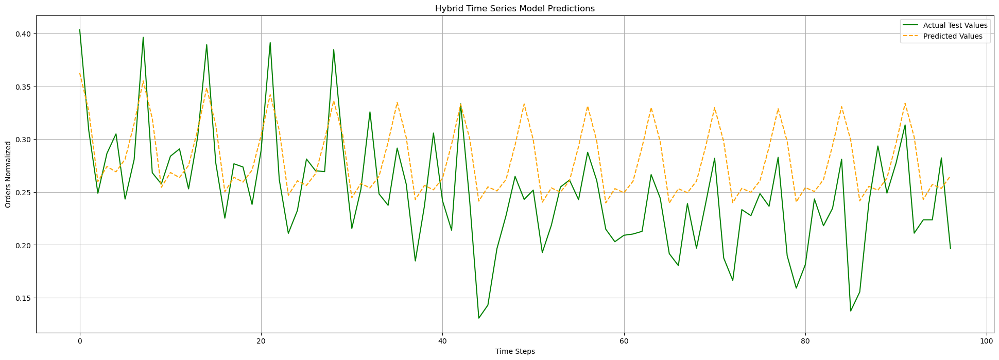

Fold 2/10
Epoch 1, Train Loss: 0.0014, Val Loss: 0.0122, MAPE: 24.37
Epoch 6, Train Loss: 0.0019, Val Loss: 0.0134, MAPE: 24.07
Epoch 11, Train Loss: 0.0009, Val Loss: 0.0079, MAPE: 19.23
Epoch 16, Train Loss: 0.0009, Val Loss: 0.0102, MAPE: 21.97
Epoch 21, Train Loss: 0.0009, Val Loss: 0.0075, MAPE: 18.61
Epoch 26, Train Loss: 0.0008, Val Loss: 0.0054, MAPE: 15.48
Epoch 31, Train Loss: 0.0010, Val Loss: 0.0079, MAPE: 18.93
Epoch 36, Train Loss: 0.0009, Val Loss: 0.0096, MAPE: 21.33
Fold 3/10
Epoch 1, Train Loss: 0.0018, Val Loss: 0.0056, MAPE: 15.13
Epoch 6, Train Loss: 0.0019, Val Loss: 0.0036, MAPE: 11.23
Epoch 11, Train Loss: 0.0022, Val Loss: 0.0037, MAPE: 11.84
Epoch 16, Train Loss: 0.0027, Val Loss: 0.0046, MAPE: 14.30
Epoch 21, Train Loss: 0.0027, Val Loss: 0.0049, MAPE: 14.99
Epoch 26, Train Loss: 0.0027, Val Loss: 0.0049, MAPE: 15.01
Epoch 31, Train Loss: 0.0018, Val Loss: 0.0041, MAPE: 12.80
Epoch 36, Train Loss: 0.0015, Val Loss: 0.0042, MAPE: 12.75


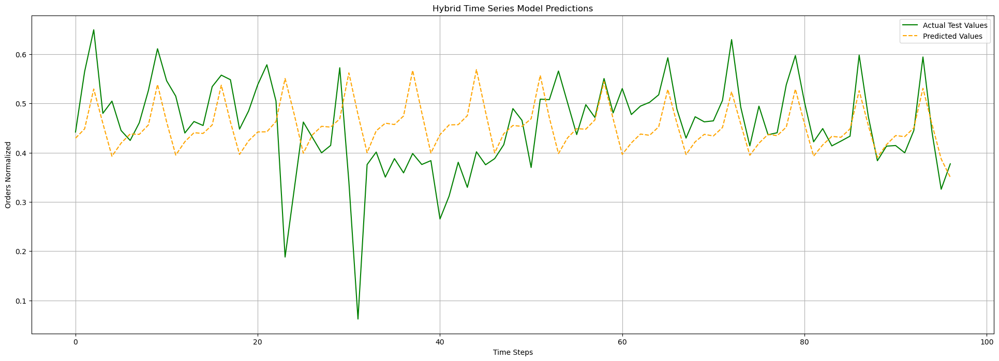

Fold 4/10
Epoch 1, Train Loss: 0.0030, Val Loss: 0.0015, MAPE: 8.32
Epoch 6, Train Loss: 0.0037, Val Loss: 0.0030, MAPE: 12.65
Epoch 11, Train Loss: 0.0037, Val Loss: 0.0016, MAPE: 8.77
Epoch 16, Train Loss: 0.0027, Val Loss: 0.0025, MAPE: 11.62
Epoch 21, Train Loss: 0.0031, Val Loss: 0.0018, MAPE: 9.62
Epoch 26, Train Loss: 0.0023, Val Loss: 0.0018, MAPE: 9.49
Epoch 31, Train Loss: 0.0029, Val Loss: 0.0034, MAPE: 13.89
Epoch 36, Train Loss: 0.0027, Val Loss: 0.0019, MAPE: 9.99
Fold 5/10
Epoch 1, Train Loss: 0.0020, Val Loss: 0.0019, MAPE: 9.21
Epoch 6, Train Loss: 0.0026, Val Loss: 0.0010, MAPE: 6.25
Epoch 11, Train Loss: 0.0024, Val Loss: 0.0012, MAPE: 6.85
Epoch 16, Train Loss: 0.0031, Val Loss: 0.0009, MAPE: 6.47
Epoch 21, Train Loss: 0.0015, Val Loss: 0.0019, MAPE: 10.20
Epoch 26, Train Loss: 0.0011, Val Loss: 0.0021, MAPE: 10.74
Epoch 31, Train Loss: 0.0016, Val Loss: 0.0029, MAPE: 13.50
Epoch 36, Train Loss: 0.0010, Val Loss: 0.0008, MAPE: 5.62


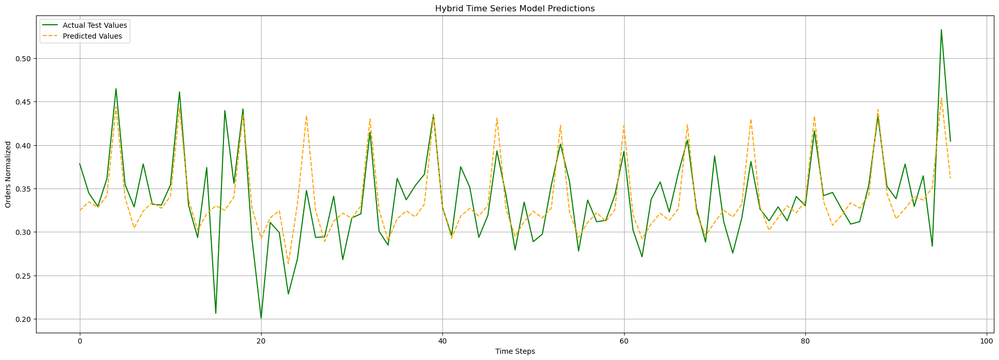

Fold 6/10
Epoch 1, Train Loss: 0.0011, Val Loss: 0.0041, MAPE: 13.83
Epoch 6, Train Loss: 0.0014, Val Loss: 0.0084, MAPE: 19.93
Epoch 11, Train Loss: 0.0050, Val Loss: 0.0118, MAPE: 22.41
Epoch 16, Train Loss: 0.0045, Val Loss: 0.0085, MAPE: 19.45
Epoch 21, Train Loss: 0.0039, Val Loss: 0.0047, MAPE: 13.19
Epoch 26, Train Loss: 0.0037, Val Loss: 0.0039, MAPE: 11.82
Epoch 31, Train Loss: 0.0028, Val Loss: 0.0040, MAPE: 12.42
Epoch 36, Train Loss: 0.0028, Val Loss: 0.0034, MAPE: 11.79
Fold 7/10
Epoch 1, Train Loss: 0.0033, Val Loss: 0.0053, MAPE: 15.56
Epoch 6, Train Loss: 0.0031, Val Loss: 0.0040, MAPE: 13.11
Epoch 11, Train Loss: 0.0030, Val Loss: 0.0037, MAPE: 12.46
Epoch 16, Train Loss: 0.0029, Val Loss: 0.0036, MAPE: 12.17
Epoch 21, Train Loss: 0.0029, Val Loss: 0.0035, MAPE: 11.97
Epoch 26, Train Loss: 0.0029, Val Loss: 0.0035, MAPE: 11.92
Epoch 31, Train Loss: 0.0028, Val Loss: 0.0034, MAPE: 11.69
Epoch 36, Train Loss: 0.0028, Val Loss: 0.0034, MAPE: 11.61


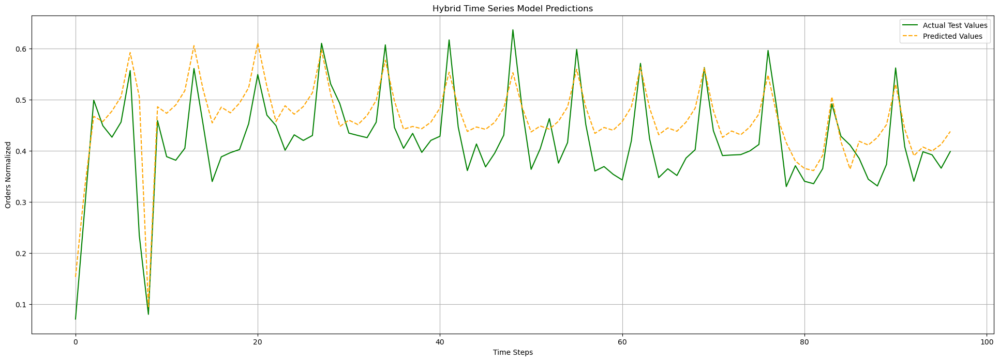

Fold 8/10
Epoch 1, Train Loss: 0.0029, Val Loss: 0.0054, MAPE: 16.01
Epoch 6, Train Loss: 0.0029, Val Loss: 0.0036, MAPE: 12.62
Epoch 11, Train Loss: 0.0028, Val Loss: 0.0038, MAPE: 12.85
Epoch 16, Train Loss: 0.0028, Val Loss: 0.0039, MAPE: 13.07
Epoch 21, Train Loss: 0.0027, Val Loss: 0.0039, MAPE: 13.21
Epoch 26, Train Loss: 0.0027, Val Loss: 0.0040, MAPE: 13.34
Epoch 31, Train Loss: 0.0027, Val Loss: 0.0040, MAPE: 13.41
Epoch 36, Train Loss: 0.0027, Val Loss: 0.0040, MAPE: 13.50
Fold 9/10
Epoch 1, Train Loss: 0.0029, Val Loss: 0.0099, MAPE: 20.85
Epoch 6, Train Loss: 0.0029, Val Loss: 0.0095, MAPE: 20.30
Epoch 11, Train Loss: 0.0028, Val Loss: 0.0093, MAPE: 20.03
Epoch 16, Train Loss: 0.0028, Val Loss: 0.0092, MAPE: 19.93
Epoch 21, Train Loss: 0.0028, Val Loss: 0.0092, MAPE: 19.95
Epoch 26, Train Loss: 0.0028, Val Loss: 0.0091, MAPE: 19.84
Epoch 31, Train Loss: 0.0028, Val Loss: 0.0092, MAPE: 19.92
Epoch 36, Train Loss: 0.0028, Val Loss: 0.0091, MAPE: 19.88


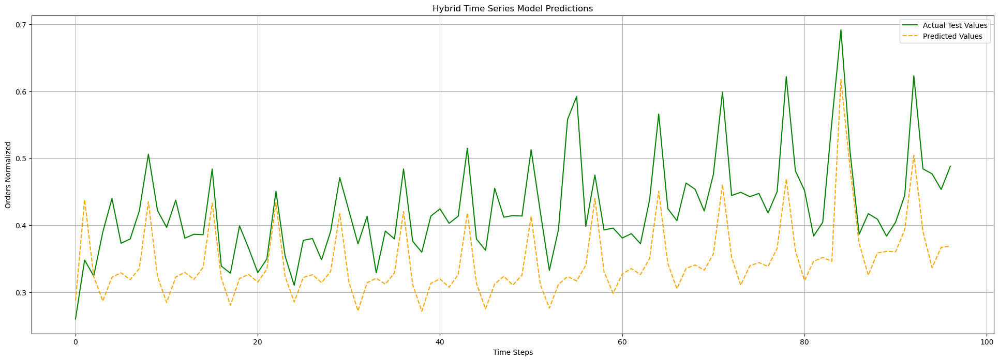

Fold 10/10
Average Validation Loss: 0.0039


In [311]:
final_prediction, trained_model = full_data_processing_train_and_prediction(group_train, True, True)

In [312]:
final_prediction['orders_unnormalized'] = final_prediction.orders_normalized * (group_max - group_min) + group_min
final_prediction = add_time_components(final_prediction)
final_prediction_filter = remove_future_missing(final_prediction)
models[warehouse] = {'model': trained_model, 'minmax': (group_min, group_max), 'final_prediction': final_prediction}

In [313]:
targets = group_test.orders_normalized.values
outputs = final_prediction.orders_normalized.values

# Compute the absolute percentage error
error = np.abs((targets - outputs) / targets)
# Compute mean and scale to percentage
mape_loss = np.mean(error) * 100

mape_loss

16.15846509246019

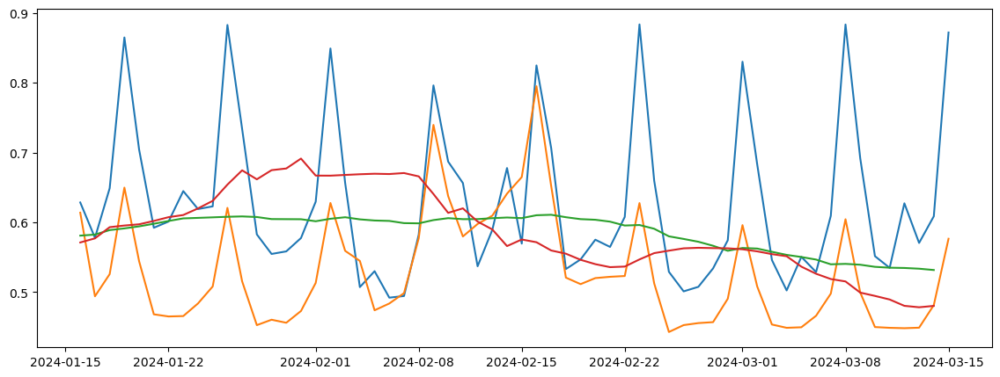

In [314]:
plt.figure(figsize=(14, 5))
plt.plot(group_test.date, group_test.orders_normalized)
plt.plot(final_prediction.date, final_prediction.orders_normalized)
plt.plot(final_prediction.date, final_prediction.trend_91)
plt.plot(final_prediction.date, final_prediction.trend_28)
plt.show()

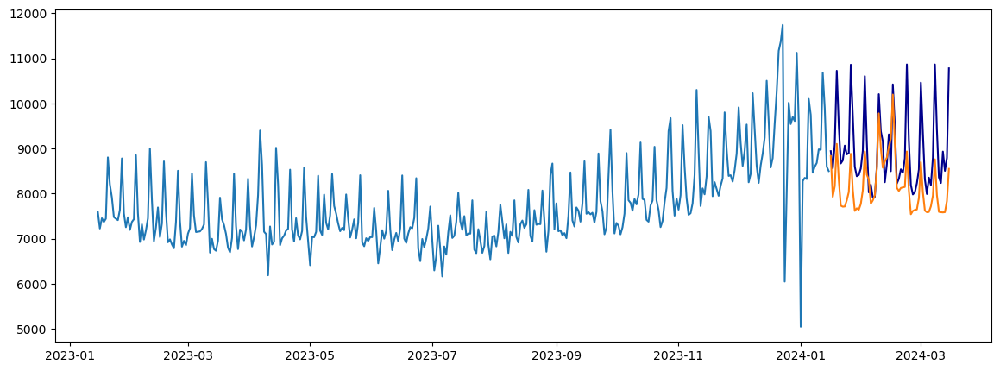

In [315]:
group_train_filter = remove_future_missing(group_train)
group_test_filter = remove_future_missing(group_test)

plt.figure(figsize=(14, 5))
plt.plot(group_train_filter.date[-365:], group_train_filter.orders[-365:])
plt.plot(group_test_filter.date, group_test_filter.orders, c='darkblue')
plt.plot(final_prediction_filter.date, final_prediction_filter.orders_unnormalized)

### Budapest_1 run

In [322]:
warehouse = 'Budapest_1'
group = df[df.warehouse == warehouse].copy()
group_train, group_test, group_min, group_max = split_group_train_test(group)

Fold 1/10
Epoch 1, Train Loss: 0.1002, Val Loss: 0.0475, MAPE: 154.17
Epoch 6, Train Loss: 0.0053, Val Loss: 0.0031, MAPE: 40.91
Epoch 11, Train Loss: 0.0021, Val Loss: 0.0067, MAPE: 61.78
Epoch 16, Train Loss: 0.0018, Val Loss: 0.0067, MAPE: 62.32
Epoch 21, Train Loss: 0.0017, Val Loss: 0.0060, MAPE: 58.89
Epoch 26, Train Loss: 0.0017, Val Loss: 0.0056, MAPE: 56.89
Epoch 31, Train Loss: 0.0017, Val Loss: 0.0055, MAPE: 56.27
Epoch 36, Train Loss: 0.0016, Val Loss: 0.0054, MAPE: 55.93


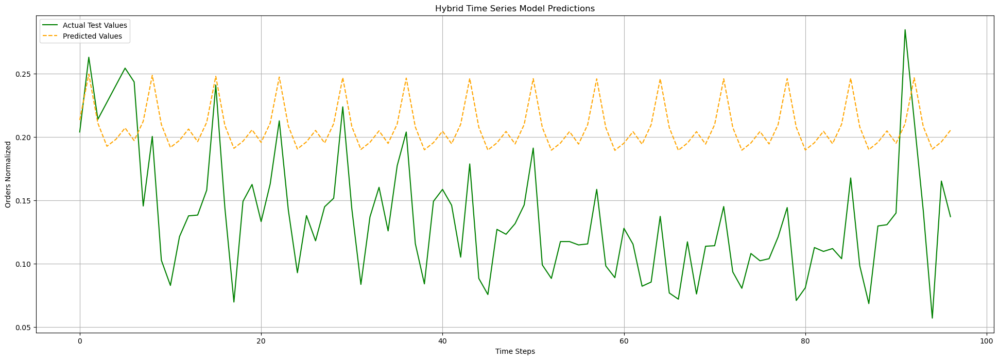

Fold 2/10
Epoch 1, Train Loss: 0.0029, Val Loss: 0.0223, MAPE: 40.15
Epoch 6, Train Loss: 0.0019, Val Loss: 0.0112, MAPE: 30.12
Epoch 11, Train Loss: 0.0023, Val Loss: 0.0186, MAPE: 36.71
Epoch 16, Train Loss: 0.0022, Val Loss: 0.0138, MAPE: 31.40
Epoch 21, Train Loss: 0.0020, Val Loss: 0.0117, MAPE: 29.00
Epoch 26, Train Loss: 0.0019, Val Loss: 0.0097, MAPE: 26.62
Epoch 31, Train Loss: 0.0016, Val Loss: 0.0084, MAPE: 25.04
Epoch 36, Train Loss: 0.0014, Val Loss: 0.0086, MAPE: 25.96
Fold 3/10
Epoch 1, Train Loss: 0.0029, Val Loss: 0.0042, MAPE: 17.67
Epoch 6, Train Loss: 0.0046, Val Loss: 0.0099, MAPE: 27.99
Epoch 11, Train Loss: 0.0038, Val Loss: 0.0060, MAPE: 21.60
Epoch 16, Train Loss: 0.0036, Val Loss: 0.0052, MAPE: 20.06
Epoch 21, Train Loss: 0.0035, Val Loss: 0.0045, MAPE: 18.51
Epoch 26, Train Loss: 0.0035, Val Loss: 0.0048, MAPE: 19.23
Epoch 31, Train Loss: 0.0033, Val Loss: 0.0050, MAPE: 19.54
Epoch 36, Train Loss: 0.0035, Val Loss: 0.0056, MAPE: 20.92


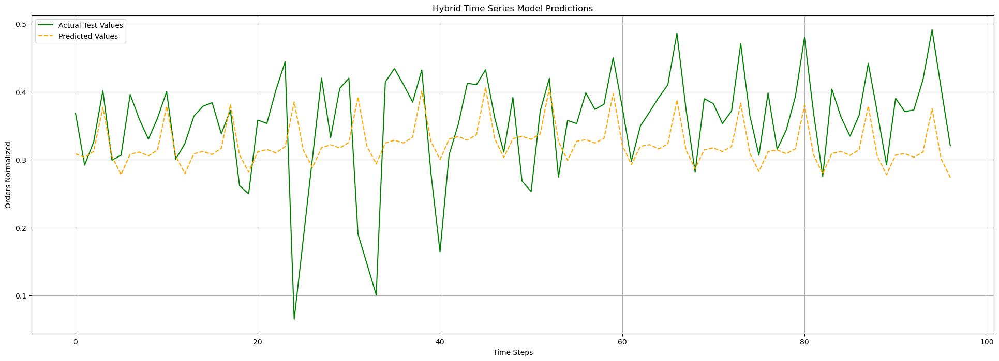

Fold 4/10
Epoch 1, Train Loss: 0.0034, Val Loss: 0.0100, MAPE: 22.79
Epoch 6, Train Loss: 0.0078, Val Loss: 0.0162, MAPE: 31.53
Epoch 11, Train Loss: 0.0039, Val Loss: 0.0124, MAPE: 26.45
Epoch 16, Train Loss: 0.0037, Val Loss: 0.0116, MAPE: 25.33
Epoch 21, Train Loss: 0.0036, Val Loss: 0.0106, MAPE: 23.97
Epoch 26, Train Loss: 0.0035, Val Loss: 0.0092, MAPE: 21.67
Epoch 31, Train Loss: 0.0028, Val Loss: 0.0065, MAPE: 16.77
Epoch 36, Train Loss: 0.0037, Val Loss: 0.0111, MAPE: 24.71
Fold 5/10
Epoch 1, Train Loss: 0.0046, Val Loss: 0.0019, MAPE: 12.30
Epoch 6, Train Loss: 0.0072, Val Loss: 0.0054, MAPE: 21.78
Epoch 11, Train Loss: 0.0052, Val Loss: 0.0025, MAPE: 14.14
Epoch 16, Train Loss: 0.0022, Val Loss: 0.0014, MAPE: 9.51
Epoch 21, Train Loss: 0.0019, Val Loss: 0.0011, MAPE: 8.55
Epoch 26, Train Loss: 0.0021, Val Loss: 0.0016, MAPE: 11.37
Epoch 31, Train Loss: 0.0021, Val Loss: 0.0019, MAPE: 12.49
Epoch 36, Train Loss: 0.0021, Val Loss: 0.0011, MAPE: 9.01


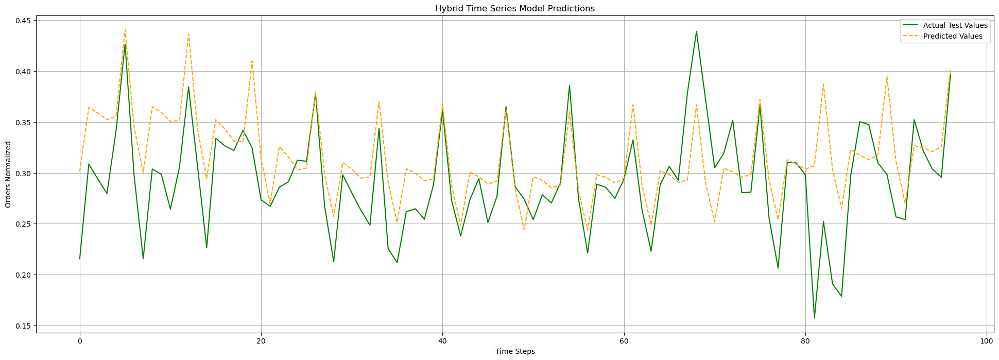

Fold 6/10
Epoch 1, Train Loss: 0.0018, Val Loss: 0.0098, MAPE: 14.46
Epoch 6, Train Loss: 0.0018, Val Loss: 0.0090, MAPE: 14.49
Epoch 11, Train Loss: 0.0015, Val Loss: 0.0098, MAPE: 11.84
Epoch 16, Train Loss: 0.0019, Val Loss: 0.0153, MAPE: 18.07
Epoch 21, Train Loss: 0.0016, Val Loss: 0.0138, MAPE: 16.18
Epoch 26, Train Loss: 0.0016, Val Loss: 0.0113, MAPE: 11.59
Epoch 31, Train Loss: 0.0040, Val Loss: 0.0082, MAPE: 16.80
Epoch 36, Train Loss: 0.0029, Val Loss: 0.0149, MAPE: 18.82
Fold 7/10
Epoch 1, Train Loss: 0.0026, Val Loss: 0.0016, MAPE: 6.73
Epoch 6, Train Loss: 0.0018, Val Loss: 0.0023, MAPE: 8.23
Epoch 11, Train Loss: 0.0014, Val Loss: 0.0014, MAPE: 6.28
Epoch 16, Train Loss: 0.0016, Val Loss: 0.0016, MAPE: 6.57
Epoch 21, Train Loss: 0.0014, Val Loss: 0.0015, MAPE: 6.35
Epoch 26, Train Loss: 0.0018, Val Loss: 0.0016, MAPE: 6.47
Epoch 31, Train Loss: 0.0014, Val Loss: 0.0014, MAPE: 5.84
Epoch 36, Train Loss: 0.0019, Val Loss: 0.0015, MAPE: 6.42


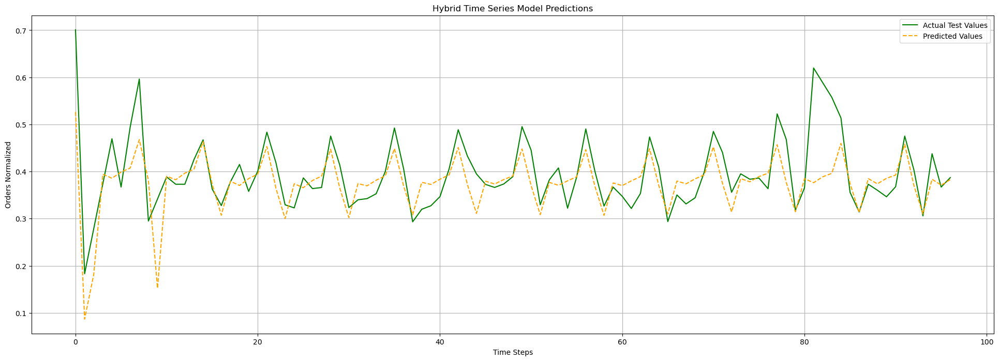

Fold 8/10
Epoch 1, Train Loss: 0.0016, Val Loss: 0.0069, MAPE: 16.56
Epoch 6, Train Loss: 0.0016, Val Loss: 0.0058, MAPE: 14.87
Epoch 11, Train Loss: 0.0024, Val Loss: 0.0047, MAPE: 12.46
Epoch 16, Train Loss: 0.0020, Val Loss: 0.0034, MAPE: 9.82
Epoch 21, Train Loss: 0.0023, Val Loss: 0.0020, MAPE: 5.58
Epoch 26, Train Loss: 0.0039, Val Loss: 0.0038, MAPE: 10.48
Epoch 31, Train Loss: 0.0015, Val Loss: 0.0028, MAPE: 7.87
Epoch 36, Train Loss: 0.0021, Val Loss: 0.0032, MAPE: 8.88
Fold 9/10
Epoch 1, Train Loss: 0.0018, Val Loss: 0.0018, MAPE: 8.41
Epoch 6, Train Loss: 0.0029, Val Loss: 0.0022, MAPE: 9.16
Epoch 11, Train Loss: 0.0024, Val Loss: 0.0022, MAPE: 9.22
Epoch 16, Train Loss: 0.0017, Val Loss: 0.0015, MAPE: 7.60
Epoch 21, Train Loss: 0.0017, Val Loss: 0.0008, MAPE: 5.27
Epoch 26, Train Loss: 0.0020, Val Loss: 0.0014, MAPE: 7.20
Epoch 31, Train Loss: 0.0023, Val Loss: 0.0010, MAPE: 5.86
Epoch 36, Train Loss: 0.0015, Val Loss: 0.0007, MAPE: 4.80


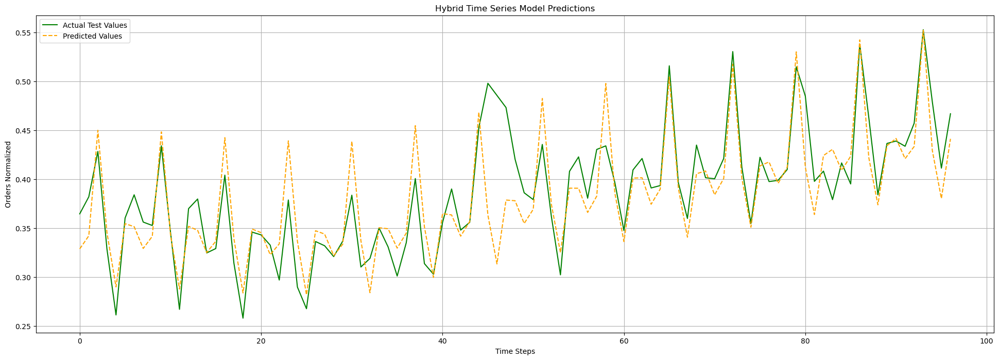

Fold 10/10
Average Validation Loss: 0.0058


In [323]:
final_prediction, trained_model = full_data_processing_train_and_prediction(group_train, True, True)

In [325]:
final_prediction['orders_unnormalized'] = final_prediction.orders_normalized * (group_max - group_min) + group_min
final_prediction = add_time_components(final_prediction)
final_prediction_filter = remove_future_missing(final_prediction)
models[warehouse] = {'model': trained_model, 'minmax': (group_min, group_max), 'final_prediction': final_prediction}

In [326]:
targets = group_test.orders_normalized.values
outputs = final_prediction.orders_normalized.values

# Compute the absolute percentage error
error = np.abs((targets - outputs) / targets)
# Compute mean and scale to percentage
mape_loss = np.mean(error) * 100

mape_loss

9.281316819970337

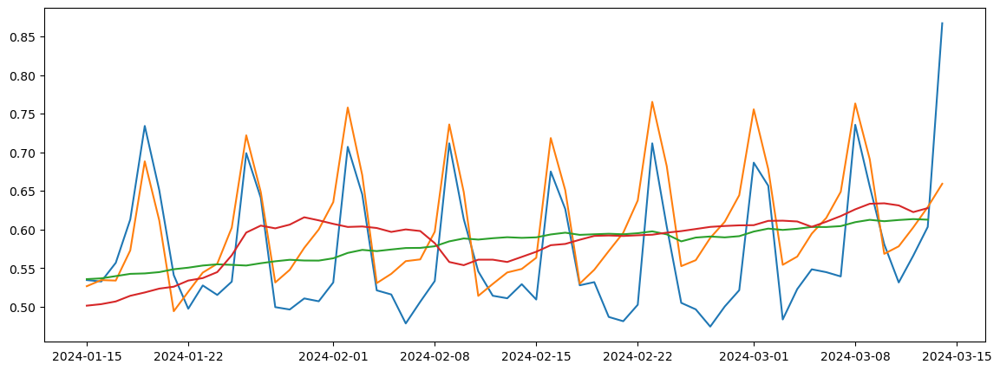

In [327]:
plt.figure(figsize=(14, 5))
plt.plot(group_test.date, group_test.orders_normalized)
plt.plot(final_prediction.date, final_prediction.orders_normalized)
plt.plot(final_prediction.date, final_prediction.trend_91)
plt.plot(final_prediction.date, final_prediction.trend_28)
plt.show()

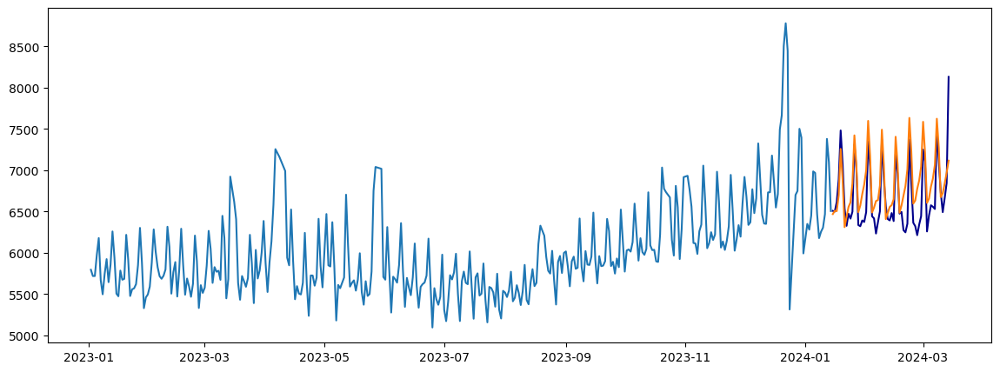

In [328]:
group_train_filter = remove_future_missing(group_train)
group_test_filter = remove_future_missing(group_test)

plt.figure(figsize=(14, 5))
plt.plot(group_train_filter.date[-365:], group_train_filter.orders[-365:])
plt.plot(group_test_filter.date, group_test_filter.orders, c='darkblue')
plt.plot(final_prediction_filter.date, final_prediction_filter.orders_unnormalized)

### Frankfurt_1 run

In [330]:
warehouse = 'Frankfurt_1'
group = df[df.warehouse == warehouse].copy()
group_train, group_test, group_min, group_max = split_group_train_test(group)

Fold 1/10
Epoch 1, Train Loss: 0.0577, Val Loss: 0.0839, MAPE: 79.15
Epoch 6, Train Loss: 0.0087, Val Loss: 0.0053, MAPE: 12.71
Epoch 11, Train Loss: 0.0036, Val Loss: 0.0050, MAPE: 16.30
Epoch 16, Train Loss: 0.0037, Val Loss: 0.0067, MAPE: 20.00
Epoch 21, Train Loss: 0.0036, Val Loss: 0.0054, MAPE: 17.29
Epoch 26, Train Loss: 0.0034, Val Loss: 0.0056, MAPE: 18.12
Epoch 31, Train Loss: 0.0031, Val Loss: 0.0042, MAPE: 15.35
Epoch 36, Train Loss: 0.0018, Val Loss: 0.0025, MAPE: 11.73


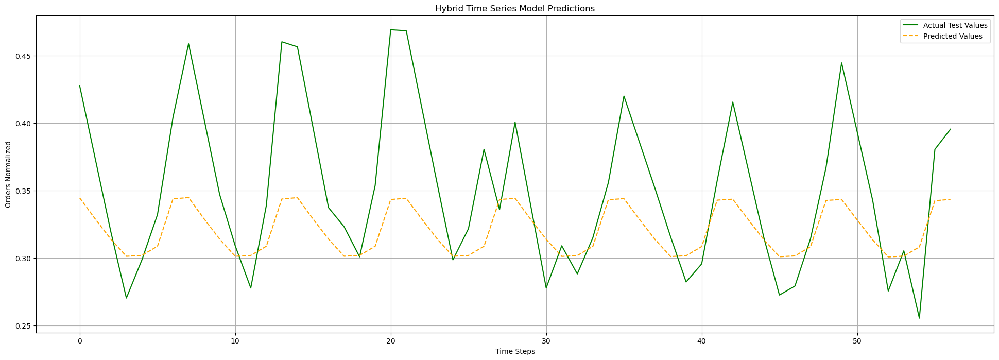

Fold 2/10
Epoch 1, Train Loss: 0.0019, Val Loss: 0.0073, MAPE: 15.28
Epoch 6, Train Loss: 0.0015, Val Loss: 0.0059, MAPE: 13.95
Epoch 11, Train Loss: 0.0010, Val Loss: 0.0054, MAPE: 11.90
Epoch 16, Train Loss: 0.0009, Val Loss: 0.0052, MAPE: 11.50
Epoch 21, Train Loss: 0.0009, Val Loss: 0.0051, MAPE: 11.49
Epoch 26, Train Loss: 0.0009, Val Loss: 0.0051, MAPE: 11.38
Epoch 31, Train Loss: 0.0009, Val Loss: 0.0050, MAPE: 11.36
Epoch 36, Train Loss: 0.0009, Val Loss: 0.0050, MAPE: 11.32
Fold 3/10
Epoch 1, Train Loss: 0.0024, Val Loss: 0.0202, MAPE: 32.60
Epoch 6, Train Loss: 0.0035, Val Loss: 0.0021, MAPE: 11.52
Epoch 11, Train Loss: 0.0026, Val Loss: 0.0025, MAPE: 12.59
Epoch 16, Train Loss: 0.0025, Val Loss: 0.0027, MAPE: 13.21
Epoch 21, Train Loss: 0.0023, Val Loss: 0.0033, MAPE: 14.92
Epoch 26, Train Loss: 0.0022, Val Loss: 0.0076, MAPE: 19.18
Epoch 31, Train Loss: 0.0020, Val Loss: 0.0121, MAPE: 23.47
Epoch 36, Train Loss: 0.0019, Val Loss: 0.0129, MAPE: 24.82


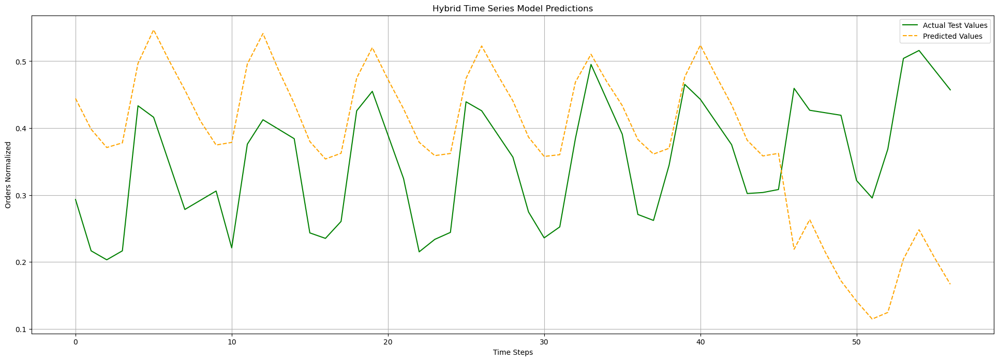

Fold 4/10
Epoch 1, Train Loss: 0.0061, Val Loss: 0.0393, MAPE: 43.41
Epoch 6, Train Loss: 0.0035, Val Loss: 0.0138, MAPE: 25.05
Epoch 11, Train Loss: 0.0030, Val Loss: 0.0091, MAPE: 19.70
Epoch 16, Train Loss: 0.0042, Val Loss: 0.0198, MAPE: 30.76
Epoch 21, Train Loss: 0.0042, Val Loss: 0.0049, MAPE: 12.71
Epoch 26, Train Loss: 0.0046, Val Loss: 0.0060, MAPE: 14.80
Epoch 31, Train Loss: 0.0045, Val Loss: 0.0061, MAPE: 14.84
Epoch 36, Train Loss: 0.0045, Val Loss: 0.0061, MAPE: 14.76
Fold 5/10
Epoch 1, Train Loss: 0.0047, Val Loss: 0.0022, MAPE: 9.44
Epoch 6, Train Loss: 0.0045, Val Loss: 0.0019, MAPE: 8.76
Epoch 11, Train Loss: 0.0041, Val Loss: 0.0010, MAPE: 6.09
Epoch 16, Train Loss: 0.0073, Val Loss: 0.0042, MAPE: 13.68
Epoch 21, Train Loss: 0.0041, Val Loss: 0.0018, MAPE: 8.43
Epoch 26, Train Loss: 0.0041, Val Loss: 0.0018, MAPE: 8.38
Epoch 31, Train Loss: 0.0039, Val Loss: 0.0018, MAPE: 8.34
Epoch 36, Train Loss: 0.0041, Val Loss: 0.0015, MAPE: 7.56


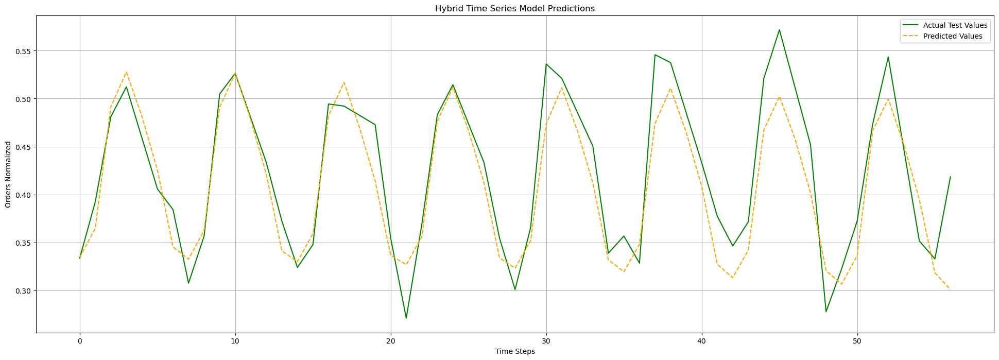

Fold 6/10
Epoch 1, Train Loss: 0.0036, Val Loss: 0.0187, MAPE: 24.43
Epoch 6, Train Loss: 0.0034, Val Loss: 0.0159, MAPE: 22.17
Epoch 11, Train Loss: 0.0024, Val Loss: 0.0152, MAPE: 21.23
Epoch 16, Train Loss: 0.0039, Val Loss: 0.0144, MAPE: 20.36
Epoch 21, Train Loss: 0.0038, Val Loss: 0.0170, MAPE: 22.44
Epoch 26, Train Loss: 0.0038, Val Loss: 0.0181, MAPE: 23.13
Epoch 31, Train Loss: 0.0037, Val Loss: 0.0186, MAPE: 23.41
Epoch 36, Train Loss: 0.0037, Val Loss: 0.0189, MAPE: 23.61
Fold 7/10
Epoch 1, Train Loss: 0.0059, Val Loss: 0.0143, MAPE: 23.22
Epoch 6, Train Loss: 0.0060, Val Loss: 0.0141, MAPE: 23.11
Epoch 11, Train Loss: 0.0059, Val Loss: 0.0137, MAPE: 22.73
Epoch 16, Train Loss: 0.0058, Val Loss: 0.0130, MAPE: 22.01
Epoch 21, Train Loss: 0.0058, Val Loss: 0.0132, MAPE: 22.10
Epoch 26, Train Loss: 0.0058, Val Loss: 0.0132, MAPE: 22.16
Epoch 31, Train Loss: 0.0041, Val Loss: 0.0067, MAPE: 14.22
Epoch 36, Train Loss: 0.0055, Val Loss: 0.0110, MAPE: 19.78


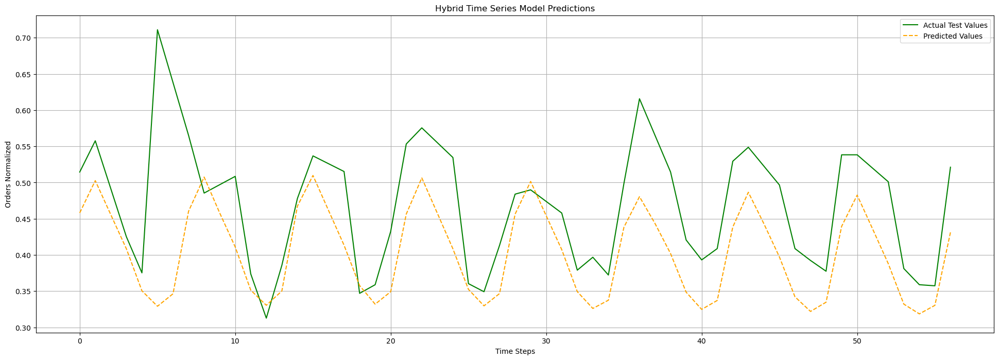

Fold 8/10
Epoch 1, Train Loss: 0.0038, Val Loss: 0.0043, MAPE: 11.61
Epoch 6, Train Loss: 0.0052, Val Loss: 0.0051, MAPE: 12.59
Epoch 11, Train Loss: 0.0066, Val Loss: 0.0078, MAPE: 16.15
Epoch 16, Train Loss: 0.0042, Val Loss: 0.0031, MAPE: 9.74
Epoch 21, Train Loss: 0.0026, Val Loss: 0.0016, MAPE: 7.04
Epoch 26, Train Loss: 0.0025, Val Loss: 0.0024, MAPE: 8.32
Epoch 31, Train Loss: 0.0025, Val Loss: 0.0015, MAPE: 6.84
Epoch 36, Train Loss: 0.0021, Val Loss: 0.0021, MAPE: 7.71
Fold 9/10
Epoch 1, Train Loss: 0.0027, Val Loss: 0.0067, MAPE: 11.11
Epoch 6, Train Loss: 0.0070, Val Loss: 0.0104, MAPE: 14.63
Epoch 11, Train Loss: 0.0028, Val Loss: 0.0076, MAPE: 12.24
Epoch 16, Train Loss: 0.0032, Val Loss: 0.0074, MAPE: 12.08
Epoch 21, Train Loss: 0.0025, Val Loss: 0.0109, MAPE: 15.10
Epoch 26, Train Loss: 0.0019, Val Loss: 0.0083, MAPE: 12.97
Epoch 31, Train Loss: 0.0022, Val Loss: 0.0061, MAPE: 10.41
Epoch 36, Train Loss: 0.0021, Val Loss: 0.0078, MAPE: 12.01


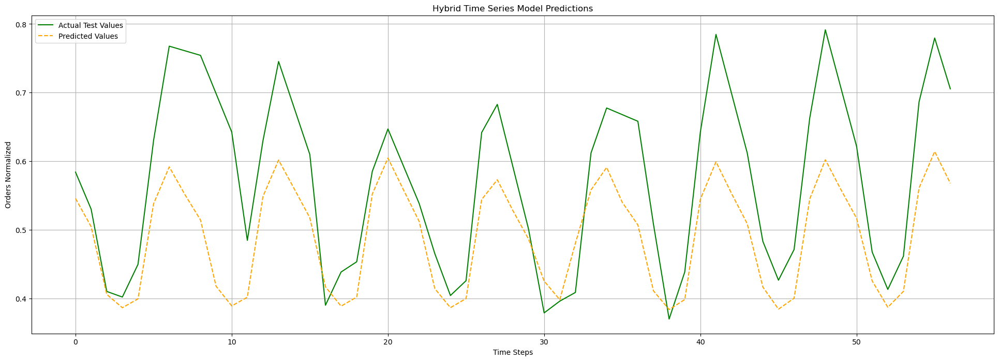

Fold 10/10
Average Validation Loss: 0.0074


In [331]:
final_prediction, trained_model = full_data_processing_train_and_prediction(group_train, True, True)

In [332]:
final_prediction['orders_unnormalized'] = final_prediction.orders_normalized * (group_max - group_min) + group_min
final_prediction = add_time_components(final_prediction)
final_prediction_filter = remove_future_missing(final_prediction, is_german=True)
models[warehouse] = {'model': trained_model, 'minmax': (group_min, group_max), 'final_prediction': final_prediction}

In [333]:
targets = group_test.orders_normalized.values
outputs = final_prediction.orders_normalized.values

# Compute the absolute percentage error
error = np.abs((targets - outputs) / targets)
# Compute mean and scale to percentage
mape_loss = np.mean(error) * 100

mape_loss

10.38264331633336

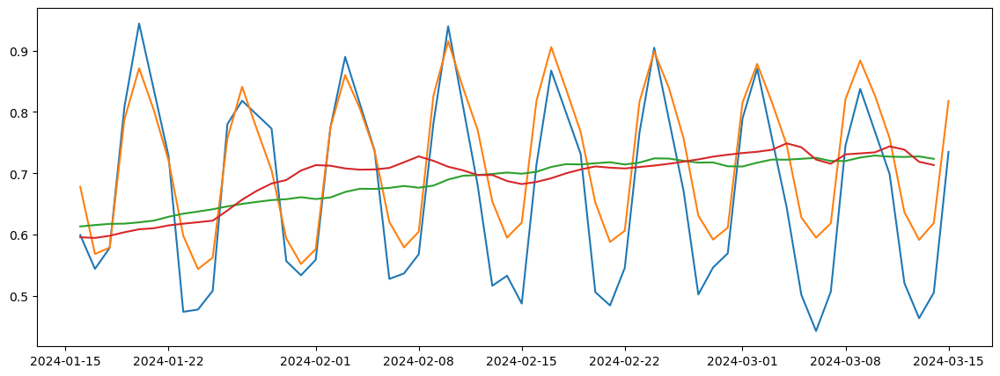

In [334]:
plt.figure(figsize=(14, 5))
plt.plot(group_test.date, group_test.orders_normalized)
plt.plot(final_prediction.date, final_prediction.orders_normalized)
plt.plot(final_prediction.date, final_prediction.trend_91)
plt.plot(final_prediction.date, final_prediction.trend_28)
plt.show()

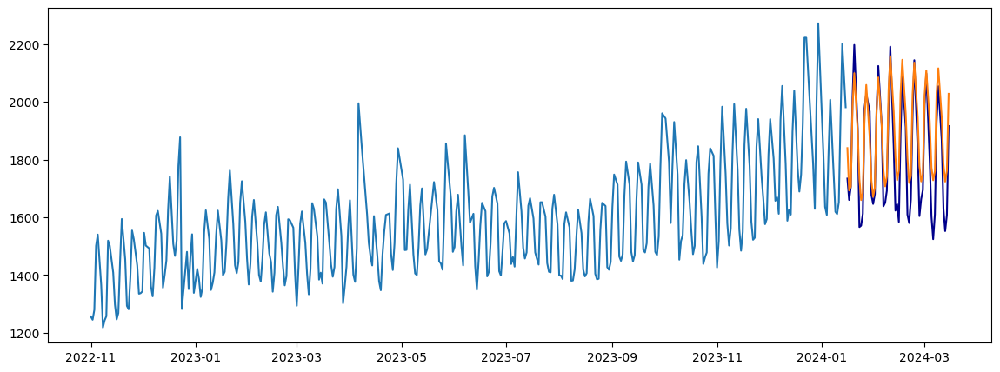

In [335]:
group_train_filter = remove_future_missing(group_train, is_german=True)
group_test_filter = remove_future_missing(group_test, is_german=True)

plt.figure(figsize=(14, 5))
plt.plot(group_train_filter.date[-365:], group_train_filter.orders[-365:])
plt.plot(group_test_filter.date, group_test_filter.orders, c='darkblue')
plt.plot(final_prediction_filter.date, final_prediction_filter.orders_unnormalized)

### Munich_1 run

In [337]:
warehouse = 'Munich_1'
group = df[df.warehouse == warehouse].copy()
group_train, group_test, group_min, group_max = split_group_train_test(group)

Fold 1/10
Epoch 1, Train Loss: 0.0314, Val Loss: 0.1090, MAPE: 85.68
Epoch 6, Train Loss: 0.0045, Val Loss: 0.0410, MAPE: 49.19
Epoch 11, Train Loss: 0.0045, Val Loss: 0.0353, MAPE: 44.74
Epoch 16, Train Loss: 0.0037, Val Loss: 0.0348, MAPE: 44.17
Epoch 21, Train Loss: 0.0021, Val Loss: 0.0224, MAPE: 34.00
Epoch 26, Train Loss: 0.0015, Val Loss: 0.0208, MAPE: 32.66
Epoch 31, Train Loss: 0.0008, Val Loss: 0.0172, MAPE: 30.28
Epoch 36, Train Loss: 0.0006, Val Loss: 0.0151, MAPE: 28.55


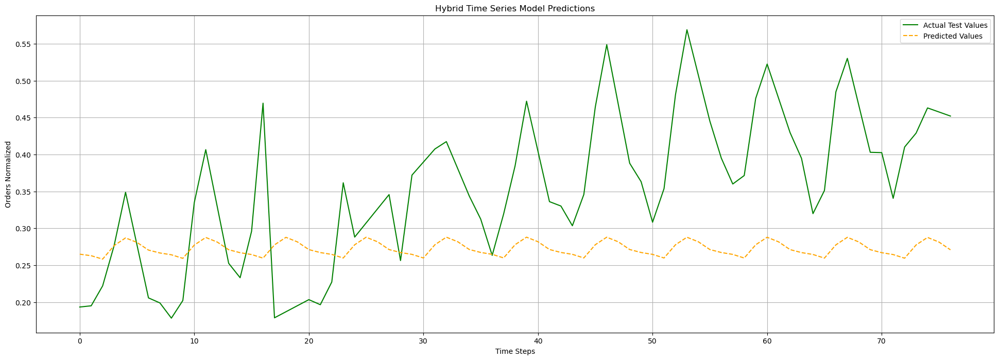

Fold 2/10
Epoch 1, Train Loss: 0.0058, Val Loss: 0.0089, MAPE: 18.28
Epoch 6, Train Loss: 0.0045, Val Loss: 0.0065, MAPE: 12.33
Epoch 11, Train Loss: 0.0036, Val Loss: 0.0191, MAPE: 26.86
Epoch 16, Train Loss: 0.0034, Val Loss: 0.0250, MAPE: 31.13
Epoch 21, Train Loss: 0.0013, Val Loss: 0.0190, MAPE: 25.91
Epoch 26, Train Loss: 0.0010, Val Loss: 0.0193, MAPE: 26.24
Epoch 31, Train Loss: 0.0010, Val Loss: 0.0163, MAPE: 23.58
Epoch 36, Train Loss: 0.0013, Val Loss: 0.0106, MAPE: 18.28
Fold 3/10
Epoch 1, Train Loss: 0.0029, Val Loss: 0.0361, MAPE: 57.34
Epoch 6, Train Loss: 0.0042, Val Loss: 0.0049, MAPE: 20.44
Epoch 11, Train Loss: 0.0039, Val Loss: 0.0039, MAPE: 17.31
Epoch 16, Train Loss: 0.0038, Val Loss: 0.0167, MAPE: 32.84
Epoch 21, Train Loss: 0.0026, Val Loss: 0.0190, MAPE: 38.81
Epoch 26, Train Loss: 0.0024, Val Loss: 0.0266, MAPE: 48.46
Epoch 31, Train Loss: 0.0015, Val Loss: 0.0325, MAPE: 53.29
Epoch 36, Train Loss: 0.0025, Val Loss: 0.0232, MAPE: 42.44


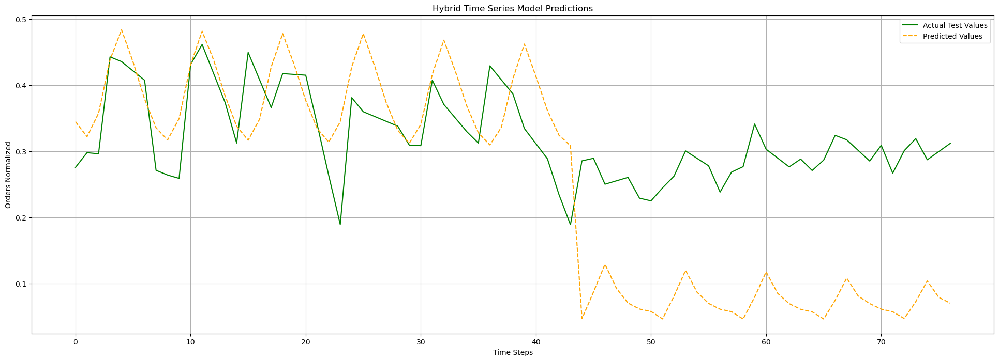

Fold 4/10
Epoch 1, Train Loss: 0.0083, Val Loss: 0.0434, MAPE: 60.00
Epoch 6, Train Loss: 0.0044, Val Loss: 0.0160, MAPE: 34.02
Epoch 11, Train Loss: 0.0042, Val Loss: 0.0141, MAPE: 30.79
Epoch 16, Train Loss: 0.0038, Val Loss: 0.0123, MAPE: 28.34
Epoch 21, Train Loss: 0.0038, Val Loss: 0.0107, MAPE: 25.34
Epoch 26, Train Loss: 0.0036, Val Loss: 0.0087, MAPE: 21.78
Epoch 31, Train Loss: 0.0046, Val Loss: 0.0158, MAPE: 33.63
Epoch 36, Train Loss: 0.0034, Val Loss: 0.0078, MAPE: 20.71
Fold 5/10
Epoch 1, Train Loss: 0.0036, Val Loss: 0.0039, MAPE: 17.03
Epoch 6, Train Loss: 0.0039, Val Loss: 0.0032, MAPE: 11.99
Epoch 11, Train Loss: 0.0037, Val Loss: 0.0039, MAPE: 15.90
Epoch 16, Train Loss: 0.0026, Val Loss: 0.0034, MAPE: 14.72
Epoch 21, Train Loss: 0.0026, Val Loss: 0.0054, MAPE: 18.33
Epoch 26, Train Loss: 0.0042, Val Loss: 0.0069, MAPE: 21.74
Epoch 31, Train Loss: 0.0039, Val Loss: 0.0074, MAPE: 23.01
Epoch 36, Train Loss: 0.0037, Val Loss: 0.0079, MAPE: 23.75


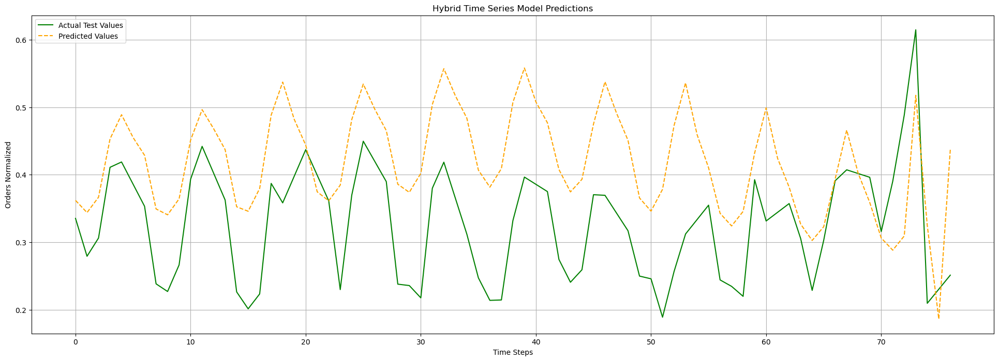

Fold 6/10
Epoch 1, Train Loss: 0.0043, Val Loss: 0.0043, MAPE: 16.80
Epoch 6, Train Loss: 0.0042, Val Loss: 0.0045, MAPE: 17.89
Epoch 11, Train Loss: 0.0037, Val Loss: 0.0041, MAPE: 16.79
Epoch 16, Train Loss: 0.0033, Val Loss: 0.0040, MAPE: 16.62
Epoch 21, Train Loss: 0.0035, Val Loss: 0.0048, MAPE: 18.68
Epoch 26, Train Loss: 0.0033, Val Loss: 0.0033, MAPE: 15.21
Epoch 31, Train Loss: 0.0028, Val Loss: 0.0031, MAPE: 14.33
Epoch 36, Train Loss: 0.0023, Val Loss: 0.0017, MAPE: 10.33
Fold 7/10
Epoch 1, Train Loss: 0.0023, Val Loss: 0.0045, MAPE: 12.38
Epoch 6, Train Loss: 0.0025, Val Loss: 0.0034, MAPE: 9.96
Epoch 11, Train Loss: 0.0024, Val Loss: 0.0036, MAPE: 10.49
Epoch 16, Train Loss: 0.0021, Val Loss: 0.0026, MAPE: 8.62
Epoch 21, Train Loss: 0.0036, Val Loss: 0.0029, MAPE: 8.38
Epoch 26, Train Loss: 0.0019, Val Loss: 0.0030, MAPE: 9.04
Epoch 31, Train Loss: 0.0021, Val Loss: 0.0023, MAPE: 7.10
Epoch 36, Train Loss: 0.0011, Val Loss: 0.0037, MAPE: 10.80


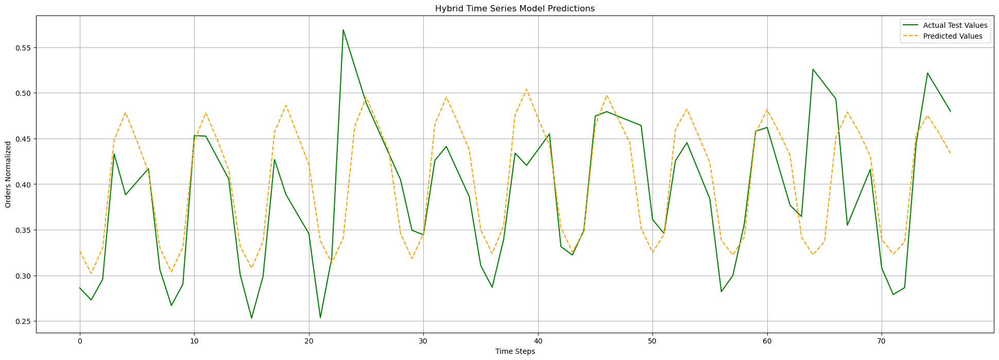

Fold 8/10
Epoch 1, Train Loss: 0.0018, Val Loss: 0.0029, MAPE: 16.29
Epoch 6, Train Loss: 0.0012, Val Loss: 0.0029, MAPE: 15.77
Epoch 11, Train Loss: 0.0012, Val Loss: 0.0030, MAPE: 16.34
Epoch 16, Train Loss: 0.0015, Val Loss: 0.0030, MAPE: 16.17
Epoch 21, Train Loss: 0.0013, Val Loss: 0.0031, MAPE: 16.69
Epoch 26, Train Loss: 0.0012, Val Loss: 0.0031, MAPE: 16.15
Epoch 31, Train Loss: 0.0016, Val Loss: 0.0038, MAPE: 18.51
Epoch 36, Train Loss: 0.0013, Val Loss: 0.0031, MAPE: 16.30
Fold 9/10
Epoch 1, Train Loss: 0.0017, Val Loss: 0.0115, MAPE: 16.58
Epoch 6, Train Loss: 0.0015, Val Loss: 0.0111, MAPE: 15.60
Epoch 11, Train Loss: 0.0014, Val Loss: 0.0096, MAPE: 14.76
Epoch 16, Train Loss: 0.0014, Val Loss: 0.0088, MAPE: 14.15
Epoch 21, Train Loss: 0.0014, Val Loss: 0.0082, MAPE: 13.79
Epoch 26, Train Loss: 0.0014, Val Loss: 0.0092, MAPE: 14.60
Epoch 31, Train Loss: 0.0014, Val Loss: 0.0082, MAPE: 13.76
Epoch 36, Train Loss: 0.0015, Val Loss: 0.0121, MAPE: 16.78


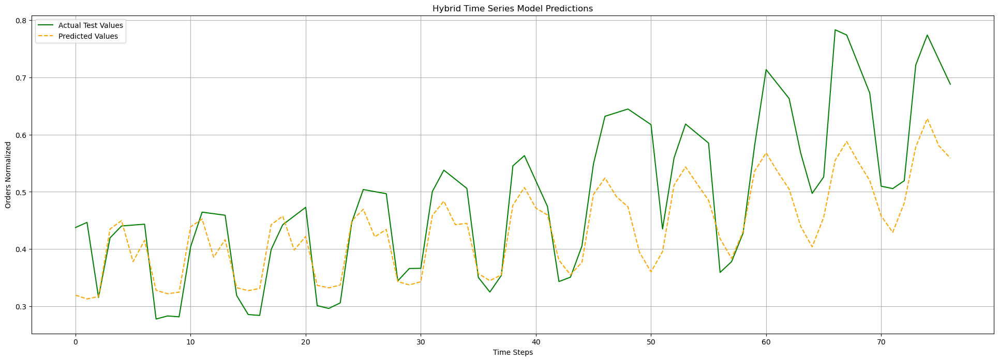

Fold 10/10
Average Validation Loss: 0.0104


In [338]:
final_prediction, trained_model = full_data_processing_train_and_prediction(group_train, True, True)

In [339]:
final_prediction['orders_unnormalized'] = final_prediction.orders_normalized * (group_max - group_min) + group_min
final_prediction = add_time_components(final_prediction)
final_prediction_filter = remove_future_missing(final_prediction, is_german=True)
models[warehouse] = {'model': trained_model, 'minmax': (group_min, group_max), 'final_prediction': final_prediction}

In [340]:
targets = group_test.orders_normalized.values
outputs = final_prediction.orders_normalized.values

# Compute the absolute percentage error
error = np.abs((targets - outputs) / targets)
# Compute mean and scale to percentage
mape_loss = np.mean(error) * 100

mape_loss

9.61661108582724

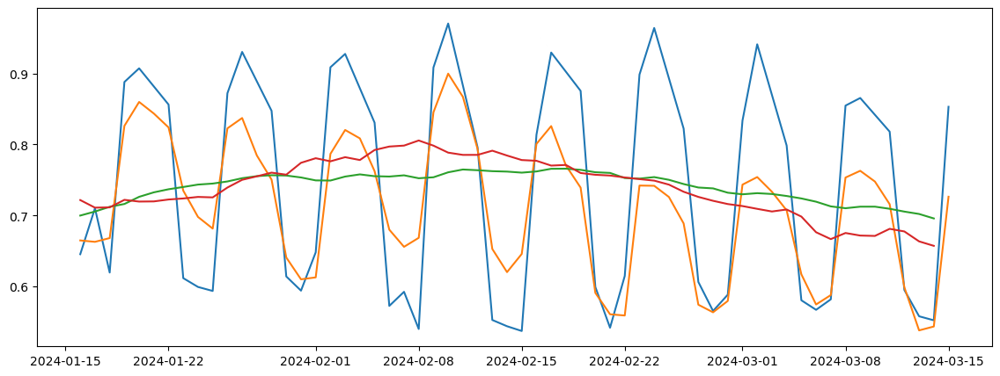

In [341]:
plt.figure(figsize=(14, 5))
plt.plot(group_test.date, group_test.orders_normalized)
plt.plot(final_prediction.date, final_prediction.orders_normalized)
plt.plot(final_prediction.date, final_prediction.trend_91)
plt.plot(final_prediction.date, final_prediction.trend_28)
plt.show()

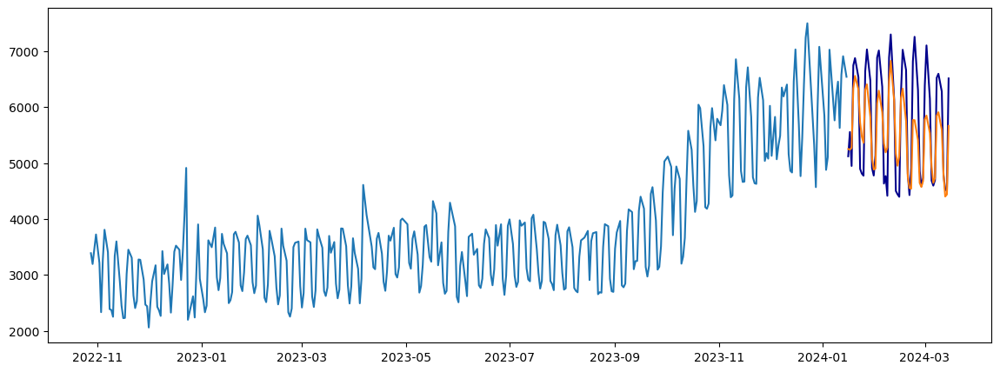

In [342]:
group_train_filter = remove_future_missing(group_train, is_german=True)
group_test_filter = remove_future_missing(group_test, is_german=True)

plt.figure(figsize=(14, 5))
plt.plot(group_train_filter.date[-365:], group_train_filter.orders[-365:])
plt.plot(group_test_filter.date, group_test_filter.orders, c='darkblue')
plt.plot(final_prediction_filter.date, final_prediction_filter.orders_unnormalized)

### Prague_1 run

In [344]:
warehouse = 'Prague_1'
group = df[df.warehouse == warehouse].copy()
group_train, group_test, group_min, group_max = split_group_train_test(group)

Fold 1/10
Epoch 1, Train Loss: 0.0858, Val Loss: 0.0478, MAPE: 78.75
Epoch 6, Train Loss: 0.0015, Val Loss: 0.0027, MAPE: 23.47
Epoch 11, Train Loss: 0.0009, Val Loss: 0.0061, MAPE: 35.01
Epoch 16, Train Loss: 0.0008, Val Loss: 0.0051, MAPE: 31.96
Epoch 21, Train Loss: 0.0007, Val Loss: 0.0046, MAPE: 30.20
Epoch 26, Train Loss: 0.0007, Val Loss: 0.0044, MAPE: 29.45
Epoch 31, Train Loss: 0.0007, Val Loss: 0.0043, MAPE: 29.09
Epoch 36, Train Loss: 0.0007, Val Loss: 0.0043, MAPE: 28.88


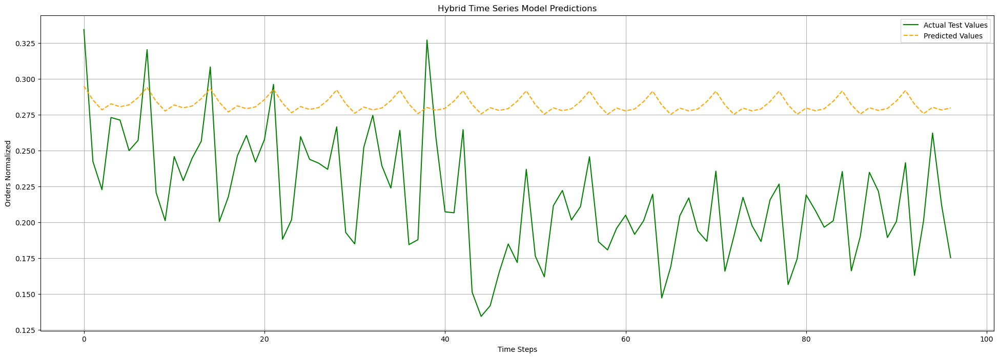

Fold 2/10
Epoch 1, Train Loss: 0.0015, Val Loss: 0.0145, MAPE: 31.75
Epoch 6, Train Loss: 0.0014, Val Loss: 0.0080, MAPE: 21.35
Epoch 11, Train Loss: 0.0011, Val Loss: 0.0051, MAPE: 16.87
Epoch 16, Train Loss: 0.0009, Val Loss: 0.0045, MAPE: 15.49
Epoch 21, Train Loss: 0.0010, Val Loss: 0.0107, MAPE: 26.51
Epoch 26, Train Loss: 0.0008, Val Loss: 0.0022, MAPE: 10.35
Epoch 31, Train Loss: 0.0004, Val Loss: 0.0039, MAPE: 15.22
Epoch 36, Train Loss: 0.0007, Val Loss: 0.0027, MAPE: 11.99
Fold 3/10
Epoch 1, Train Loss: 0.0009, Val Loss: 0.0019, MAPE: 10.55
Epoch 6, Train Loss: 0.0075, Val Loss: 0.0218, MAPE: 39.80
Epoch 11, Train Loss: 0.0009, Val Loss: 0.0025, MAPE: 14.00
Epoch 16, Train Loss: 0.0010, Val Loss: 0.0039, MAPE: 17.78
Epoch 21, Train Loss: 0.0011, Val Loss: 0.0046, MAPE: 19.24
Epoch 26, Train Loss: 0.0014, Val Loss: 0.0057, MAPE: 21.42
Epoch 31, Train Loss: 0.0010, Val Loss: 0.0036, MAPE: 16.82
Epoch 36, Train Loss: 0.0009, Val Loss: 0.0045, MAPE: 18.86


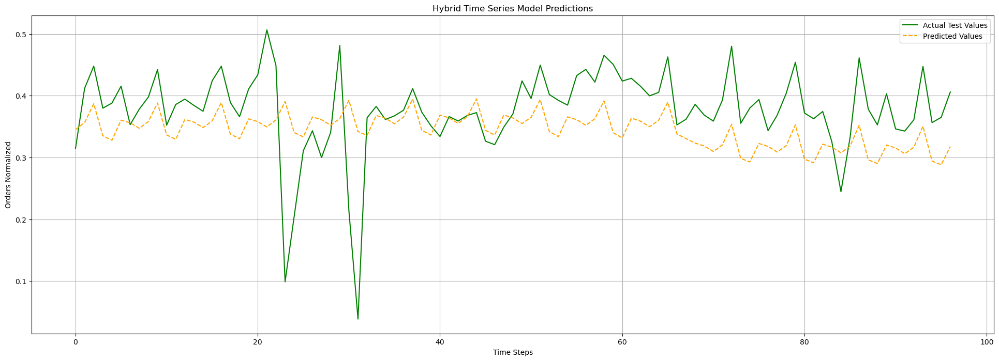

Fold 4/10
Epoch 1, Train Loss: 0.0015, Val Loss: 0.0010, MAPE: 7.88
Epoch 6, Train Loss: 0.0036, Val Loss: 0.0029, MAPE: 15.30
Epoch 11, Train Loss: 0.0012, Val Loss: 0.0022, MAPE: 12.84
Epoch 16, Train Loss: 0.0015, Val Loss: 0.0015, MAPE: 10.24
Epoch 21, Train Loss: 0.0014, Val Loss: 0.0017, MAPE: 10.79
Epoch 26, Train Loss: 0.0013, Val Loss: 0.0015, MAPE: 10.00
Epoch 31, Train Loss: 0.0012, Val Loss: 0.0012, MAPE: 9.17
Epoch 36, Train Loss: 0.0012, Val Loss: 0.0020, MAPE: 11.44
Fold 5/10
Epoch 1, Train Loss: 0.0017, Val Loss: 0.0006, MAPE: 6.58
Epoch 6, Train Loss: 0.0015, Val Loss: 0.0020, MAPE: 13.10
Epoch 11, Train Loss: 0.0015, Val Loss: 0.0030, MAPE: 16.94
Epoch 16, Train Loss: 0.0016, Val Loss: 0.0037, MAPE: 19.18
Epoch 21, Train Loss: 0.0014, Val Loss: 0.0025, MAPE: 15.18
Epoch 26, Train Loss: 0.0013, Val Loss: 0.0018, MAPE: 12.20
Epoch 31, Train Loss: 0.0013, Val Loss: 0.0019, MAPE: 12.92
Epoch 36, Train Loss: 0.0013, Val Loss: 0.0018, MAPE: 12.23


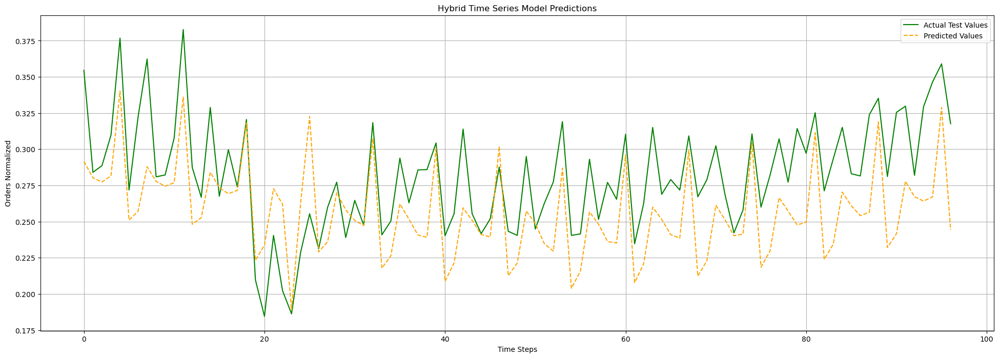

Fold 6/10
Epoch 1, Train Loss: 0.0012, Val Loss: 0.0046, MAPE: 13.17
Epoch 6, Train Loss: 0.0027, Val Loss: 0.0059, MAPE: 12.85
Epoch 11, Train Loss: 0.0018, Val Loss: 0.0044, MAPE: 11.14
Epoch 16, Train Loss: 0.0015, Val Loss: 0.0042, MAPE: 10.33
Epoch 21, Train Loss: 0.0015, Val Loss: 0.0039, MAPE: 10.08
Epoch 26, Train Loss: 0.0014, Val Loss: 0.0041, MAPE: 10.08
Epoch 31, Train Loss: 0.0012, Val Loss: 0.0039, MAPE: 9.77
Epoch 36, Train Loss: 0.0013, Val Loss: 0.0039, MAPE: 9.83
Fold 7/10
Epoch 1, Train Loss: 0.0014, Val Loss: 0.0029, MAPE: 11.72
Epoch 6, Train Loss: 0.0016, Val Loss: 0.0031, MAPE: 12.10
Epoch 11, Train Loss: 0.0014, Val Loss: 0.0026, MAPE: 10.32
Epoch 16, Train Loss: 0.0014, Val Loss: 0.0026, MAPE: 10.59
Epoch 21, Train Loss: 0.0013, Val Loss: 0.0025, MAPE: 10.33
Epoch 26, Train Loss: 0.0014, Val Loss: 0.0023, MAPE: 9.95
Epoch 31, Train Loss: 0.0012, Val Loss: 0.0024, MAPE: 10.09
Epoch 36, Train Loss: 0.0015, Val Loss: 0.0025, MAPE: 10.47


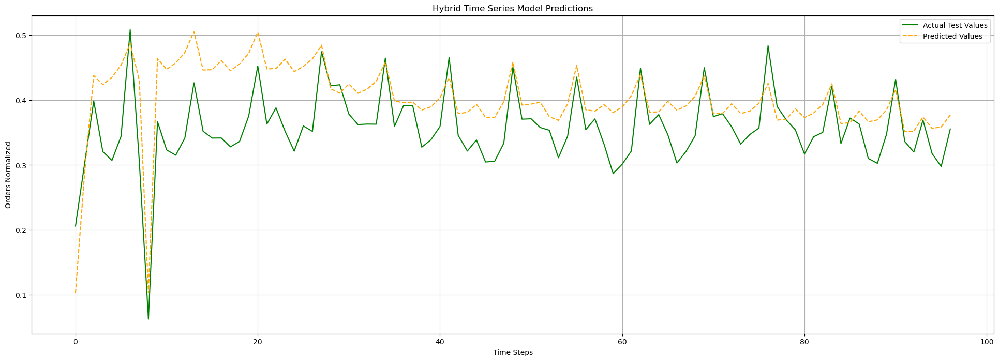

Fold 8/10
Epoch 1, Train Loss: 0.0014, Val Loss: 0.0010, MAPE: 7.10
Epoch 6, Train Loss: 0.0014, Val Loss: 0.0008, MAPE: 5.75
Epoch 11, Train Loss: 0.0013, Val Loss: 0.0008, MAPE: 6.02
Epoch 16, Train Loss: 0.0015, Val Loss: 0.0008, MAPE: 5.99
Epoch 21, Train Loss: 0.0013, Val Loss: 0.0008, MAPE: 5.69
Epoch 26, Train Loss: 0.0013, Val Loss: 0.0008, MAPE: 5.41
Epoch 31, Train Loss: 0.0010, Val Loss: 0.0008, MAPE: 5.47
Epoch 36, Train Loss: 0.0017, Val Loss: 0.0008, MAPE: 5.78
Fold 9/10
Epoch 1, Train Loss: 0.0011, Val Loss: 0.0014, MAPE: 8.70
Epoch 6, Train Loss: 0.0012, Val Loss: 0.0013, MAPE: 8.26
Epoch 11, Train Loss: 0.0010, Val Loss: 0.0012, MAPE: 8.11
Epoch 16, Train Loss: 0.0010, Val Loss: 0.0012, MAPE: 7.79
Epoch 21, Train Loss: 0.0010, Val Loss: 0.0013, MAPE: 8.18
Epoch 26, Train Loss: 0.0017, Val Loss: 0.0013, MAPE: 8.43
Epoch 31, Train Loss: 0.0011, Val Loss: 0.0014, MAPE: 8.70
Epoch 36, Train Loss: 0.0009, Val Loss: 0.0016, MAPE: 9.68


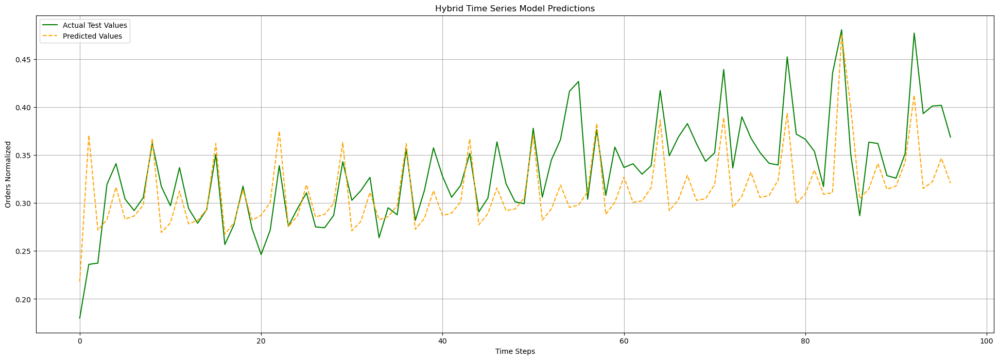

Fold 10/10
Average Validation Loss: 0.0026


In [345]:
final_prediction, trained_model = full_data_processing_train_and_prediction(group_train, True, True)

In [346]:
final_prediction['orders_unnormalized'] = final_prediction.orders_normalized * (group_max - group_min) + group_min
final_prediction = add_time_components(final_prediction)
final_prediction_filter = remove_future_missing(final_prediction)
models[warehouse] = {'model': trained_model, 'minmax': (group_min, group_max), 'final_prediction': final_prediction}

In [347]:
targets = group_test.orders_normalized.values
outputs = final_prediction.orders_normalized.values

# Compute the absolute percentage error
error = np.abs((targets - outputs) / targets)
# Compute mean and scale to percentage
mape_loss = np.mean(error) * 100

mape_loss

5.4064103842714175

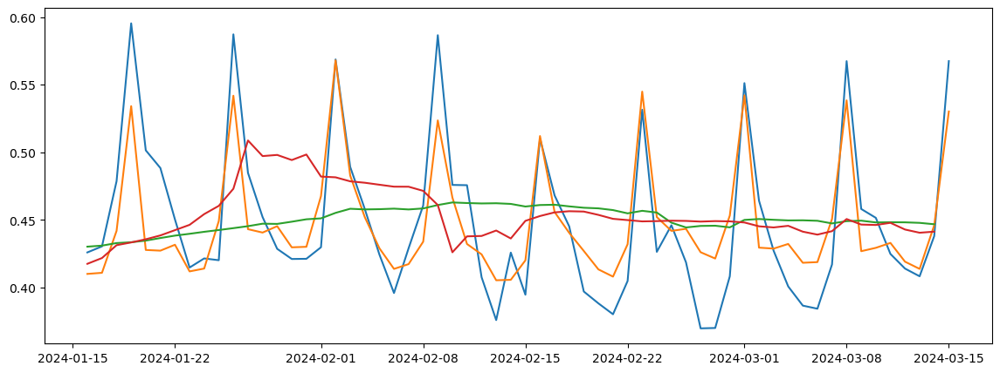

In [348]:
plt.figure(figsize=(14, 5))
plt.plot(group_test.date, group_test.orders_normalized)
plt.plot(final_prediction.date, final_prediction.orders_normalized)
plt.plot(final_prediction.date, final_prediction.trend_91)
plt.plot(final_prediction.date, final_prediction.trend_28)
plt.show()

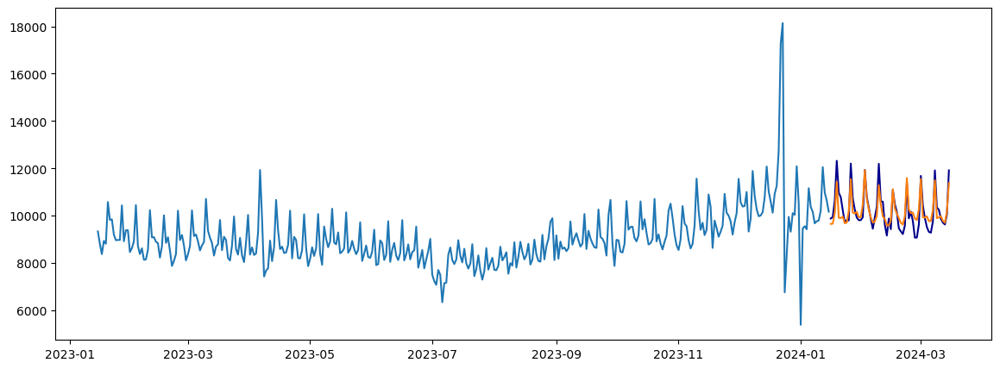

In [349]:
group_train_filter = remove_future_missing(group_train)
group_test_filter = remove_future_missing(group_test)

plt.figure(figsize=(14, 5))
plt.plot(group_train_filter.date[-365:], group_train_filter.orders[-365:])
plt.plot(group_test_filter.date, group_test_filter.orders, c='darkblue')
plt.plot(final_prediction_filter.date, final_prediction_filter.orders_unnormalized)

### Prague_2 run

In [351]:
warehouse = 'Prague_2'
group = df[df.warehouse == warehouse].copy()
group_train, group_test, group_min, group_max = split_group_train_test(group)

Fold 1/10
Epoch 1, Train Loss: 0.0940, Val Loss: 0.0508, MAPE: 67.95
Epoch 6, Train Loss: 0.0027, Val Loss: 0.0053, MAPE: 26.66
Epoch 11, Train Loss: 0.0014, Val Loss: 0.0062, MAPE: 29.84
Epoch 16, Train Loss: 0.0012, Val Loss: 0.0044, MAPE: 25.28
Epoch 21, Train Loss: 0.0011, Val Loss: 0.0049, MAPE: 26.69
Epoch 26, Train Loss: 0.0011, Val Loss: 0.0046, MAPE: 25.71
Epoch 31, Train Loss: 0.0011, Val Loss: 0.0045, MAPE: 25.31
Epoch 36, Train Loss: 0.0011, Val Loss: 0.0044, MAPE: 24.86


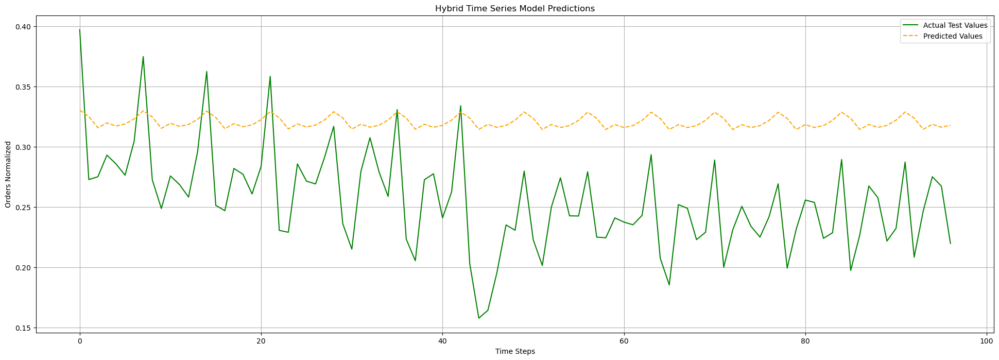

Fold 2/10
Epoch 1, Train Loss: 0.0020, Val Loss: 0.0113, MAPE: 24.70
Epoch 6, Train Loss: 0.0016, Val Loss: 0.0069, MAPE: 18.68
Epoch 11, Train Loss: 0.0012, Val Loss: 0.0048, MAPE: 14.55
Epoch 16, Train Loss: 0.0013, Val Loss: 0.0041, MAPE: 13.17
Epoch 21, Train Loss: 0.0009, Val Loss: 0.0056, MAPE: 18.08
Epoch 26, Train Loss: 0.0006, Val Loss: 0.0047, MAPE: 16.11
Epoch 31, Train Loss: 0.0006, Val Loss: 0.0046, MAPE: 15.96
Epoch 36, Train Loss: 0.0007, Val Loss: 0.0046, MAPE: 16.02
Fold 3/10
Epoch 1, Train Loss: 0.0010, Val Loss: 0.0019, MAPE: 7.52
Epoch 6, Train Loss: 0.0052, Val Loss: 0.0134, MAPE: 27.78
Epoch 11, Train Loss: 0.0014, Val Loss: 0.0025, MAPE: 10.36
Epoch 16, Train Loss: 0.0015, Val Loss: 0.0030, MAPE: 11.68
Epoch 21, Train Loss: 0.0015, Val Loss: 0.0031, MAPE: 11.88
Epoch 26, Train Loss: 0.0012, Val Loss: 0.0023, MAPE: 10.09
Epoch 31, Train Loss: 0.0008, Val Loss: 0.0020, MAPE: 8.91
Epoch 36, Train Loss: 0.0010, Val Loss: 0.0024, MAPE: 10.21


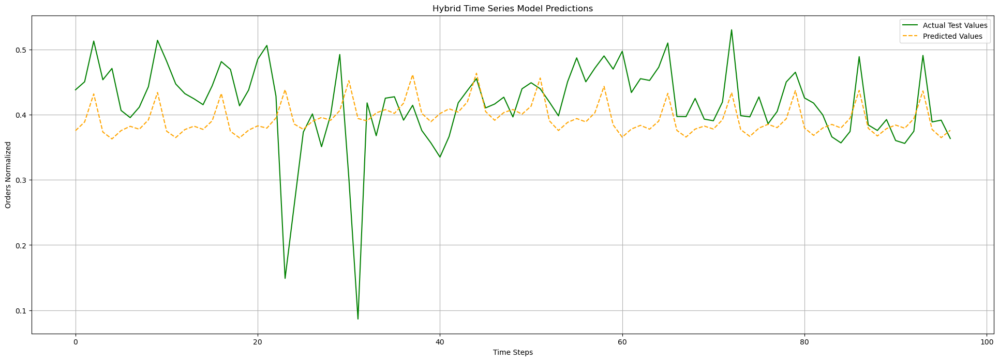

Fold 4/10
Epoch 1, Train Loss: 0.0016, Val Loss: 0.0012, MAPE: 7.23
Epoch 6, Train Loss: 0.0027, Val Loss: 0.0016, MAPE: 8.12
Epoch 11, Train Loss: 0.0012, Val Loss: 0.0027, MAPE: 12.33
Epoch 16, Train Loss: 0.0017, Val Loss: 0.0015, MAPE: 8.07
Epoch 21, Train Loss: 0.0013, Val Loss: 0.0022, MAPE: 10.52
Epoch 26, Train Loss: 0.0014, Val Loss: 0.0016, MAPE: 8.65
Epoch 31, Train Loss: 0.0012, Val Loss: 0.0019, MAPE: 9.60
Epoch 36, Train Loss: 0.0015, Val Loss: 0.0027, MAPE: 11.38
Fold 5/10
Epoch 1, Train Loss: 0.0014, Val Loss: 0.0006, MAPE: 5.85
Epoch 6, Train Loss: 0.0015, Val Loss: 0.0020, MAPE: 12.31
Epoch 11, Train Loss: 0.0014, Val Loss: 0.0014, MAPE: 9.84
Epoch 16, Train Loss: 0.0013, Val Loss: 0.0015, MAPE: 10.30
Epoch 21, Train Loss: 0.0013, Val Loss: 0.0013, MAPE: 9.68
Epoch 26, Train Loss: 0.0013, Val Loss: 0.0013, MAPE: 9.83
Epoch 31, Train Loss: 0.0012, Val Loss: 0.0012, MAPE: 9.02
Epoch 36, Train Loss: 0.0012, Val Loss: 0.0011, MAPE: 8.75


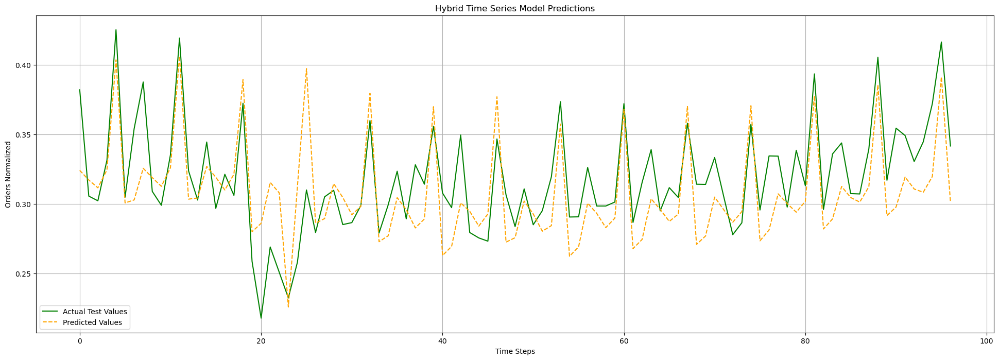

Fold 6/10
Epoch 1, Train Loss: 0.0013, Val Loss: 0.0094, MAPE: 19.83
Epoch 6, Train Loss: 0.0025, Val Loss: 0.0094, MAPE: 18.77
Epoch 11, Train Loss: 0.0016, Val Loss: 0.0073, MAPE: 12.86
Epoch 16, Train Loss: 0.0017, Val Loss: 0.0072, MAPE: 12.54
Epoch 21, Train Loss: 0.0016, Val Loss: 0.0072, MAPE: 12.32
Epoch 26, Train Loss: 0.0016, Val Loss: 0.0072, MAPE: 12.20
Epoch 31, Train Loss: 0.0016, Val Loss: 0.0071, MAPE: 12.09
Epoch 36, Train Loss: 0.0016, Val Loss: 0.0071, MAPE: 12.05
Fold 7/10
Epoch 1, Train Loss: 0.0018, Val Loss: 0.0051, MAPE: 14.64
Epoch 6, Train Loss: 0.0020, Val Loss: 0.0052, MAPE: 14.84
Epoch 11, Train Loss: 0.0019, Val Loss: 0.0050, MAPE: 14.41
Epoch 16, Train Loss: 0.0019, Val Loss: 0.0049, MAPE: 14.25
Epoch 21, Train Loss: 0.0018, Val Loss: 0.0047, MAPE: 13.92
Epoch 26, Train Loss: 0.0018, Val Loss: 0.0047, MAPE: 13.94
Epoch 31, Train Loss: 0.0018, Val Loss: 0.0045, MAPE: 13.71
Epoch 36, Train Loss: 0.0017, Val Loss: 0.0044, MAPE: 13.54


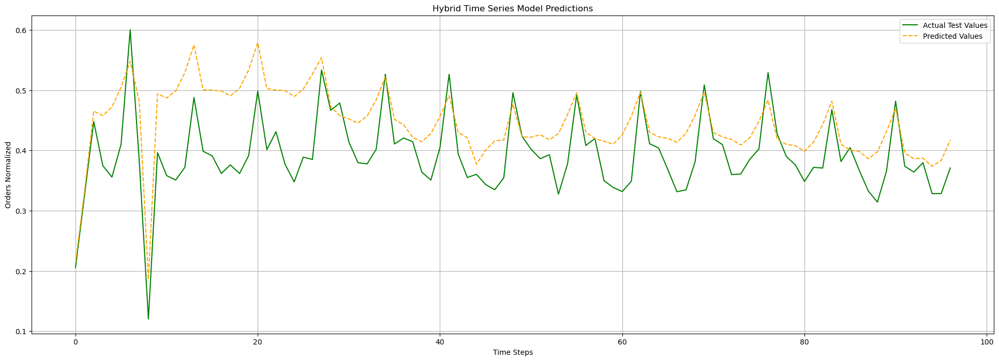

Fold 8/10
Epoch 1, Train Loss: 0.0020, Val Loss: 0.0026, MAPE: 11.80
Epoch 6, Train Loss: 0.0019, Val Loss: 0.0013, MAPE: 7.47
Epoch 11, Train Loss: 0.0018, Val Loss: 0.0015, MAPE: 8.39
Epoch 16, Train Loss: 0.0017, Val Loss: 0.0016, MAPE: 8.59
Epoch 21, Train Loss: 0.0017, Val Loss: 0.0016, MAPE: 8.86
Epoch 26, Train Loss: 0.0016, Val Loss: 0.0016, MAPE: 8.95
Epoch 31, Train Loss: 0.0016, Val Loss: 0.0017, MAPE: 8.97
Epoch 36, Train Loss: 0.0016, Val Loss: 0.0017, MAPE: 9.20
Fold 9/10
Epoch 1, Train Loss: 0.0016, Val Loss: 0.0036, MAPE: 13.70
Epoch 6, Train Loss: 0.0016, Val Loss: 0.0038, MAPE: 14.06
Epoch 11, Train Loss: 0.0015, Val Loss: 0.0038, MAPE: 14.13
Epoch 16, Train Loss: 0.0015, Val Loss: 0.0037, MAPE: 13.90
Epoch 21, Train Loss: 0.0016, Val Loss: 0.0044, MAPE: 15.44
Epoch 26, Train Loss: 0.0016, Val Loss: 0.0036, MAPE: 13.63
Epoch 31, Train Loss: 0.0015, Val Loss: 0.0038, MAPE: 14.12
Epoch 36, Train Loss: 0.0015, Val Loss: 0.0038, MAPE: 14.18


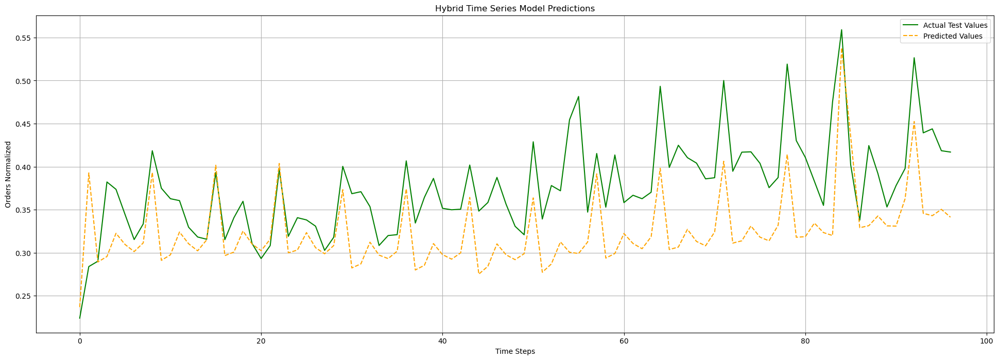

Fold 10/10
Average Validation Loss: 0.0033


In [352]:
final_prediction, trained_model = full_data_processing_train_and_prediction(group_train, True, True)

In [353]:
final_prediction['orders_unnormalized'] = final_prediction.orders_normalized * (group_max - group_min) + group_min
final_prediction = add_time_components(final_prediction)
final_prediction_filter = remove_future_missing(final_prediction)
models[warehouse] = {'model': trained_model, 'minmax': (group_min, group_max), 'final_prediction': final_prediction}

In [354]:
targets = group_test.orders_normalized.values
outputs = final_prediction.orders_normalized.values

# Compute the absolute percentage error
error = np.abs((targets - outputs) / targets)
# Compute mean and scale to percentage
mape_loss = np.mean(error) * 100

mape_loss

10.163214639957294

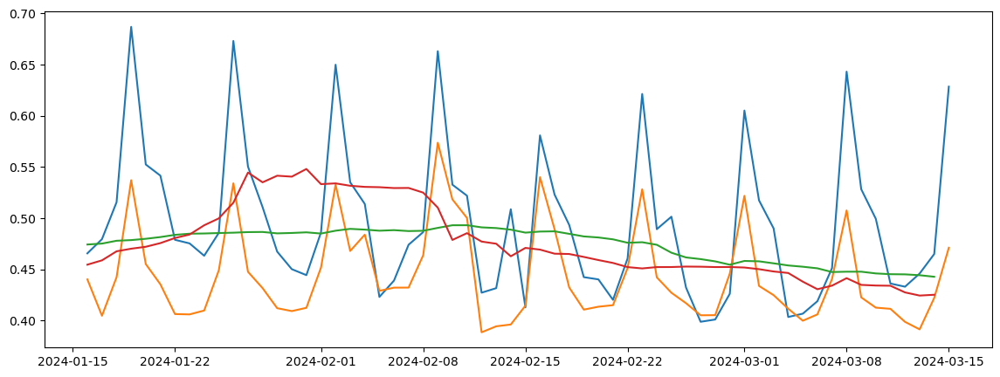

In [355]:
plt.figure(figsize=(14, 5))
plt.plot(group_test.date, group_test.orders_normalized)
plt.plot(final_prediction.date, final_prediction.orders_normalized)
plt.plot(final_prediction.date, final_prediction.trend_91)
plt.plot(final_prediction.date, final_prediction.trend_28)
plt.show()

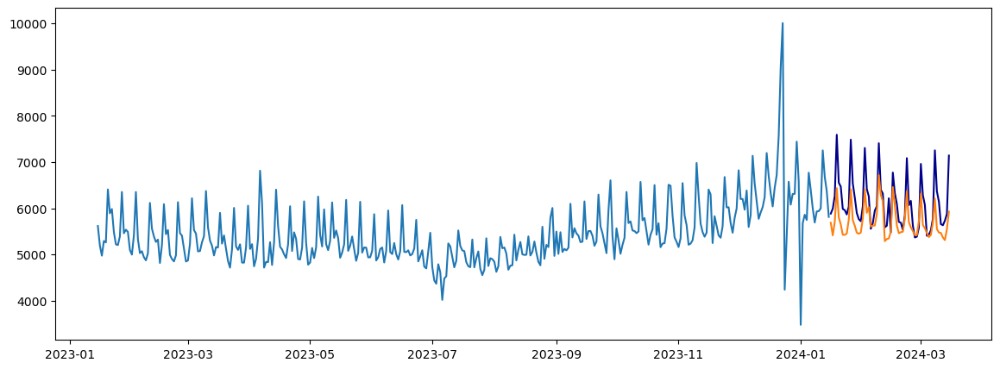

In [356]:
group_train_filter = remove_future_missing(group_train)
group_test_filter = remove_future_missing(group_test)

plt.figure(figsize=(14, 5))
plt.plot(group_train_filter.date[-365:], group_train_filter.orders[-365:])
plt.plot(group_test_filter.date, group_test_filter.orders, c='darkblue')
plt.plot(final_prediction_filter.date, final_prediction_filter.orders_unnormalized)

### Prague_3 run

In [358]:
warehouse = 'Prague_3'
group = df[df.warehouse == warehouse].copy()
group_train, group_test, group_min, group_max = split_group_train_test(group)

Fold 1/10
Epoch 1, Train Loss: 0.1434, Val Loss: 0.0699, MAPE: 78.02
Epoch 6, Train Loss: 0.0039, Val Loss: 0.0161, MAPE: 46.73
Epoch 11, Train Loss: 0.0020, Val Loss: 0.0133, MAPE: 42.37
Epoch 16, Train Loss: 0.0015, Val Loss: 0.0097, MAPE: 35.52
Epoch 21, Train Loss: 0.0013, Val Loss: 0.0086, MAPE: 33.24
Epoch 26, Train Loss: 0.0012, Val Loss: 0.0081, MAPE: 32.20
Epoch 31, Train Loss: 0.0011, Val Loss: 0.0069, MAPE: 29.29
Epoch 36, Train Loss: 0.0010, Val Loss: 0.0058, MAPE: 26.30


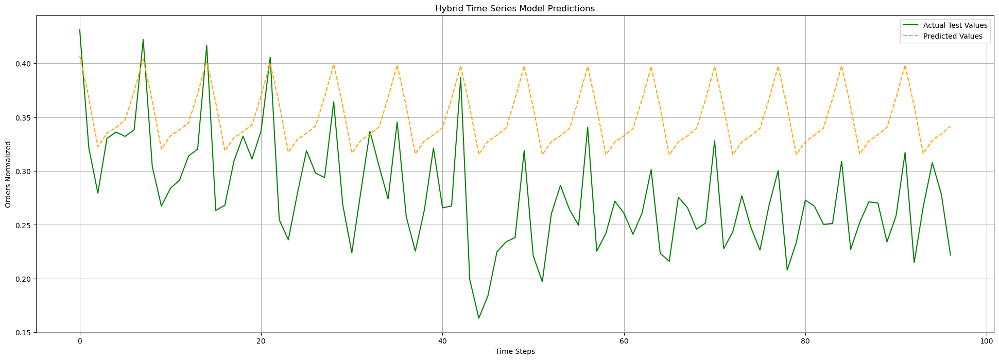

Fold 2/10
Epoch 1, Train Loss: 0.0019, Val Loss: 0.0111, MAPE: 21.87
Epoch 6, Train Loss: 0.0027, Val Loss: 0.0043, MAPE: 11.96
Epoch 11, Train Loss: 0.0009, Val Loss: 0.0015, MAPE: 8.43
Epoch 16, Train Loss: 0.0013, Val Loss: 0.0016, MAPE: 6.69
Epoch 21, Train Loss: 0.0007, Val Loss: 0.0030, MAPE: 11.91
Epoch 26, Train Loss: 0.0008, Val Loss: 0.0033, MAPE: 11.96
Epoch 31, Train Loss: 0.0010, Val Loss: 0.0010, MAPE: 6.36
Epoch 36, Train Loss: 0.0007, Val Loss: 0.0041, MAPE: 13.62
Fold 3/10
Epoch 1, Train Loss: 0.0011, Val Loss: 0.0027, MAPE: 8.85
Epoch 6, Train Loss: 0.0075, Val Loss: 0.0209, MAPE: 32.77
Epoch 11, Train Loss: 0.0012, Val Loss: 0.0029, MAPE: 10.36
Epoch 16, Train Loss: 0.0011, Val Loss: 0.0032, MAPE: 11.47
Epoch 21, Train Loss: 0.0011, Val Loss: 0.0035, MAPE: 12.63
Epoch 26, Train Loss: 0.0008, Val Loss: 0.0029, MAPE: 10.36
Epoch 31, Train Loss: 0.0020, Val Loss: 0.0056, MAPE: 16.90
Epoch 36, Train Loss: 0.0009, Val Loss: 0.0035, MAPE: 12.66


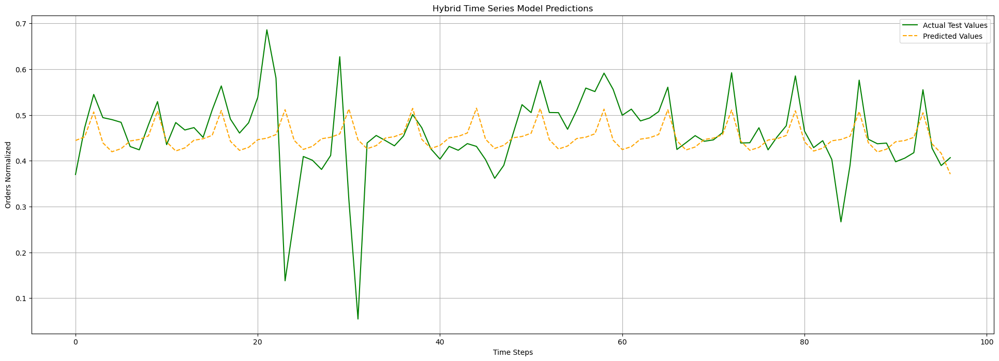

Fold 4/10
Epoch 1, Train Loss: 0.0018, Val Loss: 0.0015, MAPE: 7.28
Epoch 6, Train Loss: 0.0023, Val Loss: 0.0016, MAPE: 7.92
Epoch 11, Train Loss: 0.0024, Val Loss: 0.0019, MAPE: 8.49
Epoch 16, Train Loss: 0.0023, Val Loss: 0.0027, MAPE: 10.68
Epoch 21, Train Loss: 0.0019, Val Loss: 0.0042, MAPE: 13.64
Epoch 26, Train Loss: 0.0015, Val Loss: 0.0034, MAPE: 12.35
Epoch 31, Train Loss: 0.0020, Val Loss: 0.0018, MAPE: 8.44
Epoch 36, Train Loss: 0.0018, Val Loss: 0.0039, MAPE: 12.73
Fold 5/10
Epoch 1, Train Loss: 0.0015, Val Loss: 0.0014, MAPE: 8.92
Epoch 6, Train Loss: 0.0022, Val Loss: 0.0020, MAPE: 10.67
Epoch 11, Train Loss: 0.0020, Val Loss: 0.0037, MAPE: 15.46
Epoch 16, Train Loss: 0.0018, Val Loss: 0.0031, MAPE: 14.03
Epoch 21, Train Loss: 0.0017, Val Loss: 0.0039, MAPE: 16.10
Epoch 26, Train Loss: 0.0017, Val Loss: 0.0025, MAPE: 12.51
Epoch 31, Train Loss: 0.0017, Val Loss: 0.0039, MAPE: 15.96
Epoch 36, Train Loss: 0.0017, Val Loss: 0.0027, MAPE: 12.98


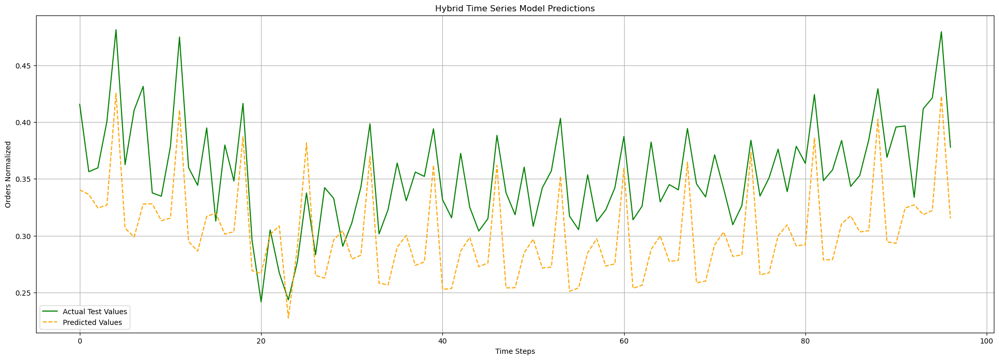

Fold 6/10
Epoch 1, Train Loss: 0.0017, Val Loss: 0.0071, MAPE: 15.78
Epoch 6, Train Loss: 0.0039, Val Loss: 0.0071, MAPE: 13.28
Epoch 11, Train Loss: 0.0026, Val Loss: 0.0041, MAPE: 10.28
Epoch 16, Train Loss: 0.0025, Val Loss: 0.0037, MAPE: 9.81
Epoch 21, Train Loss: 0.0024, Val Loss: 0.0035, MAPE: 9.45
Epoch 26, Train Loss: 0.0023, Val Loss: 0.0034, MAPE: 9.22
Epoch 31, Train Loss: 0.0021, Val Loss: 0.0033, MAPE: 9.01
Epoch 36, Train Loss: 0.0021, Val Loss: 0.0032, MAPE: 8.92
Fold 7/10
Epoch 1, Train Loss: 0.0018, Val Loss: 0.0027, MAPE: 9.91
Epoch 6, Train Loss: 0.0023, Val Loss: 0.0033, MAPE: 11.08
Epoch 11, Train Loss: 0.0025, Val Loss: 0.0032, MAPE: 10.78
Epoch 16, Train Loss: 0.0019, Val Loss: 0.0027, MAPE: 9.71
Epoch 21, Train Loss: 0.0020, Val Loss: 0.0029, MAPE: 10.24
Epoch 26, Train Loss: 0.0017, Val Loss: 0.0023, MAPE: 8.87
Epoch 31, Train Loss: 0.0021, Val Loss: 0.0025, MAPE: 9.22
Epoch 36, Train Loss: 0.0018, Val Loss: 0.0027, MAPE: 9.81


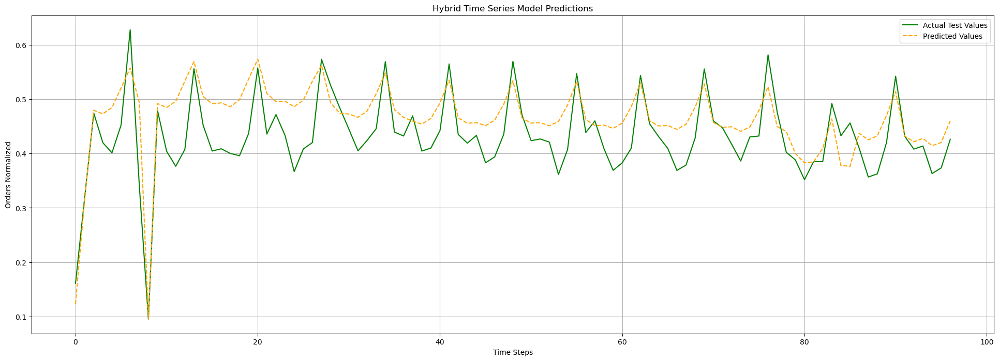

Fold 8/10
Epoch 1, Train Loss: 0.0016, Val Loss: 0.0022, MAPE: 9.06
Epoch 6, Train Loss: 0.0022, Val Loss: 0.0013, MAPE: 5.90
Epoch 11, Train Loss: 0.0018, Val Loss: 0.0014, MAPE: 6.26
Epoch 16, Train Loss: 0.0025, Val Loss: 0.0014, MAPE: 6.54
Epoch 21, Train Loss: 0.0017, Val Loss: 0.0016, MAPE: 7.02
Epoch 26, Train Loss: 0.0016, Val Loss: 0.0014, MAPE: 6.55
Epoch 31, Train Loss: 0.0016, Val Loss: 0.0014, MAPE: 6.60
Epoch 36, Train Loss: 0.0017, Val Loss: 0.0018, MAPE: 7.56
Fold 9/10
Epoch 1, Train Loss: 0.0017, Val Loss: 0.0026, MAPE: 9.90
Epoch 6, Train Loss: 0.0023, Val Loss: 0.0022, MAPE: 9.12
Epoch 11, Train Loss: 0.0015, Val Loss: 0.0025, MAPE: 9.87
Epoch 16, Train Loss: 0.0015, Val Loss: 0.0022, MAPE: 9.08
Epoch 21, Train Loss: 0.0016, Val Loss: 0.0021, MAPE: 8.71
Epoch 26, Train Loss: 0.0015, Val Loss: 0.0021, MAPE: 8.77
Epoch 31, Train Loss: 0.0015, Val Loss: 0.0019, MAPE: 8.16
Epoch 36, Train Loss: 0.0013, Val Loss: 0.0018, MAPE: 7.94


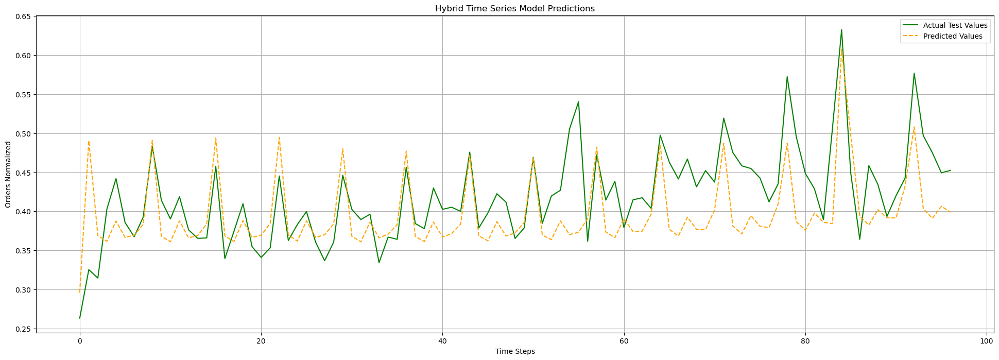

Fold 10/10
Average Validation Loss: 0.0029


In [359]:
final_prediction, trained_model = full_data_processing_train_and_prediction(group_train, True, True)

In [360]:
final_prediction['orders_unnormalized'] = final_prediction.orders_normalized * (group_max - group_min) + group_min
final_prediction = add_time_components(final_prediction)
final_prediction_filter = remove_future_missing(final_prediction)
models[warehouse] = {'model': trained_model, 'minmax': (group_min, group_max), 'final_prediction': final_prediction}

In [361]:
targets = group_test.orders_normalized.values
outputs = final_prediction.orders_normalized.values

# Compute the absolute percentage error
error = np.abs((targets - outputs) / targets)
# Compute mean and scale to percentage
mape_loss = np.mean(error) * 100

mape_loss

6.847921611166069

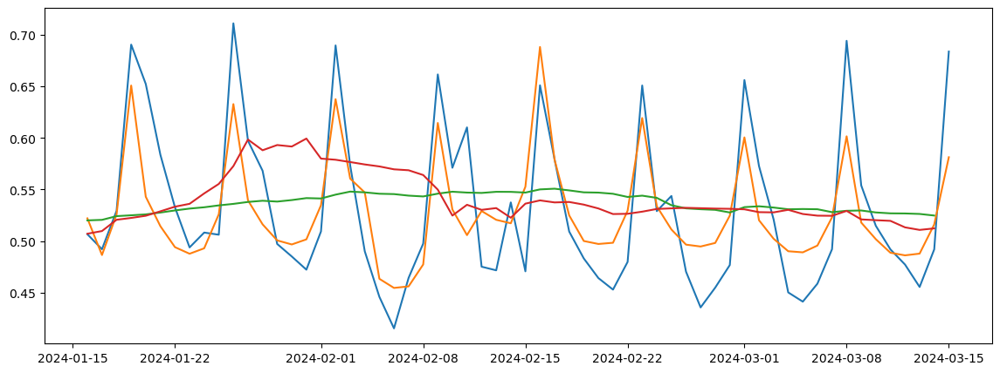

In [362]:
plt.figure(figsize=(14, 5))
plt.plot(group_test.date, group_test.orders_normalized)
plt.plot(final_prediction.date, final_prediction.orders_normalized)
plt.plot(final_prediction.date, final_prediction.trend_91)
plt.plot(final_prediction.date, final_prediction.trend_28)
plt.show()

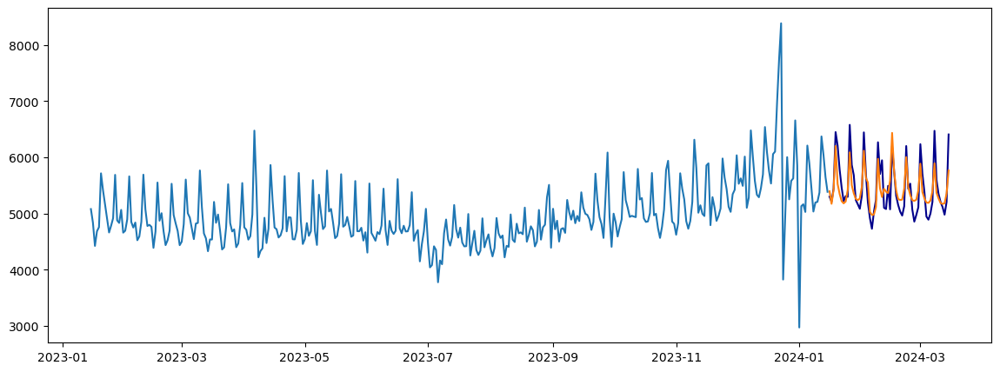

In [363]:
group_train_filter = remove_future_missing(group_train)
group_test_filter = remove_future_missing(group_test)

plt.figure(figsize=(14, 5))
plt.plot(group_train_filter.date[-365:], group_train_filter.orders[-365:])
plt.plot(group_test_filter.date, group_test_filter.orders, c='darkblue')
plt.plot(final_prediction_filter.date, final_prediction_filter.orders_unnormalized)

# Summary

## Downwards
The model performs well in most warehouses, especially those with higher order volumes.<br>
However, making predictions for the test period was challenging since it directly follows Christmas and New Year, events that disrupt the standard deviation (STD) due to their unique order patterns.<br>
Some warehouses proved particularly problematic:

- **Budapest**: The two years from October 2021 to October 2023, which comprise the bulk of the provided data, showed near stagnation in order trends. This differs significantly from the trend at the dataset's end, making it unclear whether the observed increase was a genuine trend or an anomaly. With only three and a half years of data, it's difficult to draw definitive conclusions. 

- **Brno**: The holiday-related order drops were extremely pronounced and may have disrupted the trend, dragging it downward. This issue did not appear in other warehouses. A potential solution could involve separating extreme values into a regular range value and a bias component. The bias could then be learned independently to prevent extreme values from skewing the trend and STD calculations.

## Upwards
In other warehouses, the model demonstrates strong performance by effectively learning general patterns that can be generalized. This indicates the model’s ability to capture meaningful trends and dynamics, particularly considering the complexity of predicting order volumes for each day in the forecast horizon.  

This success highlights the robustness of the model in adapting to various warehouse data and suggests that, with further refinements, it can handle even more challenging scenarios.

# Bonus - Recommendations for Rohlik Based on Analysis
To boost order volumes, I recommend Rohlik leverage the insights from my analysis and focus on low-order periods while implementing real-world, proven strategies.<br>

### Community Building
As an eShop food company, Rohlik combines two essential features—food and the internet.<br>
Creating a platform where users can share recipes and cooking tips could enhance consumer engagement. Contributors could earn points or discounts for successful articles, while readers could benefit from a seamless experience by adding all the ingredients from a recipe directly to their cart within Rohlik’s platform.

### Seasonal Discounts
From the warehouse data, we observed that orders tend to be higher in winter than in summer. Rohlik could introduce special winter discounts redeemable in summer on specific products relevant to populations who buy less in summer. Since the exact product preferences are not provided, I cannot specify which products to target.

### Website Restrictions
As shown in the EDA, the year with restrictions (minimum products per order) saw winter order volumes similar to the previous year’s winter. These restrictions may have discouraged customers (no growth observed that year) but could also have habituated them to purchase more items per order, increasing brand visibility. Since the impact remains unclear, Rohlik should experiment with this strategy in one warehouse to analyze its effect on customer behavior and optimize sales accordingly.